In [1]:
import numpy as np
import netCDF4 as nc # used for reading netCDF4 data
import pandas as pd
import matplotlib.pyplot as plt
#from sklearn.model_selection import train_test_split
#from sklearn import neighbors
#from sklearn.metrics import mean_squared_error 
from math import sqrt
import glob
import sys
import os
import datetime   # Used for comparing dates with each other
import moviepy.video.io.ImageSequenceClip    # Used for creating .gif of the data
import pickle  # for saving intermediate datasets
import logging
import xarray as xr

from sklearn.metrics import mean_squared_error # for calculating the RMSE

from statsmodels.stats.weightstats import DescrStatsW # for calculating the weighted mean and variance

In [1]:
!type -a python

python is /home/awoude/.conda/envs/Ritten_3.9.10/bin/python
python is /sw/arch/Centos8/EB_production/2021/software/Anaconda3/2021.05/bin/python


In [2]:
sys.executable
logging.basicConfig(format='%(asctime)s - %(message)s', level=logging.INFO)

# Create dataset

In [2]:
path = '/projects/0/ctdas/awoude/Ritten/'
files = sorted(glob.glob(path + 'flux_data/flux1x1_20??????00_20??????00.nc'))

print(len(files))

1096


In [15]:
!ls -a /projects/0/ctdas/awoude/Ritten

.				  flux1x1_2010062600_2010070300.nc
..				  flux1x1_2010070300_2010071000.nc
flux1x1_2000010100_2000010800.nc  flux1x1_2010071000_2010071700.nc
flux1x1_2000010800_2000011500.nc  flux1x1_2010071700_2010072400.nc
flux1x1_2000011500_2000012200.nc  flux1x1_2010072400_2010073100.nc
flux1x1_2000012200_2000012900.nc  flux1x1_2010073100_2010080700.nc
flux1x1_2000012900_2000020500.nc  flux1x1_2010080700_2010081400.nc
flux1x1_2000020500_2000021200.nc  flux1x1_2010081400_2010082100.nc
flux1x1_2000021200_2000021900.nc  flux1x1_2010082100_2010082800.nc
flux1x1_2000021900_2000022600.nc  flux1x1_2010082800_2010090400.nc
flux1x1_2000022600_2000030400.nc  flux1x1_2010090400_2010091100.nc
flux1x1_2000030400_2000031100.nc  flux1x1_2010091100_2010091800.nc
flux1x1_2000031100_2000031800.nc  flux1x1_2010091800_2010092500.nc
flux1x1_2000031800_2000032500.nc  flux1x1_2010092500_2010100200.nc
flux1x1_2000032500_2000040100.nc  flux1x1_2010100200_2010100900.nc
flux1x1_2000040100_2000040800.nc  flux1x1_201010

In [3]:
# Get the regions in a dict
regionsfile = '/gpfs/home5/awoude/Ritten/EKF/regions.nc'
with nc.Dataset(regionsfile) as ds:
    tc_names = [b''.join(n).decode().strip() for n in ds['transcom_names'][:]]
    transcom_regions = ds['transcom_regions'][:]
    tc_region_inds = sorted(np.unique(transcom_regions))
    tc_dict = {}
    for r, name in zip(tc_region_inds, tc_names):
        mask = np.where(transcom_regions==r, 1, 0)
        tc_dict[name] = mask
    all_regions = ds['regions'][:]
    unique_regions = np.unique(all_regions)
    print(unique_regions)
    all_region_matrix = np.zeros((round(np.max(unique_regions)), 180, 360))
    for r in unique_regions:
        mask = np.where(all_regions==r, 1, 0)
        all_region_matrix[round(r)-1] = mask
    all_regiondict = {}
    for r in unique_regions:
        mask = np.where(all_regions==r, 1, 0)
        all_regiondict[r] = mask
        

[  1.   3.   4.   7.   8.   9.  10.  11.  15.  16.  19.  20.  21.  22.
  23.  24.  25.  26.  27.  29.  30.  31.  32.  33.  34.  35.  38.  39.
  40.  41.  42.  43.  45.  46.  48.  49.  50.  51.  52.  57.  59.  60.
  61.  62.  63.  64.  65.  67.  68.  69.  70.  71.  73.  76.  78.  79.
  80.  81.  82.  83.  84.  86.  87.  88.  89.  90.  93.  95.  97.  98.
  99. 100. 101. 102. 103. 105. 106. 107. 108. 109. 112. 114. 115. 116.
 117. 118. 121. 122. 123. 124. 125. 128. 130. 133. 134. 135. 136. 137.
 138. 139. 140. 141. 143. 144. 145. 146. 147. 152. 154. 155. 156. 157.
 160. 162. 163. 166. 171. 172. 173. 174. 175. 176. 177. 178. 179. 181.
 183. 185. 187. 190. 191. 192. 193. 194. 195. 196. 197. 198. 199. 200.
 201. 202. 204. 206. 209. 210. 211. 212. 213. 214. 215. 216. 217. 218.
 219. 220. 221. 222. 223. 224. 225. 226. 227. 228. 229. 230. 231. 232.
 233. 234. 235. 236. 237. 238. 239. 240.]


/scratch-local/awoude/ipykernel_1832012/213154350.py:4: UserWarning: WARNING: missing_value not used since it
cannot be safely cast to variable data type
  tc_names = [b''.join(n).decode().strip() for n in ds['transcom_names'][:]]


In [4]:
print(tc_names)

['North American Boreal', 'North American Temperate', 'South American Tropical', 'South American Temperate', 'Northern Africa', 'Southern Africa', 'Eurasia Boreal', 'Eurasia Temperate', 'Tropical Asia', 'Australia', 'Europe', 'North Pacific Temperate', 'West Pacific Tropical', 'East Pacific Tropical', 'South Pacific Temperate', 'Northern Ocean', 'North Atlantic Temperate', 'Atlantic Tropical', 'South Atlantic Temperate', 'Southern Ocean', 'Indian Tropical', 'South Indian Temperate', 'Not optimized']


In [4]:
#print(all_regiondict.keys())

print("Land areas")
for i in range(11):
    print(np.sum(all_region_matrix[i*19:(i+1)*19]))
  
print("Analysing ocean areas")
for i in range(11):
    start=11*19
    print(np.sum(all_region_matrix[start+i*2:start+(i+1)*2]))

print("?????")
print(np.sum(all_region_matrix[[217, 218, 233, 238]]))

# for i in range(10):
#     start = 11*19 + 4*2
#     stride = 1
#     print(np.sum(all_region_matrix[start+i*stride:start+(i+1)*stride]))

for key, value in tc_dict.items():
    val_sum = np.sum(value)
    if val_sum != 0:
        print(f'key: {key} -- sum: {val_sum}')

# print(np.sum(tc_dict['North American Boreal']))

Land areas
1865.0
1213.0
787.0
850.0
1819.0
867.0
2396.0
2631.0
542.0
735.0
1585.0
Analysing ocean areas
7563.0
2179.0
1994.0
1864.0
6042.0
1571.0
2176.0
2507.0
2365.0
2554.0
2095.0
?????
9525.0
key: North American Boreal -- sum: 1865
key: North American Temperate -- sum: 1213
key: South American Tropical -- sum: 787
key: South American Temperate -- sum: 850
key: Northern Africa -- sum: 1819
key: Southern Africa -- sum: 867
key: Eurasia Boreal -- sum: 2396
key: Eurasia Temperate -- sum: 2631
key: Tropical Asia -- sum: 542
key: Australia -- sum: 735
key: Europe -- sum: 1585
key: North Pacific Temperate -- sum: 4664
key: West Pacific Tropical -- sum: 2584
key: East Pacific Tropical -- sum: 2862
key: South Pacific Temperate -- sum: 3706
key: Northern Ocean -- sum: 7563
key: North Atlantic Temperate -- sum: 2179
key: Atlantic Tropical -- sum: 1994
key: South Atlantic Temperate -- sum: 1864
key: Southern Ocean -- sum: 9525
key: Indian Tropical -- sum: 2578
key: South Indian Temperate -- sum

In [3]:
ecoregions_per_transcomregion = {}
with nc.Dataset(regionsfile) as ds:
    print("Printing the parameters associated with each transcom region")
    for name in tc_names:
        masked_region = tc_dict[name] * ds['regions'][:]
        ecoregions_per_transcomregion[name] = np.unique(masked_region)[1:]
        print(f'Tc region {name} contains "PFTs" {ecoregions_per_transcomregion[name]}')

NameError: name 'regionsfile' is not defined

In [4]:
def get_scaling_factor(f):
    """Calculate the scaling factor for a file for every TC region"""
    s = pd.Series()
    with nc.Dataset(f) as ds:
        sf_total = ds['flux_multiplier_m'][0]
        for name, mask in tc_dict.items():
            sf_region = ma.masked_array(data=sf_total, mask=mask).sum()
            s[name] = sf_region
    return s

def get_state_vec(f, state_elem_ds):
    with xr.open_dataset(f) as ds:
        sf_total  = ds['flux_multiplier_m']
        # combined dataset in which the elements of the state vector and the scaling vectors are aligned based on longitude and latitude
        comb = state_elem_ds.merge(sf_total)
        print(comb)
        gr = comb.groupby('regions').max()['flux_multiplier_m'] # All values should be the same, so taking the max or min should not make a difference
        return gr
    

def extract_date(f):
    date_hours = f.split('_')[-2] # extracting the first day of the week
    date = date_hours[:-2] # removing the final two number prepresenting the hours (?)
    return pd.to_datetime(date) # parse the date into the correct data type

def get_scaling_factor_all(f):
    """Calculate the scaling factor for a file for every TC region"""
    s = pd.Series(dtype='float64')
    with nc.Dataset(f) as ds:
        sf_total = ds['flux_multiplier_m']
        #print(np.shape(sf_total))
        for name, mask in all_regiondict.items():
            #print(np.sum(mask[70]))
            #print(f"eco region {name} has unique scaling factors {np.unique((sf_total * mask))}")
            masked_df = np.where(mask, sf_total, np.nan)
            if np.all(np.isnan(masked_df)):
                sf_region = np.nan
                print(f'region {name} is empty')
            else:
                sf_region = np.nanmean(np.where(mask, sf_total, np.nan))
            
            #print(mask[0])
            #print(sf_region)
            s[str(name)] = sf_region
    return s

In [8]:
print(np.shape(all_region_matrix))

(240, 180, 360)


In [9]:
s = get_scaling_factor_all(files[0])
print(s)/gpfs/home5/awoude/Ritten/EKF/missing_data/lsp


1.0      0.427001
3.0     -0.316932
4.0     -1.621328
7.0     -0.076334
8.0      4.661103
           ...   
236.0    0.995755
237.0    0.803523
238.0    1.132833
239.0    0.038254
240.0    1.000000
Length: 176, dtype: float32


In [4]:
file_name = 'smoothed_a_piori_flux.pkl'
file_path = path + file_name

if os.path.exists(file_path):
    with open(file_path, 'rb') as handle:
        df = pickle.load(handle)
    print('hello')
else:
    df = {}
    t_1 = extract_date(files[0])
    df[t_1] = np.ones((180,360))
    for i, f in enumerate(files[1:]):
        print(f"Currently processing file #{i}")
        date = extract_date(f)
        with nc.Dataset(f) as ds1:
            sf_total_1 = ds1['flux_multiplier_m']
            if i == 1:
                df[date] = np.divide(sf_total_1[:]+1, 2)
            else: 
                with nc.Dataset(files[i-1]) as ds2:
                    sf_total_2 = ds2['flux_multiplier_m']
                    df[date] = np.divide(sf_total_2[:]+sf_total_1[:]+1,3)
#         plt.imshow(df[date], origin='lower')
#         plt.colorbar()
#         plt.show()
#     with open(file_path, 'wb') as handle:
#         pickle.dump(df, handle, protocol=pickle.HIGHEST_PROTOCOL)

smoothed_sf = df.copy()
    

hello


In [5]:
print(smoothed_sf)

{Timestamp('2000-01-01 00:00:00'): array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]]), Timestamp('2000-01-08 00:00:00'): masked_array(
  data=[[1.0, 1.0, 1.0, ..., 1.0, 1.0, 1.0],
        [1.0, 1.0, 1.0, ..., 1.0, 1.0, 1.0],
        [1.0, 1.0, 1.0, ..., 1.0, 1.0, 1.0],
        ...,
        [1.1645976305007935, 1.1645976305007935, 1.1645976305007935, ...,
         1.1645976305007935, 1.1645976305007935, 1.1645976305007935],
        [1.1645976305007935, 1.1645976305007935, 1.1645976305007935, ...,
         1.1645976305007935, 1.1645976305007935, 1.1645976305007935],
        [1.1645976305007935, 1.1645976305007935, 1.1645976305007935, ...,
         1.1645976305007935, 1.1645976305007935, 1.1645976305007935]],
  mask=[[False, False, False, ..., False, False, False],
        [False, False, False, ..., Fa

In [6]:
# Combine all scaling factors together in a dataframe
file_name = 'avg_flux_per_ecoregion_PFT.pkl'
file_path = path + file_name
if os.path.exists(file_path):
    df = pd.read_pickle(file_path)
else: 
    df = pd.DataFrame()
    for i, f in enumerate(files):
        print(f"Currently processing file #{i}")
        date = extract_date(f)
        s = get_scaling_factor_all(f)
        df[date] = s

    df = df.T
    # De-fragment:
    df = df.copy()
    # Select only land ecoregions
    # df = df[df.columns[:11]]
    df.to_pickle(filepath)
    
sf_per_ecoregion = df.copy()

In [8]:
print(sf_per_ecoregion)

                 1.0       3.0       4.0       7.0       8.0       9.0  \
2000-01-01  0.427001 -0.316932 -1.621328 -0.076334  4.661103  1.023237   
2000-01-08  0.674758  2.927559 -3.160858  0.814537  1.684803  1.011414   
2000-01-15  0.772886 -1.131414  1.091727  1.094865 -3.574201  0.897324   
2000-01-22  0.819543 -2.021672 -2.763436  0.169358 -5.813311 -0.498956   
2000-01-29  0.639498 -1.255022  6.859897  1.001640 -7.695188 -0.179169   
...              ...       ...       ...       ...       ...       ...   
2020-11-28  1.114611 -0.185548  3.905161  0.610276  3.019741  0.916816   
2020-12-05  0.615496 -0.021552  3.374874  0.616818 -2.547611  1.106137   
2020-12-12  0.785083  0.834598  3.135534  0.596796 -0.846259  0.802134   
2020-12-19  0.475849 -0.128438  1.525036  0.845118  3.691378  0.417852   
2020-12-26  0.365395  0.096816  2.449467  1.037459  0.710600  0.903428   

                10.0      11.0      15.0      16.0  ...     231.0     232.0  \
2000-01-01  0.963908 -0.905864 -

In [5]:

# File is created in ML-implementations.ipynb
file = '/gpfs/work1/0/ctdas/awoude/Ritten/weekly_sv.nc'
with xr.open_dataset(file) as ds:
    weekly_sv = ds

In [53]:
file_name = 'smoothed_sv.nc'
file_path = path + file_name
print(file_path)

if False:#os.path.exists(file_path):
    with xr.open_dataarray(file_path) as da:
        da = da
else:
#     df = xr.DataArray()
    da = xr.DataArray(name='smoothed_sv', 
                     data=np.ones((weekly_sv.regions.shape[0],1)),
                     dims=['regions','time'], 
                     coords={'regions':weekly_sv.regions.values, 'time':[weekly_sv.time.values[0]]})
#print(df.index)
    #t_1 = weekly_sv.time.values[0]
    #df[t_1] = 
    #print(df)
    for i, t in enumerate(weekly_sv.time.values[1:],1):
        print(f"Currently processing file #{i}")
        sv1 = weekly_sv.isel(time=(i-1)).flux_multiplier_m
        if i == 1:
            smoothed_data = ((sv1 + 2)/3).assign_coords(time=t)
            da = xr.concat([da, smoothed_data], dim="time")
        else: 
            sv2 = weekly_sv.isel(time=(i-2)).flux_multiplier_m
            smoothed_data = ((sv2+sv1+1)/3).assign_coords(time=t)
            da = xr.concat([da, smoothed_data], dim='time')
    da.to_netcdf(file_path)
smoothed_sv = da.copy()

/projects/0/ctdas/awoude/Ritten/smoothed_sv.nc
Currently processing file #1
Currently processing file #2
Currently processing file #3
Currently processing file #4
Currently processing file #5
Currently processing file #6
Currently processing file #7
Currently processing file #8
Currently processing file #9
Currently processing file #10
Currently processing file #11
Currently processing file #12
Currently processing file #13
Currently processing file #14
Currently processing file #15
Currently processing file #16
Currently processing file #17
Currently processing file #18
Currently processing file #19
Currently processing file #20
Currently processing file #21
Currently processing file #22
Currently processing file #23
Currently processing file #24
Currently processing file #25
Currently processing file #26
Currently processing file #27
Currently processing file #28
Currently processing file #29
Currently processing file #30
Currently processing file #31
Currently processing file #32
Cu

Currently processing file #276
Currently processing file #277
Currently processing file #278
Currently processing file #279
Currently processing file #280
Currently processing file #281
Currently processing file #282
Currently processing file #283
Currently processing file #284
Currently processing file #285
Currently processing file #286
Currently processing file #287
Currently processing file #288
Currently processing file #289
Currently processing file #290
Currently processing file #291
Currently processing file #292
Currently processing file #293
Currently processing file #294
Currently processing file #295
Currently processing file #296
Currently processing file #297
Currently processing file #298
Currently processing file #299
Currently processing file #300
Currently processing file #301
Currently processing file #302
Currently processing file #303
Currently processing file #304
Currently processing file #305
Currently processing file #306
Currently processing file #307
Currentl

Currently processing file #547
Currently processing file #548
Currently processing file #549
Currently processing file #550
Currently processing file #551
Currently processing file #552
Currently processing file #553
Currently processing file #554
Currently processing file #555
Currently processing file #556
Currently processing file #557
Currently processing file #558
Currently processing file #559
Currently processing file #560
Currently processing file #561
Currently processing file #562
Currently processing file #563
Currently processing file #564
Currently processing file #565
Currently processing file #566
Currently processing file #567
Currently processing file #568
Currently processing file #569
Currently processing file #570
Currently processing file #571
Currently processing file #572
Currently processing file #573
Currently processing file #574
Currently processing file #575
Currently processing file #576
Currently processing file #577
Currently processing file #578
Currentl

Currently processing file #825
Currently processing file #826
Currently processing file #827
Currently processing file #828
Currently processing file #829
Currently processing file #830
Currently processing file #831
Currently processing file #832
Currently processing file #833
Currently processing file #834
Currently processing file #835
Currently processing file #836
Currently processing file #837
Currently processing file #838
Currently processing file #839
Currently processing file #840
Currently processing file #841
Currently processing file #842
Currently processing file #843
Currently processing file #844
Currently processing file #845
Currently processing file #846
Currently processing file #847
Currently processing file #848
Currently processing file #849
Currently processing file #850
Currently processing file #851
Currently processing file #852
Currently processing file #853
Currently processing file #854
Currently processing file #855
Currently processing file #856
Currentl

Currently processing file #1090
Currently processing file #1091
Currently processing file #1092
Currently processing file #1093
Currently processing file #1094
Currently processing file #1095


AttributeError: 'DataArray' object has no attribute 'rename_vars'

In [91]:
file_name = 'monthly_sv.nc'
file_path = path + file_name
print(file_path)

if os.path.exists(file_path):
    with xr.open_dataarray(file_path) as da:
        da = da
else
    monthly_ds = xr.DataArray(name='monthly_sv', 
                     data=np.ones((weekly_sv.regions.shape[0],1)),
                     dims=['regions','time'],#,'month'], 
                     coords={'regions':weekly_sv.regions.values, 
                             'time':[weekly_sv.time.values[0]],
#                              'month':[1]
                            }).to_dataset()

    for i, t in enumerate(weekly_sv.time.values[1:],1):
        avail_dat = weekly_sv.isel(time=slice(0,i))
        grouped_dat = avail_dat.groupby(avail_dat['time.month'])
#         print(grouped_dat.
        month = t.astype('datetime64[M]').astype(int) % 12 + 1 
        print(f"Currently processing file #{i}")
        if month in grouped_dat.groups.keys():
            new_sv = grouped_dat[month].mean(dim='time').assign_coords(time=t)
            new_sv = new_sv.rename_vars({'flux_multiplier_m':'monthly_sv'})
        else:
            new_sv = xr.DataArray(name='monthly_sv', 
                     data=np.ones((weekly_sv.regions.shape[0],1)),
                     dims=['regions','time'],#,'month'], 
                     coords={'regions':weekly_sv.regions.values, 
                             'time':[t],
#                              'month':[month]
                            }).to_dataset()
        monthly_ds = xr.concat([monthly_ds, new_sv], dim='time')
    monthly_ds.to_netcdf(file_path)
monthly_sv = monthly_ds.copy()

/projects/0/ctdas/awoude/Ritten/monthly_sv.nc
Currently processing file #1
Currently processing file #2
Currently processing file #3
Currently processing file #4
Currently processing file #5
Currently processing file #6
Currently processing file #7
Currently processing file #8
Currently processing file #9
Currently processing file #10
Currently processing file #11
Currently processing file #12
Currently processing file #13
Currently processing file #14
Currently processing file #15
Currently processing file #16
Currently processing file #17
Currently processing file #18
Currently processing file #19
Currently processing file #20
Currently processing file #21
Currently processing file #22
Currently processing file #23
Currently processing file #24
Currently processing file #25
Currently processing file #26
Currently processing file #27
Currently processing file #28
Currently processing file #29
Currently processing file #30
Currently processing file #31
Currently processing file #32
Cur

Currently processing file #275
Currently processing file #276
Currently processing file #277
Currently processing file #278
Currently processing file #279
Currently processing file #280
Currently processing file #281
Currently processing file #282
Currently processing file #283
Currently processing file #284
Currently processing file #285
Currently processing file #286
Currently processing file #287
Currently processing file #288
Currently processing file #289
Currently processing file #290
Currently processing file #291
Currently processing file #292
Currently processing file #293
Currently processing file #294
Currently processing file #295
Currently processing file #296
Currently processing file #297
Currently processing file #298
Currently processing file #299
Currently processing file #300
Currently processing file #301
Currently processing file #302
Currently processing file #303
Currently processing file #304
Currently processing file #305
Currently processing file #306
Currentl

Currently processing file #541
Currently processing file #542
Currently processing file #543
Currently processing file #544
Currently processing file #545
Currently processing file #546
Currently processing file #547
Currently processing file #548
Currently processing file #549
Currently processing file #550
Currently processing file #551
Currently processing file #552
Currently processing file #553
Currently processing file #554
Currently processing file #555
Currently processing file #556
Currently processing file #557
Currently processing file #558
Currently processing file #559
Currently processing file #560
Currently processing file #561
Currently processing file #562
Currently processing file #563
Currently processing file #564
Currently processing file #565
Currently processing file #566
Currently processing file #567
Currently processing file #568
Currently processing file #569
Currently processing file #570
Currently processing file #571
Currently processing file #572
Currentl

Currently processing file #815
Currently processing file #816
Currently processing file #817
Currently processing file #818
Currently processing file #819
Currently processing file #820
Currently processing file #821
Currently processing file #822
Currently processing file #823
Currently processing file #824
Currently processing file #825
Currently processing file #826
Currently processing file #827
Currently processing file #828
Currently processing file #829
Currently processing file #830
Currently processing file #831
Currently processing file #832
Currently processing file #833
Currently processing file #834
Currently processing file #835
Currently processing file #836
Currently processing file #837
Currently processing file #838
Currently processing file #839
Currently processing file #840
Currently processing file #841
Currently processing file #842
Currently processing file #843
Currently processing file #844
Currently processing file #845
Currently processing file #846
Currentl

Currently processing file #1077
Currently processing file #1078
Currently processing file #1079
Currently processing file #1080
Currently processing file #1081
Currently processing file #1082
Currently processing file #1083
Currently processing file #1084
Currently processing file #1085
Currently processing file #1086
Currently processing file #1087
Currently processing file #1088
Currently processing file #1089
Currently processing file #1090
Currently processing file #1091
Currently processing file #1092
Currently processing file #1093
Currently processing file #1094
Currently processing file #1095


In [95]:
for i,t in enumerate(monthly_ds.time):
    print(monthly_ds.sel(time=t))

<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2000-01-01
Data variables:
    monthly_sv  (regions) float64 1.0 1.0 1.0 1.0 1.0 ... 1.0 1.0 1.0 1.0 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2000-01-08
Data variables:
    monthly_sv  (regions) float64 -1.139 -0.4072 3.09 ... 1.133 0.03825 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2000-01-15
Data variables:
    monthly_sv  (regions) float64 -0.2064 0.3109 1.951 ... 1.153 -0.1072 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[

    monthly_sv  (regions) float64 1.62 0.7691 0.6968 1.694 ... 1.89 -0.2988 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2001-06-02
Data variables:
    monthly_sv  (regions) float64 2.113 1.457 1.261 1.024 ... 2.109 -0.5453 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2001-06-09
Data variables:
    monthly_sv  (regions) float64 2.402 1.582 1.406 1.107 ... 1.98 -0.507 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2001-06-16
Data variables:
    monthly_sv  (regions) float64 2.492 1.85 1.434 1.745 ... 1.887 -0.4156 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regi

    monthly_sv  (regions) float64 1.348 1.386 1.273 1.768 ... 1.269 0.5477 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2002-11-02
Data variables:
    monthly_sv  (regions) float64 0.6095 1.117 1.52 1.808 ... 1.654 0.1635 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2002-11-09
Data variables:
    monthly_sv  (regions) float64 0.6326 1.063 1.451 1.859 ... 1.536 0.2989 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2002-11-16
Data variables:
    monthly_sv  (regions) float64 0.8326 1.153 1.539 1.731 ... 1.593 0.2121 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (reg

    monthly_sv  (regions) float64 0.8131 1.082 1.122 1.505 ... 1.103 0.8189 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2004-04-24
Data variables:
    monthly_sv  (regions) float64 0.9754 1.135 1.238 1.564 ... 1.054 0.8467 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2004-05-01
Data variables:
    monthly_sv  (regions) float64 1.149 0.572 0.8857 1.029 ... 1.609 0.2045 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2004-05-08
Data variables:
    monthly_sv  (regions) float64 1.322 0.7447 1.032 0.985 ... 1.544 0.2294 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (r

    monthly_sv  (regions) float64 1.411 1.236 1.071 0.8128 ... 1.074 0.4642 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2005-10-01
Data variables:
    monthly_sv  (regions) float64 1.233 1.158 0.9817 1.732 ... 1.243 0.6053 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2005-10-08
Data variables:
    monthly_sv  (regions) float64 1.125 1.241 1.015 1.695 ... 1.25 0.5989 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2005-10-15
Data variables:
    monthly_sv  (regions) float64 1.061 1.193 1.02 1.682 ... 1.23 0.6421 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (region

    monthly_sv  (regions) float64 1.199 0.9699 1.207 0.6595 ... 0.5923 1.325 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2007-03-03
Data variables:
    monthly_sv  (regions) float64 0.4554 0.5501 0.705 1.039 ... 0.5781 1.552 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2007-03-10
Data variables:
    monthly_sv  (regions) float64 0.4399 0.5817 0.737 0.974 ... 0.5684 1.539 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2007-03-17
Data variables:
    monthly_sv  (regions) float64 0.4342 0.6101 0.6835 ... 0.5703 1.543 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (re

<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2008-08-02
Data variables:
    monthly_sv  (regions) float64 0.9444 1.155 1.093 1.048 ... 1.275 0.09097 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2008-08-09
Data variables:
    monthly_sv  (regions) float64 0.9266 1.185 1.1 1.067 ... 1.285 0.07815 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2008-08-16
Data variables:
    monthly_sv  (regions) float64 0.9828 1.215 1.17 1.15 ... 1.289 0.07248 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        dat

<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2010-01-02
Data variables:
    monthly_sv  (regions) float64 0.7064 0.898 0.7455 0.4434 ... 0.8043 1.08 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2010-01-09
Data variables:
    monthly_sv  (regions) float64 0.7332 0.9392 0.8169 ... 0.8031 1.078 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2010-01-16
Data variables:
    monthly_sv  (regions) float64 0.7474 0.9405 0.8239 ... 0.7852 1.081 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime6

    monthly_sv  (regions) float64 1.708 1.699 1.852 1.328 ... 1.793 -0.157 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2011-06-18
Data variables:
    monthly_sv  (regions) float64 1.695 1.713 1.925 1.356 ... 1.799 -0.1601 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2011-06-25
Data variables:
    monthly_sv  (regions) float64 1.675 1.699 1.92 1.411 ... 1.834 -0.1781 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2011-07-02
Data variables:
    monthly_sv  (regions) float64 1.199 1.291 1.113 1.308 ... 1.833 -0.4055 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (reg

    monthly_sv  (regions) float64 0.4105 0.4869 0.3958 0.947 ... 0.878 1.044 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2012-12-29
Data variables:
    monthly_sv  (regions) float64 0.4106 0.4852 0.3944 ... 0.8583 1.065 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2013-01-05
Data variables:
    monthly_sv  (regions) float64 0.8151 0.9955 0.8607 ... 0.7827 1.142 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2013-01-12
Data variables:
    monthly_sv  (regions) float64 0.8448 1.021 0.8859 ... 0.8155 1.111 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) floa

<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2014-08-30
Data variables:
    monthly_sv  (regions) float64 1.329 1.243 1.132 1.346 ... 1.401 -0.02347 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2014-09-06
Data variables:
    monthly_sv  (regions) float64 1.291 1.309 1.125 0.5258 ... 1.072 0.4868 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2014-09-13
Data variables:
    monthly_sv  (regions) float64 1.346 1.352 1.178 0.5881 ... 1.082 0.452 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        da

<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2016-07-30
Data variables:
    monthly_sv  (regions) float64 1.402 1.471 1.381 1.216 ... 2.002 -0.5124 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2016-08-06
Data variables:
    monthly_sv  (regions) float64 1.417 1.343 1.14 1.369 ... 1.438 -0.08352 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2016-08-13
Data variables:
    monthly_sv  (regions) float64 1.42 1.372 1.193 1.333 ... 1.434 -0.06154 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        da

<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2018-09-22
Data variables:
    monthly_sv  (regions) float64 1.449 1.4 0.9865 0.618 ... 1.171 0.2808 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2018-09-29
Data variables:
    monthly_sv  (regions) float64 1.418 1.384 0.9676 0.6123 ... 1.156 0.2897 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        datetime64[ns] 2018-10-06
Data variables:
    monthly_sv  (regions) float64 0.5077 0.9509 0.8972 1.315 ... 1.063 0.854 1.0
<xarray.Dataset>
Dimensions:     (regions: 9798)
Coordinates:
  * regions     (regions) float64 1.0 2.0 3.0 ... 9.833e+03 9.834e+03 9.835e+03
    time        da

In [9]:
df = weekly_sv

train_set = df[df.index.year <= 2018]
test_set_2019 = df[df.index.year == 2019]
test_set_2020 = df[df.index.year == 2020]
test_set_19_20 = df[df.index.year >= 2019]

grouped_train = train_set.groupby(train_set.index.month).mean()
grouped_2019 = test_set_2019.groupby(test_set_2019.index.month).mean()
grouped_2020 = test_set_2020.groupby(test_set_2020.index.month).mean()

base = pd.DataFrame(np.ones(shape=np.shape(grouped_train)), columns=df.columns, index=grouped_train.index)


In [10]:
def filter_date_by_year(arr, start, end=2021):
    start_date = pd.to_datetime(str(start)+'0101')
    end_date = pd.to_datetime(str(end)+'0101')
    filtered_arr = arr[np.where((arr >= start_date) & (arr < end_date))]
    return filtered_arr

In [138]:
prior_data

[masked_array(
   data=[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
           0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         ...,
         [-3.57316132e-08, -3.57316132e-08, -3.52387524e-08, ...,
          -3.45118849e-08, -3.42933149e-08, -3.42933149e-08],
         [-1.13040519e-08, -1.13040519e-08, -1.15427463e-08, ...,
          -1.03015187e-08, -1.03144613e-08, -1.03144613e-08],
         [-1.11683889e-08, -1.11683889e-08, -1.14111458e-08, ...,
          -1.01670610e-08, -1.01812905e-08, -1.01812905e-08]],
   mask=False,
   fill_value=1e+20,
   dtype=float32),
 masked_array(
   data=[[ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00, ...,
           0.0000000e+00,  0.0000000e+00,  0.0000000e+00],
         [

In [11]:
def calc_area(lats, lons):
    ''' Calculates the surface area [m2]of a grid spanned by lon and lat.
    Assumes lon,lat are evenly spaced (in degrees) vectors.
    Assumes lon,lat indicate center points
    Assumes the globe is a perfect sphere.
    Written by M Molen'''
    R            = 6370e3 # [m] the radius of the earth and h is the perpendicular distance from the plane containing the line of latitude to the pole.
    # grid spacing (degrees)
    dlon         = np.gradient(lons).mean()
    dlat         = np.gradient(lats).mean()
    # initialize A (surface area of grid point)
    nlon         = len(lons)
    nlat         = len(lats)
    A            = np.zeros((nlat, nlon))
    for iy in range(nlat):
        Alat     = 2*np.pi*np.square(R) * np.abs( np.sin(2*np.pi*(lats[iy]-dlat/2.)/360.) -np.sin(2*np.pi*(lats[iy]+dlat/2.)/360.)) * np.abs(dlon)/360. # m2
        A[iy, :] = Alat
    return A # m2

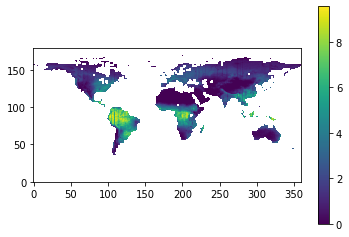

In [13]:
resp_file = '/home/awoude/notebooks/ForRitten/SiB4_TER_avg.nc'
with xr.open_dataset(resp_file) as ds:
    resp = ds
plt.imshow(resp.TER, origin='lower')
plt.colorbar()

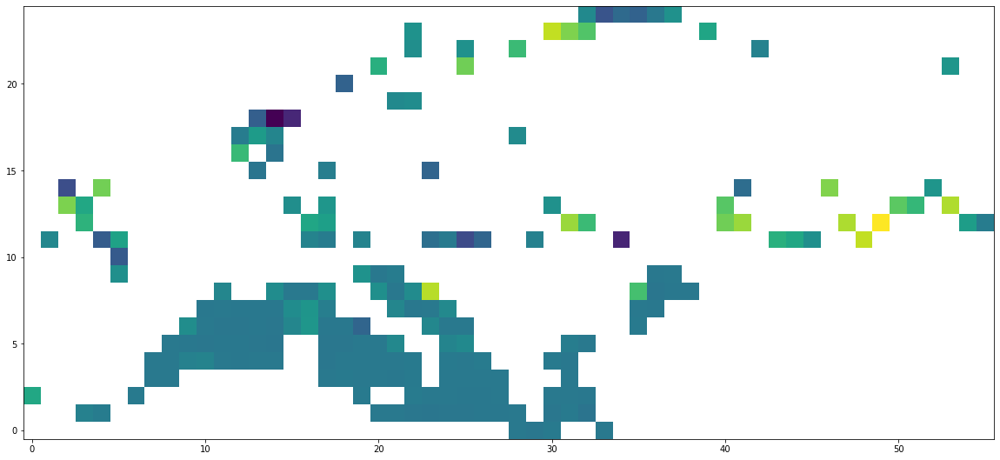

In [87]:
plt.figure(figsize=(20,10))
filter_sea = np.logical_and(flux_ds.regions >= 9450, flux_ds.regions <=9650)
plt.imshow(flux_ds.where(filter_sea, drop=True).opt_flux.isel(time=0), origin='lower')

In [20]:
keys = np.array(weekly_sv.index)
dates_2019_2020 = filter_date_by_year(keys, 2019, 2021)

lon = np.linspace(-179.5, 179.5, 360, endpoint=True)

lat = np.linspace(-89.5, 89.5, 180, endpoint=True)
opt_data = list(opt_ocean_bio.values())
prior_data = list(prior_fluxes.values())

opt_flux = xr.DataArray(
    name='opt_flux',
    data=opt_data,
    dims=["time", "lat", "lon"],
    coords=dict(
        lon=(["lon"], lon),
        lat=(["lat"], lat),
        time=list(opt_ocean_bio.keys()),
    ),
    attrs=dict(
        description="Optimised ocean and biosphere flux",
        units="molC/s",
    ),
)

prior_flux = xr.DataArray(
    name='prior_flux',
    data=prior_data,
    dims=["time", "lat", "lon"],
    coords=dict(
        lon=(["lon"], lon),
        lat=(["lat"], lat),
        time=list(opt_ocean_bio.keys()),
    ),
    attrs=dict(
        description="Prior ocean and biosphere flux",
        units="molC/s",
    ),
)
area_per_grid_cell = calc_area(opt_flux.lat,opt_flux.lon)
area_per_grid_cell
cell_area_ds = xr.DataArray(
    name='cell_area',
    data=area_per_grid_cell,
    dims=["lat", "lon"],
    coords=dict(
        lon=(["lon"], lon),
        lat=(["lat"], lat),
    ),
    attrs=dict(
        description="Surface area of indiviual grid cells",
        units="m^2",
    ),
)
resp_file = '/home/awoude/notebooks/ForRitten/SiB4_TER_avg.nc'
with xr.open_dataset(resp_file) as ds:
    ds = ds.swap_dims({"Longitude": "lon", "Latitude":"lat"})
    ds = ds.reset_coords(names=['Longitude' ,'Latitude'], drop=True)
    
    resp_ds = ds
    


state_vec_file = '/projects/0/ctdas/input/ctdas_2012/covariances/gridded_NH/griddedNHparameters.nc'
with xr.open_dataset(state_vec_file) as ds:
    state_vec_params = ds
    # fixing minor error in the naming of dimensions in the source file:
    ds = ds.swap_dims({"longitude": "lon2", "latitude":"lat2", "lon":"lon2", "lat":"lat2"})
    ds = ds.swap_dims({"lon2": "lon", "lat2":"lat"})
    ds = ds.reset_coords(names=['longitude' ,'latitude'], drop=True)
    
    state_elem_ds = ds

flux_ds = xr.merge([opt_flux, prior_flux, state_elem_ds, cell_area_ds, resp_ds])

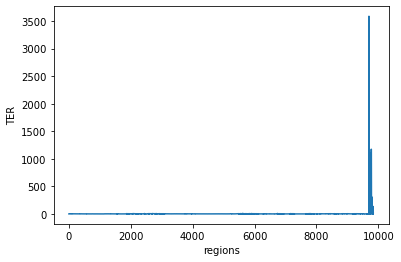

In [22]:
resp_per_sv_elem = flux_ds[['TER', 'regions']].groupby('regions').sum()
resp_per_sv_elem.TER.plot()
#.where('TER'==resp_per_sv_elem.TER.min()).plot.scatter()

In [23]:
region_index_max=resp_per_sv_elem.where(resp_per_sv_elem.TER == resp_per_sv_elem.TER.max(), drop=True).regions.values[0]

In [24]:
region_index_min=resp_per_sv_elem.where(resp_per_sv_elem.TER == resp_per_sv_elem.TER.min(), drop=True).regions.values[0]

True


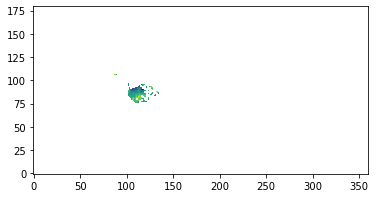

In [27]:
np.unique(flux_ds[['regions','prior_flux']].where('regions'==region_index_max).isel(time=1).prior_flux)
print(region_index_max in set(np.unique(flux_ds.regions)))

plt.imshow(flux_ds.where(flux_ds.regions==region_index_max).isel(time=0).prior_flux, origin='lower')

([<matplotlib.axis.YTick at 0x14885e465c70>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

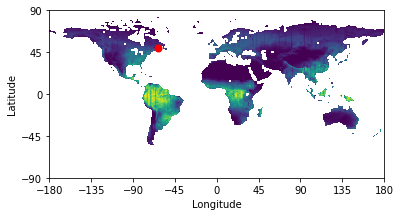

In [49]:
min_point = flux_ds[['regions','prior_flux']].where(flux_ds.regions==region_index_min, drop=True)

plt.scatter(min_point.lon, min_point.lat, color="red", linewidth=2)
plt.imshow(flux_ds.TER, extent=[-180, 180, -90, 90], origin='lower')
plt.xlabel('Longitude')
plt.xticks(np.arange(-180, 181, 45))
plt.ylabel('Latitude')
plt.yticks(np.arange(-90, 91, 45))


True


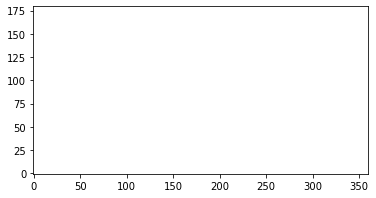

In [28]:
np.unique(flux_ds[['regions','prior_flux']].where('regions'==region_index_min).isel(time=1).prior_flux)
print(region_index_min in set(np.unique(flux_ds.regions)))

plt.imshow(flux_ds.where(flux_ds.regions==region_index_min).isel(time=0).prior_flux, origin='lower')

In [ ]:
    error_prior = pd.Series(dtype='float64')
    error_monthly = pd.Series(dtype='float64')
    error_smooth = pd.Series(dtype='float64')
    
    for region, mask in all_regiondict.items():
        masked_flux = total_prior_flux * mask
        scaled_masked_flux_monthly = masked_flux * sf_monthly[str(region)] 
        scaled_masked_flux_smooth = total_flux_smooth * mask
        masked_opt_flux = total_opt_flux * mask
        
        
        d_flux_montly = np.sum(np.subtract(scaled_masked_flux_monthly, masked_opt_flux))/np.sum(mask*area_per_grid_cell)
        d_flux_prior = np.sum(np.subtract(masked_flux, masked_opt_flux))/np.sum(mask*area_per_grid_cell)
        d_flux_smooth = np.sum(np.subtract(scaled_masked_flux_smooth, masked_opt_flux))/np.sum(mask*area_per_grid_cell)
    
        
        error_monthly[region] = d_flux_montly
        error_prior[region] = d_flux_prior
        error_smooth[region] = d_flux_smooth

In [22]:
print(flux_ds[['prior_flux','opt_flux']])
flux_ds.regions

<xarray.Dataset>
Dimensions:     (time: 1096, lat: 180, lon: 360)
Coordinates:
  * lon         (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lat         (lat) float64 -89.5 -88.5 -87.5 -86.5 ... 86.5 87.5 88.5 89.5
  * time        (time) datetime64[ns] 2000-01-01 2000-01-08 ... 2020-12-26
Data variables:
    prior_flux  (time, lat, lon) float32 0.0 0.0 0.0 ... -2.248e-09 -2.248e-09
    opt_flux    (time, lat, lon) float32 0.0 0.0 0.0 ... -2.615e-09 -2.615e-09
Attributes:
    description:  Optimised ocean and biosphere flux
    units:        molC/s


<xarray.DataArray 'regions' (lat: 180, lon: 360)>
array([[9835., 9835., 9835., ..., 9835., 9835., 9835.],
       [9835., 9835., 9835., ..., 9835., 9835., 9835.],
       [9835., 9835., 9835., ..., 9835., 9835., 9835.],
       ...,
       [9805., 9805., 9805., ..., 9805., 9805., 9805.],
       [9805., 9805., 9805., ..., 9805., 9805., 9805.],
       [9805., 9805., 9805., ..., 9805., 9805., 9805.]], dtype=float32)
Coordinates:
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
Attributes:
    comment:        All 9804 land regions on (360,180) dimensions
    long_name:      parameter_for_each_gridbox
    standard_name:  parameters
    units:          unitless

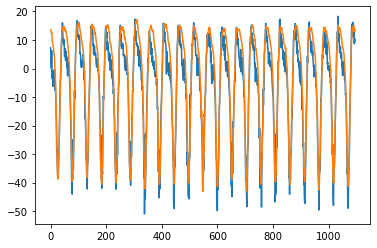

In [19]:
fac= 86400.*365.*12./1e15
flux_m2_ds = flux_ds[['prior_flux','opt_flux']]*flux_ds.cell_area*fac
#plt.plot(flux_m2_ds.sum(dim=['lon', 'lat']).prior_flux)
plt.plot(flux_m2_ds.sum(dim=['lon', 'lat']).opt_flux)
plt.plot(flux_per_region.sum(dim='regions').prior_flux)

In [ ]:
flux_per_region.loc[flux_per_region.where(prior_flux==flux_per_region.prior_flux.min())]

In [18]:
fac= 86400.*365.*12./1e15
flux_m2_ds = flux_ds[['prior_flux','opt_flux']]*flux_ds.cell_area*fac

print(flux_m2_ds.sum(dim=['lon', 'lat']))
flux_m2_ds.attrs['desciption'] = 'Fluxes muliplied with surface area to which they apply'
flux_m2_ds = xr.merge([flux_m2_ds, flux_ds.regions])
flux_per_region = flux_m2_ds.groupby('regions').sum()
# For each week, determine the sum(error^2)

max(weekly_sv.iloc[0]*flux_per_region.prior_flux.isel(time=0)-flux_per_region.opt_flux.isel(time=0))

<xarray.Dataset>
Dimensions:     (time: 1096)
Coordinates:
  * time        (time) datetime64[ns] 2000-01-01 2000-01-08 ... 2020-12-26
Data variables:
    prior_flux  (time) float64 13.64 13.4 13.26 12.49 ... 13.96 13.06 13.52
    opt_flux    (time) float64 7.272 5.639 1.922 0.02311 ... 8.678 10.48 9.404


3.5549971300063987e-09

In [16]:
keys = np.array(weekly_sv.index)

print(keys)
# Selecting the relevant dates from the list of all dates
dates_2019_2020 = filter_date_by_year(keys, 2019, 2021)

# Store the sum of error^2 over each grid cell
error_prior_sv_df = pd.DataFrame(columns=dates_2019_2020, index=weekly_sv.columns)
error_monthly_sv_df = pd.DataFrame(columns=dates_2019_2020, index=weekly_sv.columns)
error_smooth_sv_df = pd.DataFrame(columns=dates_2019_2020, index=weekly_sv.columns)

error_prior_flux_df = pd.DataFrame(columns=dates_2019_2020, index=weekly_sv.columns)
error_monthly_flux_df = pd.DataFrame(columns=dates_2019_2020, index=weekly_sv.columns)
error_smooth_flux_df = pd.DataFrame(columns=dates_2019_2020, index=weekly_sv.columns)

# conversion factor [molC/s] -> [PgC/yr]
fac= 86400.*365.*12./1e15
    
#weight_region = flux_ds['regions', 'cell_area'].groupby('regions').sum()
flux_m2_ds = flux_ds[['prior_flux','opt_flux']]*flux_ds.cell_area*fac

flux_m2_ds.attrs['desciption'] = 'Fluxes muliplied with surface area to which they apply'
flux_m2_ds = xr.merge([flux_m2_ds, flux_ds.regions])
flux_per_region = flux_m2_ds.groupby('regions').sum()
# For each week, determine the sum(error^2)
for date in dates_2019_2020[:]:
    print(f'Currently processing date: {date}')

    opt_sv = weekly_sv.loc[date]
    prior_sv = np.ones(np.shape(opt_sv))
    
    
    opt_flux = flux_per_region.opt_flux.sel(time=date)
    prior_flux = flux_per_region.prior_flux.sel(time=date)
    
    month = date.astype('datetime64[M]').astype(int) % 12 + 1        
    sv_monthly = grouped_train.loc[month]
    sv_smooth = smoothed_sv.loc[date]
    
    

    flux_monthly = prior_flux*sv_monthly
    flux_smooth = prior_flux*sv_smooth
    
    error_prior_sv = np.subtract(prior_sv, opt_sv)
    error_monthly_sv = np.subtract(sv_monthly, opt_sv)
    error_smooth_sv = np.subtract(sv_smooth, opt_sv) 
    
    error_monthly_sv_df[date] = error_monthly_sv
    error_prior_sv_df[date] = error_prior_sv
    error_smooth_sv_df[date] = error_smooth_sv
    
    error_prior_flux = np.subtract(prior_flux, opt_flux)
    error_monthly_flux = np.subtract(flux_monthly, opt_flux)
    error_smooth_flux = np.subtract(flux_smooth, opt_flux) 
    
    error_monthly_flux_df[date] = error_monthly_flux
    error_prior_flux_df[date] = error_prior_flux
    error_smooth_flux_df[date] = error_smooth_flux
    
    
# error_per_ecoregion_monthly = error_per_ecoregion_monthly.copy()
# error_per_ecoregion_prior = error_per_ecoregion_prior.copy()
# error_per_ecoregion_smooth = error_per_ecoregion_smooth.copy()

error_monthly_sv_df = error_monthly_sv_df.T
error_prior_sv_df = error_prior_sv_df.T
error_smooth_sv_df = error_smooth_sv_df.T

error_monthly_flux_df = error_monthly_flux_df.T
error_prior_flux_df = error_prior_flux_df.T
error_smooth_flux_df = error_smooth_flux_df.T


['2000-01-01T00:00:00.000000000' '2000-01-08T00:00:00.000000000'
 '2000-01-15T00:00:00.000000000' ... '2020-12-12T00:00:00.000000000'
 '2020-12-19T00:00:00.000000000' '2020-12-26T00:00:00.000000000']


NameError: name 'flux_ds' is not defined

In [15]:
opt_ocean_bio

NameError: name 'opt_ocean_bio' is not defined

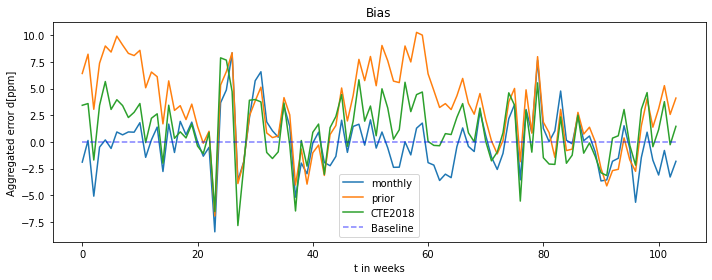

In [40]:

d1 = DescrStatsW(error_monthly_flux_df.T)
d2 = DescrStatsW(error_prior_flux_df.T)
d3 = DescrStatsW(error_smooth_flux_df.T)

fig, ax1 = plt.subplots(1,1, figsize=(10,4))

ax1.plot(d1.sum, label='monthly')
ax1.plot(d2.sum, label='prior')
ax1.plot(d3.sum, label='CTE2018')
ax1.plot(np.zeros(len(d1.mean)), color='b', alpha=0.5, linestyle='dashed', label='Baseline')

# square_err_per_week['bias_monthly_avg'].plot(label='x=model_(monthly)')
# square_err_per_week['bias_prior'].plot(label='x=model_(prior)')
ax1.set_title('Absolute error')
ax1.set_xlabel('t in weeks')
ax1.set_ylabel('error d[ppm]')
ax1.legend()
#ax1.tight_layout()
#d.std_mean
# print(error_per_ecoregion_monthly.T)
# print(list(weight_ecoregion.values()))

# ax2.plot(d1.std_mean, label='monthly')
# ax2.plot(d2.std_mean, label='prior')
# ax2.plot(d3.std_mean, label='CTE2018')

# ax2.set_title(r'$\sigma=1}$')
# ax2.set_xlabel('t in weeks')
# ax2.set_ylabel('Standard devation of error d[ppm]')
# ax2.legend()
plt.tight_layout()
plt.savefig('../figures/bias_weighted_per_week.pdf')
plt.show()

In [7]:
#print(df)
#df.to_pickle(path + 'avg_flux_per_ecoregion_PFT.pkl')
!ls -a /projects/0/ctdas/awoude/Ritten


.				predictor_vars	smoothed_a_piori_flux.pkl
..				raw_dat		transport
avg_flux_per_ecoregion_PFT.pkl	sf.nc		transport_results
flux_data			sf_per_eco.nc	weekly_sv.nc


<AxesSubplot:>

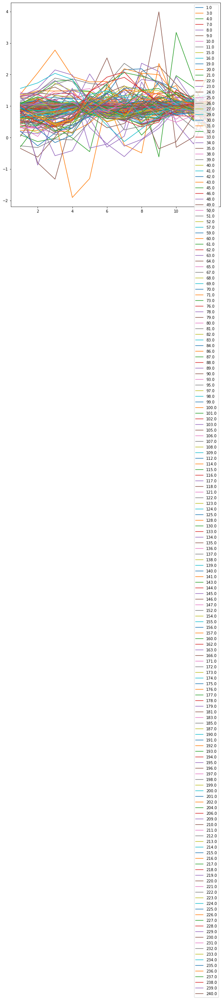

In [207]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
df.groupby(df.index.month).mean().plot(ax=ax)

In [19]:
# Filter:
df[df < 0] = np.nan
df[df > 10] = np.nan

In [20]:
df = df.dropna(axis=1, how='all')

/scratch-local/awoude/ipykernel_2109768/98215501.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


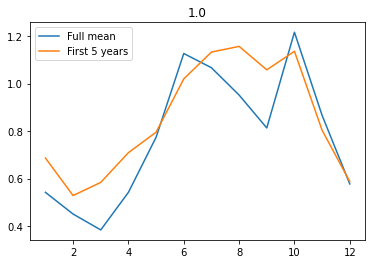

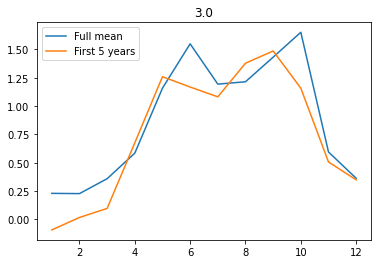

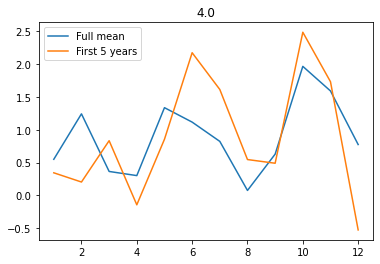

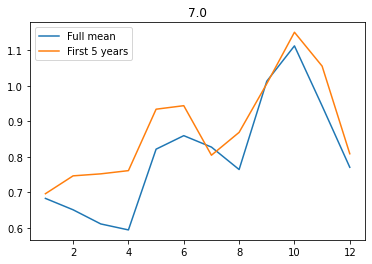

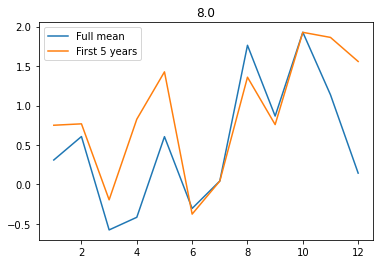

...

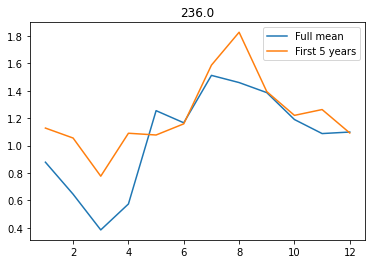

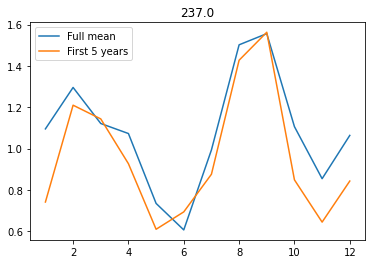

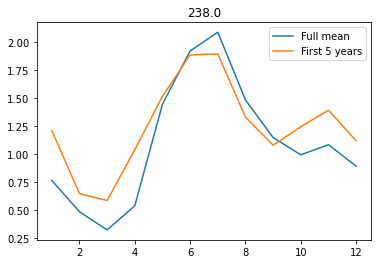

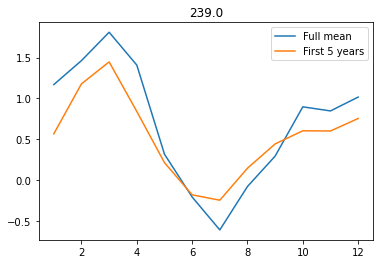

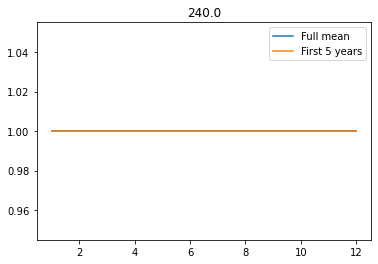

In [9]:
df = sf_per_ecoregion
for k in df.columns:
    plt.figure()
    plt.title(k)
    df[k].groupby(df.index.month).mean().plot(label='Full mean')
    short_df = df[df.index.year < 2005]
    short_df[k].groupby(short_df.index.month).mean().plot(label='First 5 years')
    #plt.errorbar(y=df[k].groupby(df.index.month).std())
    plt.legend()

# starting with setting-up the baseline

In [10]:
df = sf_per_ecoregion

train_set = df[df.index.year <= 2018]
test_set_2019 = df[df.index.year == 2019]
test_set_2020 = df[df.index.year == 2020]
test_set_19_20 = df[df.index.year >= 2019]

grouped_train = train_set.groupby(train_set.index.month).mean()
grouped_2019 = test_set_2019.groupby(test_set_2019.index.month).mean()
grouped_2020 = test_set_2020.groupby(test_set_2020.index.month).mean()

base = pd.DataFrame(np.ones(shape=np.shape(grouped_train)), columns=df.columns, index=grouped_train.index)

print(mean_squared_error(grouped_2019, grouped_train, squared=False))
print(mean_squared_error(grouped_2019, base, squared=False))


print(mean_squared_error(grouped_2020, grouped_train, squared=False))
print(mean_squared_error(grouped_2020, base, squared=False))


0.5550614
0.5874521287744293
0.557053
0.603083349528936


In [16]:
def get_combined_fluxes(f):
    with nc.Dataset(f) as ds:
        # Define which fluxes should be included into the combined set of fluxes
        combined = np.add(ds['flux_bio_prior_mean'][:], ds['flux_ocean_prior_mean'][:])
    return combined

In [17]:
def filter_date_by_year(arr, start, end=2021):
    start_date = pd.to_datetime(str(start)+'0101')
    end_date = pd.to_datetime(str(end)+'0101')
    filtered_arr = arr[np.where((arr >= start_date) & (arr < end_date))]
    return filtered_arr

In [107]:
opt_ocean_bio = {}
for i, f in enumerate(files):
    if i%100==0:
        print(f"Currently processing file #{i}")
    with nc.Dataset(f) as ds:
        date = extract_date(f)
        combined_ocean_bio = np.add(ds['flux_bio_prior_mean'][:], ds['flux_ocean_prior_mean'][:])
        opt_ocean_bio[date] = combined_ocean_bio * ds['flux_multiplier_m']

Currently processing file #0
Currently processing file #100
Currently processing file #200
Currently processing file #300
Currently processing file #400
Currently processing file #500
Currently processing file #600
Currently processing file #700
Currently processing file #800
Currently processing file #900
Currently processing file #1000


In [103]:
with xr.open_dataset(files[0]) as ds:
    print(ds.flux_all_prior_mean)

<xarray.DataArray 'flux_all_prior_mean' (lat: 180, lon: 360)>
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)
Coordinates:
  * lon      (lon) float32 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lat      (lat) float32 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
Attributes:
    units:             mol m-2 s-1
    flux_all_prior_n:  0


In [142]:
with xr.open_dataset('/gpfs/work1/0/ctdas/awoude/Ritten/predictor_vars/36-params_2000-2020.nc') as ds:
    print(ds)

<xarray.Dataset>
Dimensions:    (time: 1096, lat: 180, lon: 360)
Coordinates:
  * time       (time) datetime64[ns] 2000-01-01 2000-01-08 ... 2020-12-26
  * lon        (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lat        (lat) float64 -89.5 -88.5 -87.5 -86.5 ... 86.5 87.5 88.5 89.5
Data variables: (12/36)
    g10m_MAX   (time, lat, lon) float32 ...
    swvl1_MIN  (time, lat, lon) float32 ...
    swvl1_MAX  (time, lat, lon) float32 ...
    slhf_MIN   (time, lat, lon) float32 ...
    slhf_MAX   (time, lat, lon) float32 ...
    slhf_AVG   (time, lat, lon) float32 ...
    ...         ...
    cp_MAX     (time, lat, lon) float32 ...
    cp_SUM     (time, lat, lon) float32 ...
    sd_MIN     (time, lat, lon) float32 ...
    sd_MAX     (time, lat, lon) float32 ...
    sf_AVG     (time, lat, lon) float32 ...
    sf_MAX     (time, lat, lon) float32 ...


In [ ]:
prior_fluxes = {}

# Loading of the prior flux landscape
with xr.open_dataset(flux_files[0]) as ds:
    date = extract_date(flux_files[0])
    combined_flux = ds.flux_bio_prior_mean + ds.flux_ocean_prior_mean
    combined_flux = combined_flux.assign_coords(time=date)
    prior_fluxes[date] = combined_flux
    prior_flux_ds = combined_flux

for i, f in enumerate(flux_files[1:],1):
    if i%100==0:
        print(f"Currently loading flux file #{i}")
    date = extract_date(f)
    with xr.open_dataset(f) as ds:
        combined_flux = ds.flux_bio_prior_mean + ds.flux_ocean_prior_mean
    combined_flux = combined_flux.assign_coords(time=date)
    prior_fluxes[date] = combined_flux
    prior_flux_ds = xr.concat([prior_flux_ds, combined_flux], dim='time')

# Loading the distribution of the ecoregions and area assoiated with each cell
with xr.open_dataset(regionsfile) as ds:
    ecoregion_da = ds[['regions','grid_cell_area']]

In [178]:
regionsfile = '/gpfs/home5/awoude/Ritten/EKF/regions.nc' # Contains the data on the distribution of ecoregions

state_vec_file = '/projects/0/ctdas/input/ctdas_2012/covariances/gridded_NH/griddedNHparameters.nc'

monthly_sv_file = path + 'monthly_sv.nc'
smoothed_sv_file = path + 'smoothed_sv.nc'

with xr.open_dataset(monthly_sv_file) as ds:
    monthly_sv = ds
    
with xr.open_dataset(smoothed_sv_file) as ds:
    smoothed_sv = ds

with xr.open_dataset(state_vec_file) as ds:
    state_vec_params = ds
    # fixing minor error in the naming of dimensions in the source file:
    ds = ds.swap_dims({"longitude": "lon2", "latitude":"lat2", "lon":"lon2", "lat":"lat2"})
    ds = ds.swap_dims({"lon2": "lon", "lat2":"lat"})
    ds = ds.reset_coords(names=['longitude' ,'latitude'], drop=True)
    
    state_vec_ds = ds

# Loading of the prior flux landscape
with xr.open_dataset(files[0]) as ds:
    date = extract_date(files[0])
    combined_flux = ds.flux_bio_prior_mean + ds.flux_ocean_prior_mean
    combined_flux = combined_flux.assign_coords(time=date)
    prior_flux_ds = combined_flux

for i, f in enumerate(files[1:],1):
    if i%100==0:
        print(f"Currently loading flux file #{i}")
    date = extract_date(f)
    with xr.open_dataset(f) as ds:
        combined_flux = ds.flux_bio_prior_mean + ds.flux_ocean_prior_mean
    combined_flux = combined_flux.assign_coords(time=date)
    prior_flux_ds = xr.concat([prior_flux_ds, combined_flux], dim='time')
    
# Loading the distribution of the ecoregions and area assoiated with each cell
with xr.open_dataset(regionsfile) as ds:
    #region_da = ds.assign_coords(sv_regions = np.unique(state_vec_ds.regions.values.astype(int)))
    #region_da = region_da.rename({'sv_regions':'regions'})
    ecoregion_da = xr.merge([state_vec_ds.regions, ds.grid_cell_area])
    print(state_vec_ds.regions)
    print(ds.regions.rename('eco_region'))
    other_ds = xr.merge([state_vec_ds.regions, ds.regions.rename('eco_region')])
    
    grouped_area = ecoregion_da.groupby('regions').sum()
    grouped_eco = other_ds.groupby('regions').max()

Currently loading flux file #100
Currently loading flux file #200
Currently loading flux file #300
Currently loading flux file #400
Currently loading flux file #500
Currently loading flux file #600
Currently loading flux file #700
Currently loading flux file #800
Currently loading flux file #900
Currently loading flux file #1000


/home/awoude/.conda/envs/Ritten_3.9.10/lib/python3.9/site-packages/xarray/conventions.py:516: SerializationWarning: variable 'ecosystem_names' has multiple fill values {'-', b'-'}, decoding all values to NaN.
  new_vars[k] = decode_cf_variable(
/home/awoude/.conda/envs/Ritten_3.9.10/lib/python3.9/site-packages/xarray/conventions.py:516: SerializationWarning: variable 'transcom_names' has multiple fill values {'-', b'-'}, decoding all values to NaN.
  new_vars[k] = decode_cf_variable(


<xarray.DataArray 'regions' (lat: 180, lon: 360)>
array([[9835., 9835., 9835., ..., 9835., 9835., 9835.],
       [9835., 9835., 9835., ..., 9835., 9835., 9835.],
       [9835., 9835., 9835., ..., 9835., 9835., 9835.],
       ...,
       [9805., 9805., 9805., ..., 9805., 9805., 9805.],
       [9805., 9805., 9805., ..., 9805., 9805., 9805.],
       [9805., 9805., 9805., ..., 9805., 9805., 9805.]], dtype=float32)
Coordinates:
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
Attributes:
    comment:        All 9804 land regions on (360,180) dimensions
    long_name:      parameter_for_each_gridbox
    standard_name:  parameters
    units:          unitless
<xarray.DataArray 'eco_region' (lat: 180, lon: 360)>
array([[240., 240., 240., ..., 240., 240., 240.],
       [240., 240., 240., ..., 240., 240., 240.],
       [240., 240., 240., ..., 240., 240., 240.],
       ...,
       [210., 2

In [179]:
comb_ds = xr.merge([grouped_area, grouped_eco, monthly_sv, smoothed_sv])

In [186]:
sv_grouped

<xarray.Dataset>
Dimensions:      (eco_region: 176, time: 1096)
Coordinates:
  * eco_region   (eco_region) float64 1.0 3.0 4.0 7.0 ... 238.0 239.0 240.0
  * time         (time) datetime64[ns] 2000-01-01 2000-01-08 ... 2020-12-26
Data variables:
    monthly_sv   (eco_region, time) float64 1.0 0.427 0.5509 ... 1.0 1.0 1.0
    smoothed_sv  (eco_region, time) float64 1.0 0.809 0.7006 ... 1.0 1.0 1.0

In [185]:
eco_area = comb_ds[['grid_cell_area','eco_region']].groupby('eco_region').sum()
sv_grouped = comb_ds[['eco_region','monthly_sv','smoothed_sv']].groupby('eco_region').mean()

In [25]:
# experiment calculating R^2

print(np.corrcoef(grouped_2019, grouped_train)[0, 1]**2)
print(np.corrcoef(grouped_2019, base)[0, 1]**2)

6.439763795599943e-06
6.439763795599943e-06


/scratch-local/awoude/ipykernel_2463666/4045311609.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


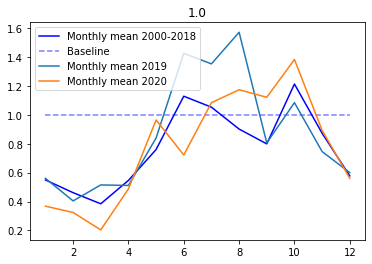

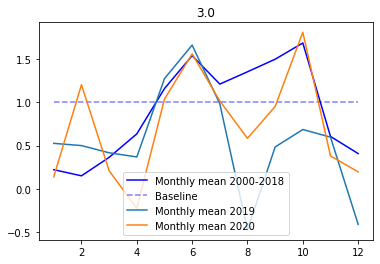

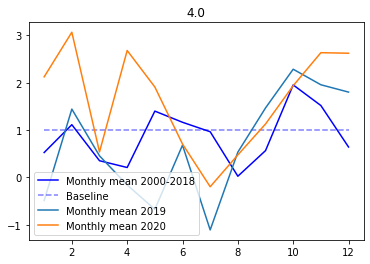

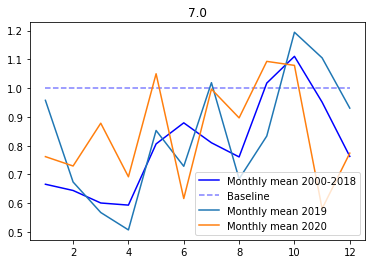

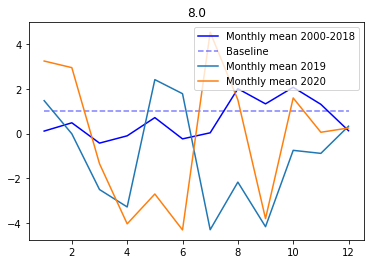

...

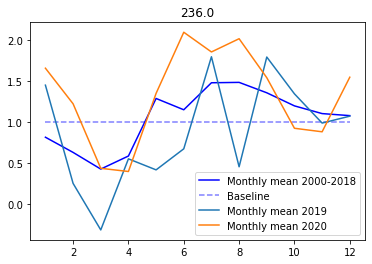

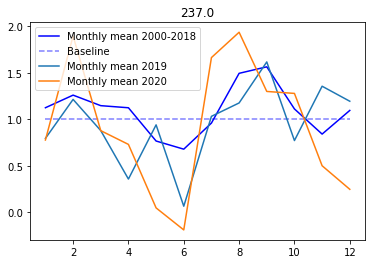

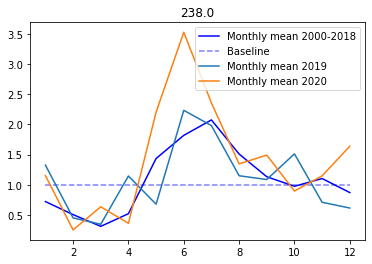

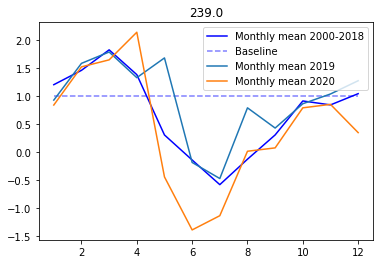

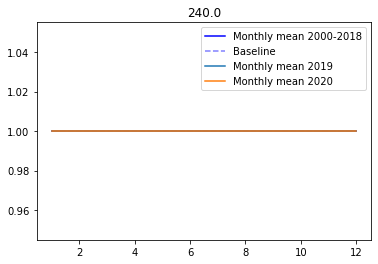

In [16]:
for k in df.columns:
    plt.figure()
    plt.title(k)
    grouped_train[k].plot(color='b', label='Monthly mean 2000-2018')
    base[k].plot(color='b', alpha=0.5, linestyle='dashed', label='Baseline')
    grouped_2019[k].plot(label='Monthly mean 2019')
    grouped_2020[k].plot(label='Monthly mean 2020')
    #plt.errorbar(y=df[k].groupby(df.index.month).std())
    plt.legend() 

In [28]:
test_set_19_20 = df[df.index.year >= 2019]
grouped_19_20 = test_set_19_20.groupby(test_set_19_20.index.month).mean()

In [16]:
np.unique(df.index.month)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])

In [13]:
def translate_to_PFT(ecoregion):
    ecoregion = int(float(ecoregion))
    PFT_order = {
        1: 'Conifer Forest',
        2: 'Broadleaf Forest',
        3: 'Mixed Forest',
        4: 'Grass/Shrub',
        5: 'Tropical Forest',
        6: 'Scrub/Woods',
        7: 'Semitundra',
        8: 'Fields/Woods/Savanna',
        9: 'Northern Taiga',
        10: 'Forest/Field',
        11: 'Wetland',
        12: 'Deserts',
        13: 'Shrub/Tree/Suc',
        14: 'Crops',
        15: 'Conifer Snowy/Coastal',
        16: 'Wooded tundra',
        17: 'Mangrove',
        18: 'Ice and Polar desert',
        19: 'Water'
    }
    for tcr, ecoregions in ecoregions_per_transcomregion.items():
        if ecoregion in ecoregions:
            transCom = tcr
    if ecoregion > 11*19:
        return transCom
    else:
        PFT = PFT_order[(ecoregion-1)%19+1]
        return transCom + ' - ' + PFT

In [57]:
for date, flux in prior_fluxes:
    with nc.Dataset(regionsfile) as ds:
        regions = np.unique(ds['regions'][:])
print(all_region_matrix[3])    

    

# flux_per_ecoregion = 

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [51]:
with nc.Dataset(regionsfile) as ds:
    regions = np.unique(ds['regions'][:])
    for i in regions:

        print(f'Region number {i} corresponds to ecoregion {translate_to_PFT(i)}\n')

1.0
Region number 1.0 corresponds to ecoregion North American Boreal - Conifer Forest
3.0
Region number 3.0 corresponds to ecoregion North American Boreal - Mixed Forest
4.0
Region number 4.0 corresponds to ecoregion North American Boreal - Grass/Shrub
7.0
Region number 7.0 corresponds to ecoregion North American Boreal - Semitundra
8.0
Region number 8.0 corresponds to ecoregion North American Boreal - Fields/Woods/Savanna
9.0
Region number 9.0 corresponds to ecoregion North American Boreal - Northern Taiga
10.0
Region number 10.0 corresponds to ecoregion North American Boreal - Forest/Field
11.0
Region number 11.0 corresponds to ecoregion North American Boreal - Wetland
15.0
Region number 15.0 corresponds to ecoregion North American Boreal - Conifer Snowy/Coastal
16.0
Region number 16.0 corresponds to ecoregion North American Boreal - Wooded tundra
19.0
Region number 19.0 corresponds to ecoregion North American Boreal - Water
20.0
Region number 20.0 corresponds to ecoregion North Amer

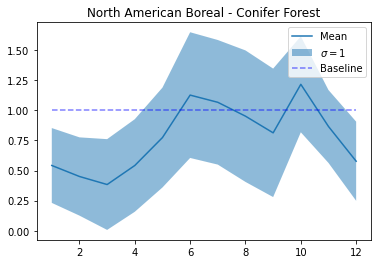

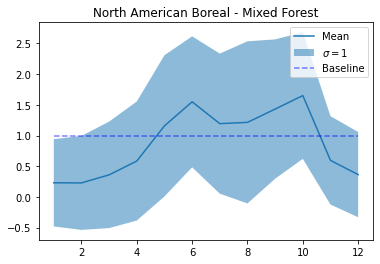

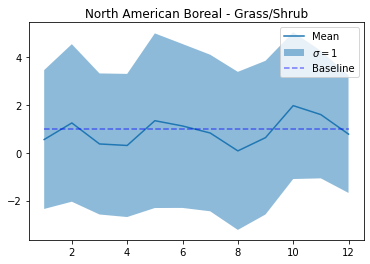

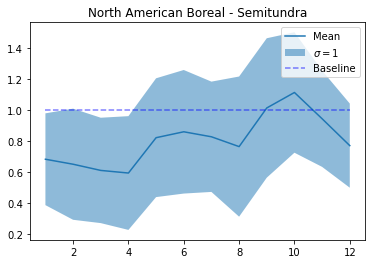

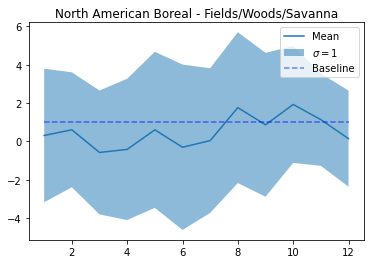

...

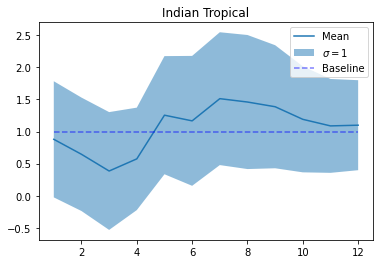

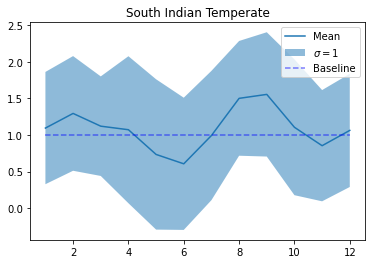

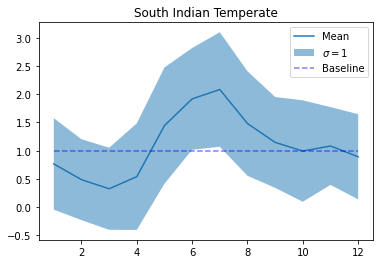

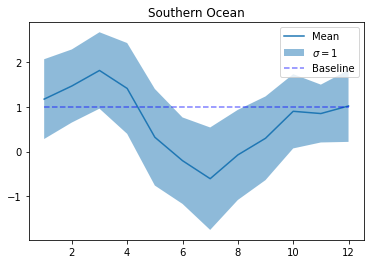

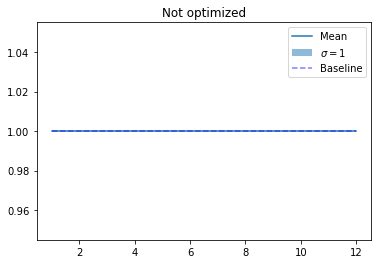

In [43]:
df = sf_per_ecoregion

grouped = df.groupby(df.index.month)

for k in df.columns:
    plt.figure()
    plt.title(translate_to_PFT(k))
    
    mean = grouped.mean()[k]
    # error = grouped.sem()[k]
    error = grouped.std()[k]
    
    mean.plot(label='Mean')
    plt.fill_between(np.unique(df.index.month), mean-error, mean+error, 
                     alpha=0.5, label=r'$\sigma=1$')
    
    #plt.errorbar(x=np.unique(df.index.month), y=mean, yerr=error)
    base[k].plot(color='b', alpha=0.5, linestyle='dashed', label='Baseline')
    #df.groupby(df.index.month).std()[k]
    #grouped_19_20[k].plot(label='Monthly mean 2019-2020')
    #plt.errorbar(y=df[k].groupby(df.index.month).std())
    plt.legend() 
    plt.show()

In [41]:
for i in range(12):
    print(np.array(grouped['1.0'])[i])

[1 2000-01-01    0.427001
   2000-01-08    0.674758
   2000-01-15    0.772886
   2000-01-22    0.819543
   2000-01-29    0.639498
                   ...
   2019-01-26    0.282173
   2020-01-04    0.387162
   2020-01-11    0.528628
   2020-01-18    0.047188
   2020-01-25    0.508755
   Name: 1.0, Length: 92, dtype: float32]
[2 2000-02-05    0.672378
   2000-02-12    0.590141
   2000-02-19    0.562182
   2000-02-26    0.650555
   2001-02-03    0.382774
                   ...
   2020-02-01    0.046271
   2020-02-08    0.565886
   2020-02-15    0.199496
   2020-02-22    0.263417
   2020-02-29    0.546080
   Name: 1.0, Length: 85, dtype: float32]
[3 2000-03-04    0.113315
   2000-03-11    0.512201
   2000-03-18    0.559198
   2000-03-25    0.805448
   2001-03-03    0.248685
                   ...
   2019-03-30    0.717189
   2020-03-07   -0.055394
   2020-03-14    0.341717
   2020-03-21    0.060763
   2020-03-28    0.467179
   Name: 1.0, Length: 94, dtype: float32]
[4 2000-04-01    0.896801

/scratch-local/awoude/ipykernel_1346984/3579828504.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  print(np.array(grouped['1.0'])[i])
/scratch-local/awoude/ipykernel_1346984/3579828504.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  print(np.array(grouped['1.0'])[i])
/scratch-local/awoude/ipykernel_1346984/3579828504.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify

1     92
2     85
3     94
4     90
5     92
6     91
7     92
8     93
9     91
10    92
11    90
12    94
Name: 147.0, dtype: int64


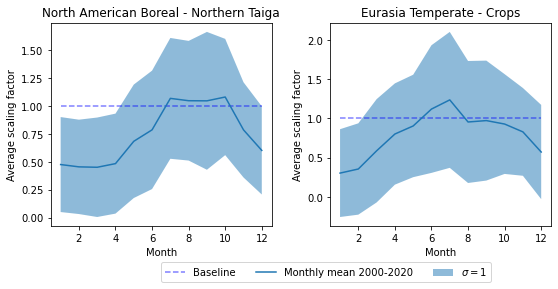

In [25]:
df = sf_per_ecoregion

grouped = df.groupby(df.index.month)

mean_1, mean_2 = [grouped.mean()[i] for i in ['9.0', '147.0']]

error_1, error_2 = [grouped.std()[i] for i in ['9.0', '147.0']]

count_1, count_2 = [grouped.count()[i] for i in ['9.0', '147.0']]

print(count_2)
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(8,4))
# fig.suptitle('Mean scaling factor over aggregated grid cells.', fontsize=20)
ax1.set_title('North American Boreal - Northern Taiga')

    
ax1.plot(base['115.0'], color='b', alpha=0.5, linestyle='dashed', label='Baseline')
ax1.plot(mean_1, label='Monthly mean 2000-2020')
ax1.fill_between(np.unique(df.index.month), mean_1-error_1, mean_1+error_1, 
                 alpha=0.5, label=''r'$\sigma=1$')
ax1.set(xlabel='Month', ylabel='Average scaling factor')
ax1.label_outer()

ax2.set_title('Eurasia Temperate - Crops')
ax2.plot(base['115.0'], color='b', alpha=0.5, linestyle='dashed', label='Baseline')
ax2.plot(mean_2, label='Monthly mean 2000-2020')
ax2.fill_between(np.unique(df.index.month), mean_2-error_2, mean_2+error_2, 
                 alpha=0.5, label=''r'$\sigma=1$')
ax2.set(xlabel='Month', ylabel='Average scaling factor')
# ax2.label_outer()
# ax2.label_outer()

fig.tight_layout()
plt.legend(bbox_to_anchor =(0.75, -0.15), ncol=3)
plt.gcf().subplots_adjust(bottom=0.20)
# plt.savefig('../figures/Trends_aggregated_scaling_factors.pdf')

# Starting the pipeline for multiplication of fluxes with their respective land area

In [14]:
def calc_area(lats, lons):
    ''' Calculates the surface area [m2]of a grid spanned by lon and lat.
    Assumes lon,lat are evenly spaced (in degrees) vectors.
    Assumes lon,lat indicate center points
    Assumes the globe is a perfect sphere.
    Written by M Molen'''
    R            = 6370e3 # [m] the radius of the earth and h is the perpendicular distance from the plane containing the line of latitude to the pole.
    # grid spacing (degrees)
    dlon         = np.gradient(lons).mean()
    dlat         = np.gradient(lats).mean()
    # initialize A (surface area of grid point)
    nlon         = len(lons)
    nlat         = len(lats)
    A            = np.zeros((nlat, nlon))
    for iy in range(nlat):
        Alat     = 2*np.pi*np.square(R) * np.abs( np.sin(2*np.pi*(lats[iy]-dlat/2.)/360.) -np.sin(2*np.pi*(lats[iy]+dlat/2.)/360.)) * np.abs(dlon)/360. # m2
        A[iy, :] = Alat
    return A # m2

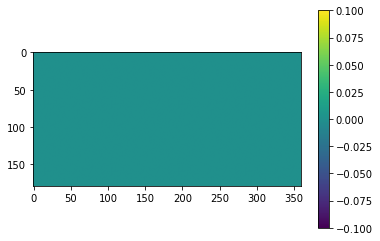

In [6]:
plt.imshow(calc_area(np.ones(180),np.ones(360)))
plt.colorbar()

[-89.5 -88.5 -87.5 -86.5 -85.5 -84.5 -83.5 -82.5 -81.5 -80.5 -79.5 -78.5
 -77.5 -76.5 -75.5 -74.5 -73.5 -72.5 -71.5 -70.5 -69.5 -68.5 -67.5 -66.5
 -65.5 -64.5 -63.5 -62.5 -61.5 -60.5 -59.5 -58.5 -57.5 -56.5 -55.5 -54.5
 -53.5 -52.5 -51.5 -50.5 -49.5 -48.5 -47.5 -46.5 -45.5 -44.5 -43.5 -42.5
 -41.5 -40.5 -39.5 -38.5 -37.5 -36.5 -35.5 -34.5 -33.5 -32.5 -31.5 -30.5
 -29.5 -28.5 -27.5 -26.5 -25.5 -24.5 -23.5 -22.5 -21.5 -20.5 -19.5 -18.5
 -17.5 -16.5 -15.5 -14.5 -13.5 -12.5 -11.5 -10.5  -9.5  -8.5  -7.5  -6.5
  -5.5  -4.5  -3.5  -2.5  -1.5  -0.5   0.5   1.5   2.5   3.5   4.5   5.5
   6.5   7.5   8.5   9.5  10.5  11.5  12.5  13.5  14.5  15.5  16.5  17.5
  18.5  19.5  20.5  21.5  22.5  23.5  24.5  25.5  26.5  27.5  28.5  29.5
  30.5  31.5  32.5  33.5  34.5  35.5  36.5  37.5  38.5  39.5  40.5  41.5
  42.5  43.5  44.5  45.5  46.5  47.5  48.5  49.5  50.5  51.5  52.5  53.5
  54.5  55.5  56.5  57.5  58.5  59.5  60.5  61.5  62.5  63.5  64.5  65.5
  66.5  67.5  68.5  69.5  70.5  71.5  72.5  73.5  7

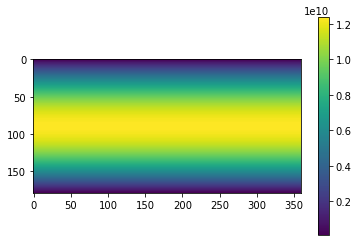

In [10]:

with nc.Dataset(files[1]) as ds:
    print(ds['lat'][:])
    area_per_grid_cell = calc_area(ds['lat'][:],ds['lon'][:])
    plt.imshow(area_per_grid_cell)
    plt.colorbar()

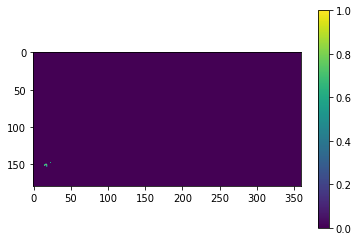

In [30]:
plt.imshow(all_regiondict[4.0])
plt.colorbar()

In [42]:
with nc.Dataset(files[2]) as ds:
    print(ds)

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    model_start_date: 2000/01/15 00:00:00 UTC
    model_end_date: 2000/01/22 00:00:00 UTC
    dimensions(sizes): lon(360), lat(180)
    variables(dimensions): float32 lon(lon), float32 lat(lat), float32 flux_multiplier_m(lat, lon), float32 flux_all_prior_mean(lat, lon), float32 flux_ff_prior_mean(lat, lon), float32 flux_bio_prior_mean(lat, lon), float32 flux_fires_prior_mean(lat, lon), float32 flux_ocean_prior_mean(lat, lon)
    groups: 


[[ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ...  0.0000000e+00
   0.0000000e+00  0.0000000e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ...  0.0000000e+00
   0.0000000e+00  0.0000000e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ...  0.0000000e+00
   0.0000000e+00  0.0000000e+00]
 ...
 [-7.7279934e-09 -7.7279934e-09 -7.5791737e-09 ... -7.7816189e-09
  -7.6850419e-09 -7.6850419e-09]
 [-3.1206446e-09 -3.1206446e-09 -3.1817884e-09 ... -2.9290519e-09
  -2.9117952e-09 -2.9117952e-09]
 [-3.0950567e-09 -3.0950567e-09 -3.1573666e-09 ... -2.9021021e-09
  -2.8852860e-09 -2.8852860e-09]]


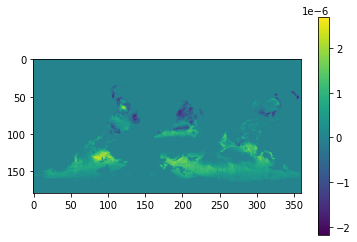

In [51]:
with nc.Dataset(files[2]) as ds:
    print(ds['flux_ocean_prior_mean'][:])
    plt.imshow(ds['flux_bio_prior_mean'][:])
    plt.colorbar()

In [15]:
keys = np.array(list(prior_fluxes.keys()))

# Selecting the relevant dates from the list of all dates
dates_2019_2020 = filter_date_by_year(keys, 2019, 2021)

# Calculate the area of the grid cells 
with nc.Dataset(files[1]) as ds:
    area_per_grid_cell = calc_area(ds['lat'][:],ds['lon'][:])

# Store the sum of error^2 over each grid cell
error_per_ecoregion_prior = pd.DataFrame()
error_per_ecoregion_monthly = pd.DataFrame()
error_per_ecoregion_smooth = pd.DataFrame()

# Store the sum of error^2 measured per ecoregion

# Set to true if the images below should be used for making a .gif
# create_gif_flag = True
# fig_dir = '../figures/aggr_ecoregions_gif/'

# conversion factor [molC/s] -> [PgC/yr]
fac= 86400.*365.*12./1e15

# For each week, determine the sum(error^2)
for date in dates_2019_2020:
    print(f'Currently processing date: {date}')
    opt_flux = opt_ocean_bio[date]
    total_opt_flux = opt_flux * area_per_grid_cell * fac
                                   
    prior_flux = prior_fluxes[date]
    total_prior_flux = prior_flux * area_per_grid_cell * fac
                                   
    sf_monthly = grouped_train.loc[date.month]
    sf_smooth = smoothed_sf[date]
    total_flux_smooth = total_prior_flux * sf_smooth
    #total_flux_estimate_monthly = np.zeros((180,360))
    
    # d_ecoregion_flux = 0
#     d_ecoregion_flux_montly = np.zeros((180,360))
#     d_ecoregion_flux_prior = np.zeros((180,360))
    
    error_prior = pd.Series(dtype='float64')
    error_monthly = pd.Series(dtype='float64')
    error_smooth = pd.Series(dtype='float64')
    
    for region, mask in all_regiondict.items():
        masked_flux = total_prior_flux * mask
        scaled_masked_flux_monthly = masked_flux * sf_monthly[str(region)] 
        scaled_masked_flux_smooth = total_flux_smooth * mask
        masked_opt_flux = total_opt_flux * mask
        
        
        d_flux_montly = np.sum(np.subtract(scaled_masked_flux_monthly, masked_opt_flux))/np.sum(mask*area_per_grid_cell)
        d_flux_prior = np.sum(np.subtract(masked_flux, masked_opt_flux))/np.sum(mask*area_per_grid_cell)
        d_flux_smooth = np.sum(np.subtract(scaled_masked_flux_smooth, masked_opt_flux))/np.sum(mask*area_per_grid_cell)
    
        
        error_monthly[region] = d_flux_montly
        error_prior[region] = d_flux_prior
        error_smooth[region] = d_flux_smooth
        
    
    
    
    error_per_ecoregion_monthly[date] = error_monthly
    error_per_ecoregion_prior[date] = error_prior
    error_per_ecoregion_smooth[date] = error_smooth
    
error_per_ecoregion_monthly = error_per_ecoregion_monthly.copy()
error_per_ecoregion_prior = error_per_ecoregion_prior.copy()
error_per_ecoregion_smooth = error_per_ecoregion_smooth.copy()

error_per_ecoregion_monthly = error_per_ecoregion_monthly.T
error_per_ecoregion_prior = error_per_ecoregion_prior.T
error_per_ecoregion_smooth = error_per_ecoregion_smooth.T

print(error_per_ecoregion_monthly)

NameError: name 'prior_fluxes' is not defined

In [74]:


print(len(list(weight_ecoregion.values())))
print(error_per_ecoregion_monthly.shape)
print(error_per_ecoregion_monthly * weight_ecoregion)

176
(104, 176)
               1.0       3.0       4.0       7.0       8.0       9.0    \
2019-01-05  0.034494 -0.092129  0.032981 -0.060703 -0.002535  0.088703   
2019-01-12 -0.173777 -0.009974  0.004979 -0.066142 -0.004287 -0.138249   
2019-01-19 -0.114295 -0.081291 -0.014146 -0.059143 -0.037278 -0.136841   
2019-01-26  0.182684 -0.082216  0.019142 -0.129067 -0.002566 -0.119175   
2019-02-02  0.108963 -0.081143  0.009927  0.123276 -0.010741  0.098757   
...              ...       ...       ...       ...       ...       ...   
2020-11-28 -0.173874  0.129111 -0.025981  0.141216 -0.014619 -0.086890   
2020-12-05 -0.013962  0.062345 -0.034552  0.052667  0.024309 -0.204590   
2020-12-12 -0.173254 -0.068110 -0.026554  0.058692  0.008684 -0.042473   
2020-12-19  0.043124  0.107491 -0.009847  0.076958 -0.030450 -0.009370   
2020-12-26  0.215903  0.055328 -0.019389 -0.054498 -0.004147 -0.136015   

               10.0      11.0      15.0      16.0   ...     231.0     232.0  \
2019-01-05  0.006

NameError: name 'weight_ecoregion' is not defined

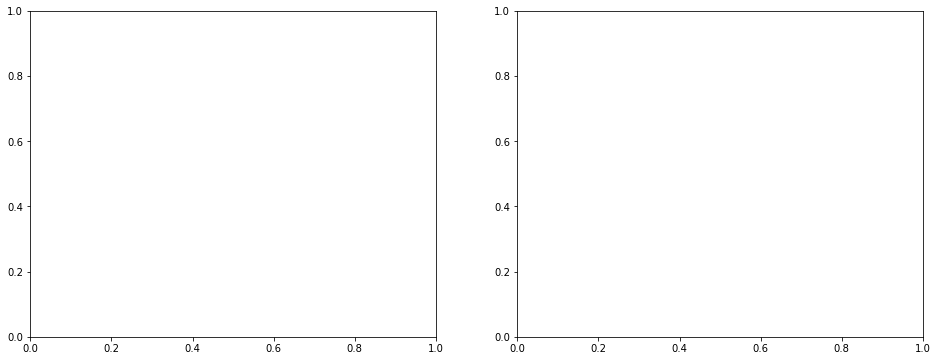

In [50]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(16,6))
ax1.plot(np.mean(error_per_ecoregion_monthly * weight_ecoregion), label='monthly')
ax1.plot(np.mean(error_per_ecoregion_prior * weight_ecoregion), label='prior')
ax1.plot(np.mean(error_per_ecoregion_smooth * weight_ecoregion), label='CTE2018')
# plt.show()

ax1.vlines(np.arange(0, 220, 19), -5.0e-1, 4.0e-1, label='transcom region', color='black', alpha=0.5)
ax1.set_ylabel('Mean error d[PgC/yr]')
ax1.set_xlabel('ecoregion')
ax1.set_title(r'$\bfBias$')
ax1.legend()



ax2.plot(np.std(error_per_ecoregion_monthly * weight_ecoregion), label='monthly')
ax2.plot(np.std(error_per_ecoregion_prior * weight_ecoregion), label='prior')
ax2.plot(np.std(error_per_ecoregion_smooth * weight_ecoregion), label='CTE2018')
ax2.set_title(r'$\bf\sigma=1$')
# plt.show()

ax2.vlines(np.arange(0, 220, 19), 0, 1.3, label='transcom region', color='black', alpha=0.5)
ax2.set_ylabel('Standard devation of error d[PgC/yr]')
ax2.set_xlabel('ecoregion')
ax2.legend()

plt.savefig('../figures/bias_stddev_per_ecoregion.pdf')
plt.show()

In [47]:

d_ecoregion_total_montly = np.zeros((180,360))
d_ecoregion_total_prior = np.zeros((180,360))
d_ecoregion_total_smooth = np.zeros((180,360))

for region, mask in all_regiondict.items():
    d_ecoregion_total_montly += mask * np.mean(error_per_ecoregion_monthly[region])
    d_ecoregion_total_prior += mask * np.mean(error_per_ecoregion_prior[region])
    d_ecoregion_total_smooth += mask * np.mean(error_per_ecoregion_smooth[region])


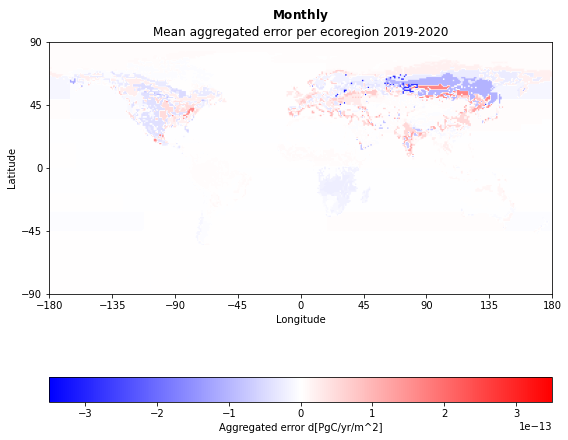

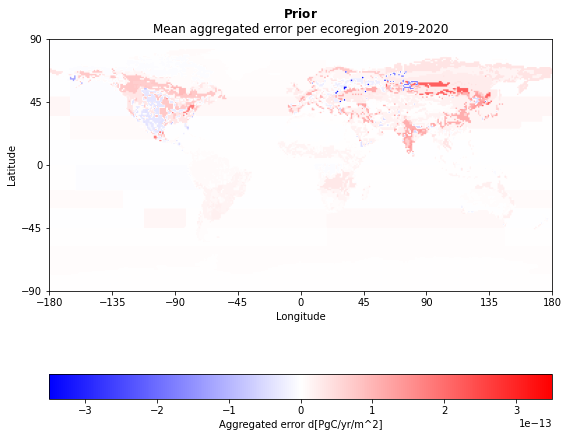

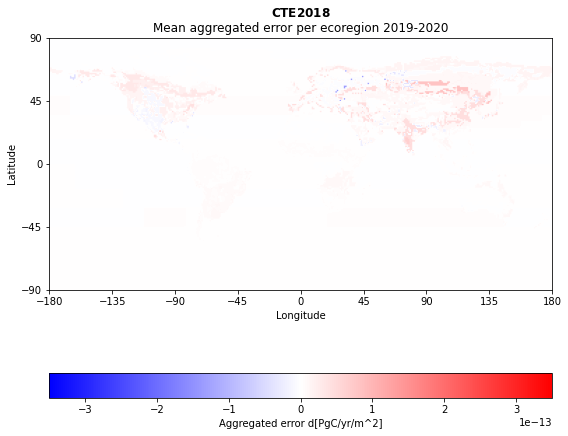

In [48]:
plt.figure(figsize = (8,8))
plt.imshow(d_ecoregion_total_montly, origin='lower', extent=[-180, 180, -90, 90], vmin=-3.5e-13, vmax =3.5e-13, cmap='bwr')
plt.title(r'$\bfMonthly}$' + "\nMean aggregated error per ecoregion 2019-2020")
plt.xlabel('Longitude')
plt.xticks(np.arange(-180, 181, 45))
plt.ylabel('Latitude')
plt.yticks(np.arange(-90, 91, 45))
cbar = plt.colorbar(orientation="horizontal")
cbar.set_label('Aggregated error d[PgC/yr/m^2]')

plt.tight_layout()
plt.show()

plt.figure(figsize = (8,8))
plt.imshow(d_ecoregion_total_prior, origin='lower', extent=[-180, 180, -90, 90], vmin=-3.5e-13, vmax =3.5e-13, cmap='bwr')
plt.title(r'$\bfPrior}$' + "\nMean aggregated error per ecoregion 2019-2020")
plt.xlabel('Longitude')
plt.xticks(np.arange(-180, 181, 45))
plt.ylabel('Latitude')
plt.yticks(np.arange(-90, 91, 45))
cbar = plt.colorbar(orientation="horizontal")
cbar.set_label('Aggregated error d[PgC/yr/m^2]')

plt.tight_layout()
plt.show()

plt.figure(figsize = (8,8))
plt.imshow(d_ecoregion_total_smooth, origin='lower', extent=[-180, 180, -90, 90], vmin=-3.5e-13, vmax =3.5e-13, cmap='bwr')
plt.title(r'$\bfCTE2018}$' + "\nMean aggregated error per ecoregion 2019-2020")
plt.xlabel('Longitude')
plt.xticks(np.arange(-180, 181, 45))
plt.ylabel('Latitude')
plt.yticks(np.arange(-90, 91, 45))
cbar = plt.colorbar(orientation="horizontal")
cbar.set_label('Aggregated error d[PgC/yr/m^2]')

plt.tight_layout()
plt.show()

In [50]:
print(np.mean(d_ecoregion_total_montly))
print(np.mean(d_ecoregion_total_prior))
print(np.mean(d_ecoregion_total_smooth))

4.312924087079861e-17
5.777904282849931e-15
2.039966325789144e-15


In [49]:
def frequency_sample_std_dev(X, n):
    """
    Sample standard deviation for X and n,
    where X[i] is quantity of every element in group i,
    and n[i] is the number of elements in group i.
    See Equation 6.4 of:
    Montgomery, Douglas, C. and George C. Runger. Applied Statistics 
     and Probability for Engineers, Enhanced eText. Available from: 
      WileyPLUS, (7th Edition). Wiley Global Education US, 2018.
    """
    n_groups = len(n)
    n_elements = sum(n)
    lhs_numerator = sum([ni*Xi**2 for Xi, ni in zip(X, n)])
    rhs_numerator = sum([Xi*ni for Xi, ni in zip(X,n)])**2/n_elements
    denominator = n_elements-1
    var = (lhs_numerator - rhs_numerator) / denominator
    std = sqrt(var)
    return std

In [51]:
with nc.Dataset(files[1]) as ds:
    area_per_grid_cell = calc_area(ds['lat'][:],ds['lon'][:])

weight_ecoregion = {}
for region, mask in all_regiondict.items():
    weight_ecoregion[region] = np.sum(mask * area_per_grid_cell)


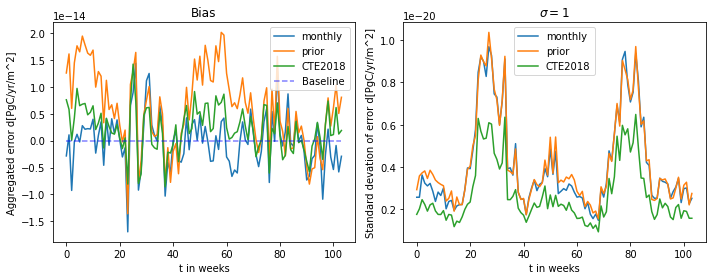

In [81]:

d1 = DescrStatsW(error_per_ecoregion_monthly.T, list(weight_ecoregion.values()))
d2 = DescrStatsW(error_per_ecoregion_prior.T, list(weight_ecoregion.values()))
d3 = DescrStatsW(error_per_ecoregion_smooth.T, list(weight_ecoregion.values()))

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,4))

ax1.plot(d1.mean, label='monthly')
ax1.plot(d2.mean, label='prior')
ax1.plot(d3.mean, label='CTE2018')
ax1.plot(np.zeros(len(d1.mean)), color='b', alpha=0.5, linestyle='dashed', label='Baseline')

# square_err_per_week['bias_monthly_avg'].plot(label='x=model_(monthly)')
# square_err_per_week['bias_prior'].plot(label='x=model_(prior)')
ax1.set_title('Bias')
ax1.set_xlabel('t in weeks')
ax1.set_ylabel('Aggregated error d[PgC/yr/m^2]')
ax1.legend()
#ax1.tight_layout()
#d.std_mean
# print(error_per_ecoregion_monthly.T)
# print(list(weight_ecoregion.values()))

ax2.plot(d1.std_mean, label='monthly')
ax2.plot(d2.std_mean, label='prior')
ax2.plot(d3.std_mean, label='CTE2018')

ax2.set_title(r'$\sigma=1}$')
ax2.set_xlabel('t in weeks')
ax2.set_ylabel('Standard devation of error d[PgC/yr/m^2]')
ax2.legend()
plt.tight_layout()
plt.savefig('../figures/bias_weighted_stddev_per_week.pdf')
plt.show()

In [93]:
print(np.mean(d1.mean))
print(np.mean(d2.mean))

-4.017793405708125e-17
6.1073366811171566e-15


## The code below is used for creating the a set of images depicting the delta between the optimized model and prior models.

Currently processing date: 2019-01-05 00:00:00


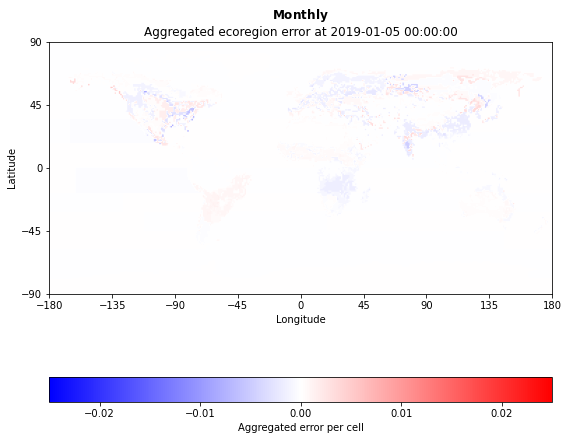

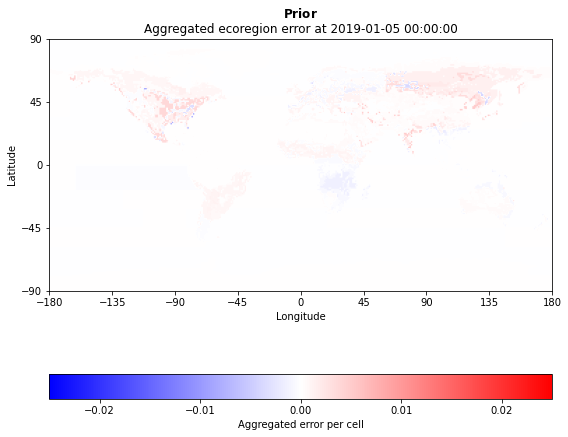

Currently processing date: 2019-01-12 00:00:00


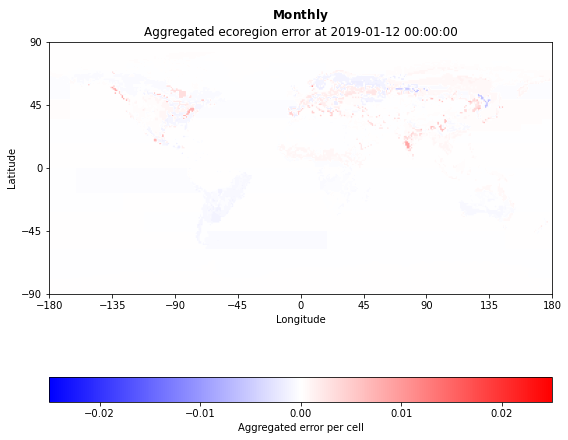

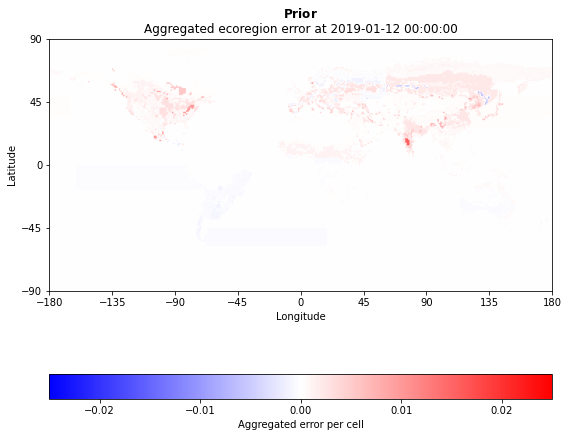

Currently processing date: 2019-01-19 00:00:00


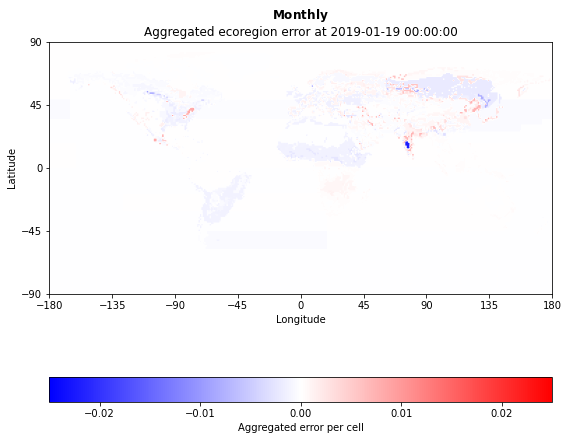

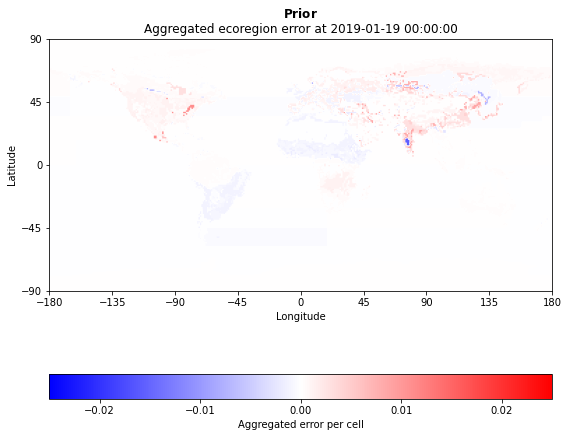

Currently processing date: 2019-01-26 00:00:00


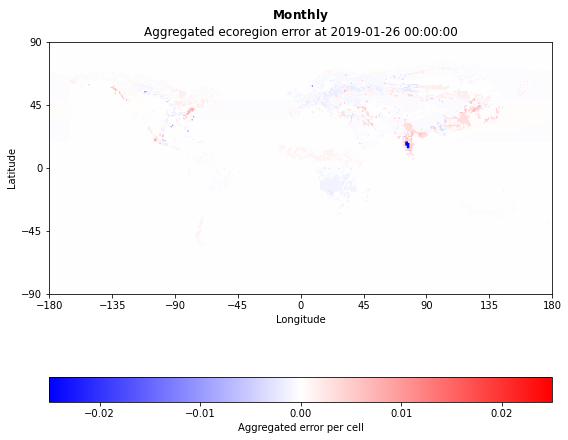

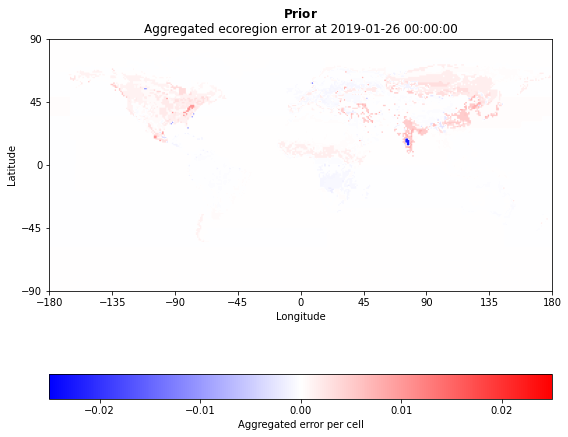

Currently processing date: 2019-02-02 00:00:00


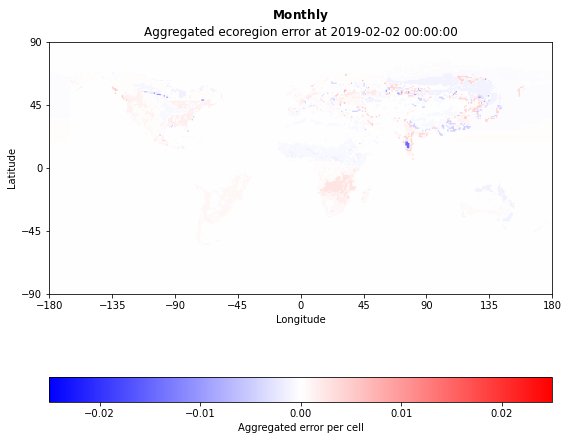

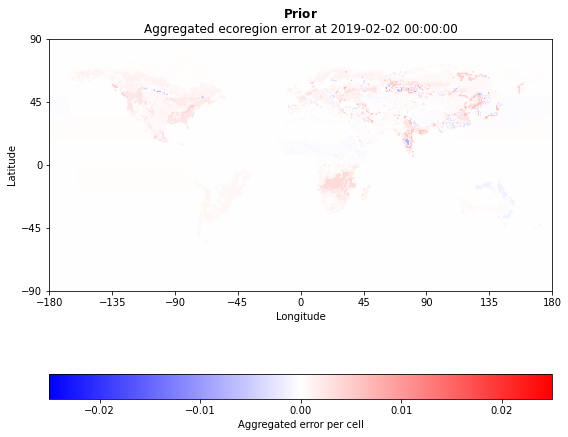

Currently processing date: 2019-02-09 00:00:00


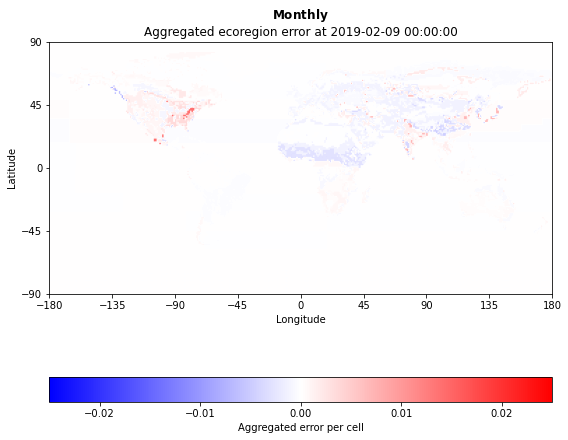

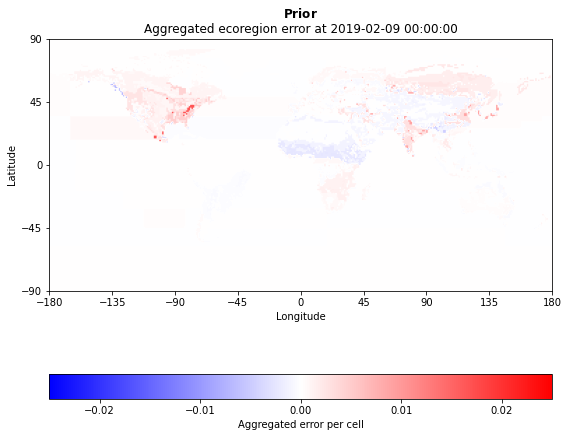

Currently processing date: 2019-02-16 00:00:00


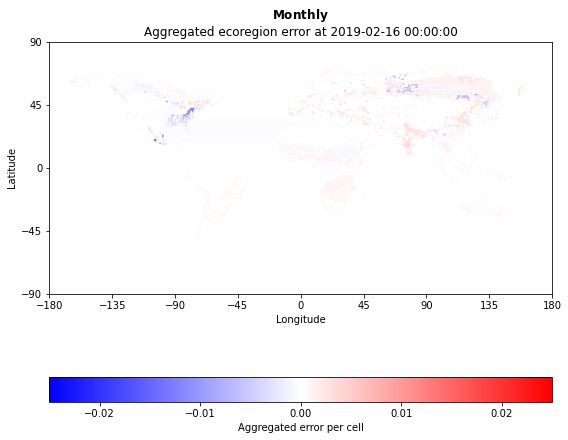

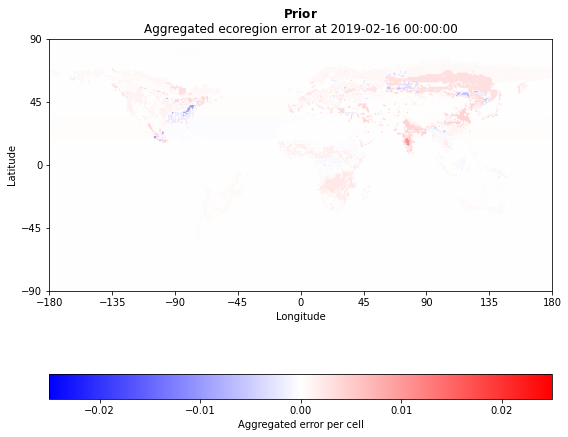

Currently processing date: 2019-02-23 00:00:00


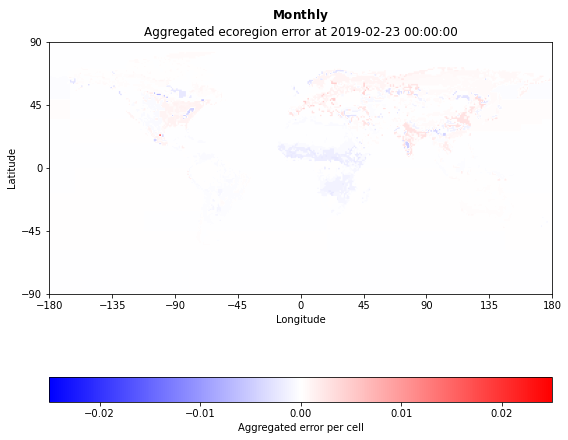

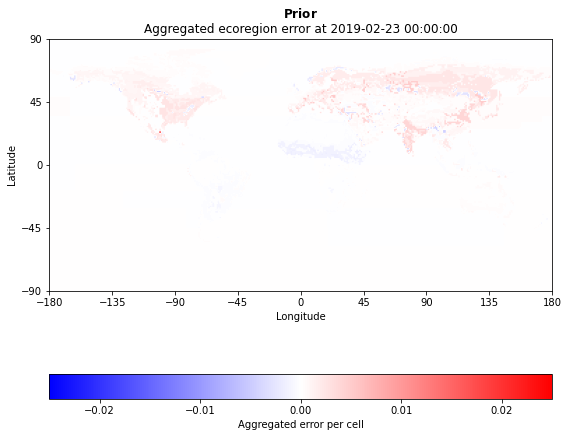

Currently processing date: 2019-03-02 00:00:00


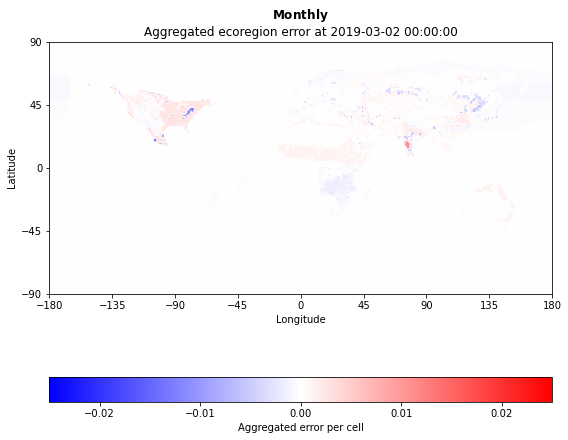

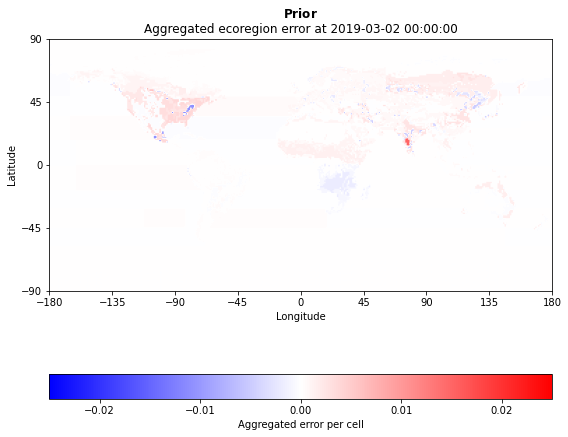

Currently processing date: 2019-03-09 00:00:00


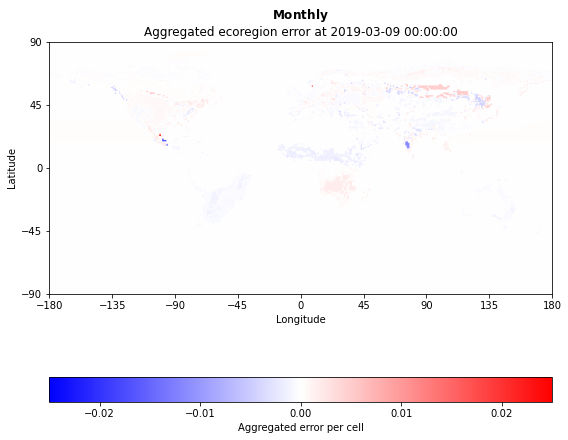

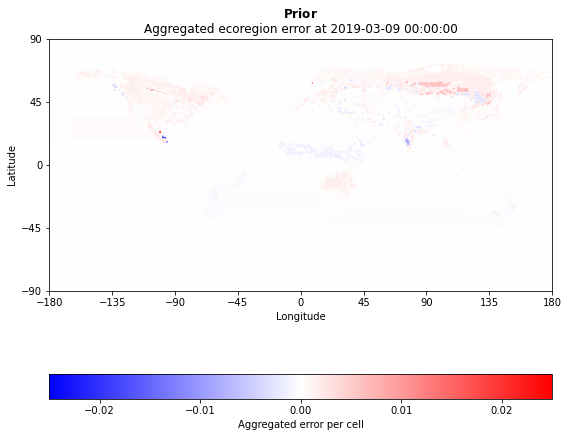

Currently processing date: 2019-03-16 00:00:00


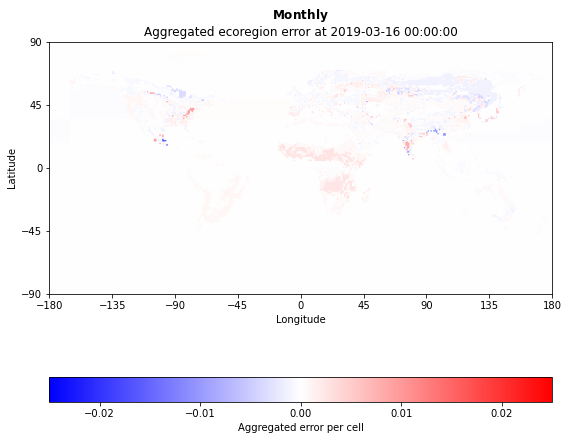

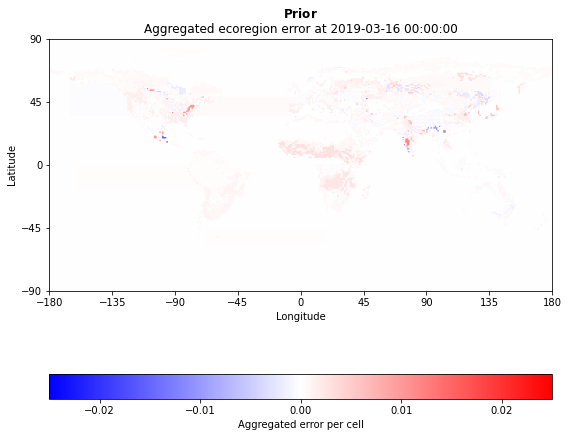

Currently processing date: 2019-03-23 00:00:00


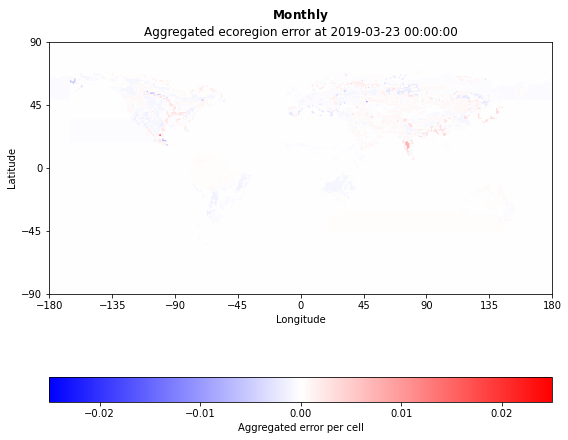

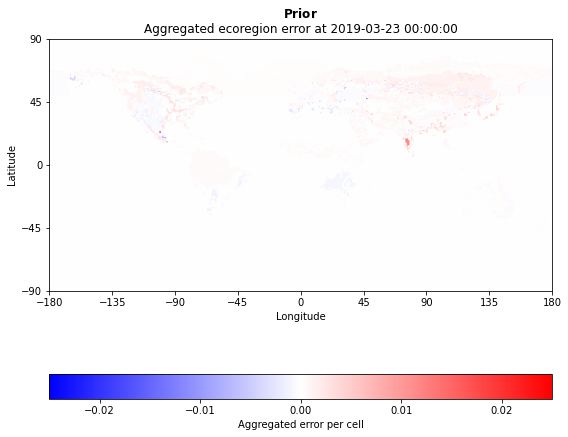

Currently processing date: 2019-03-30 00:00:00


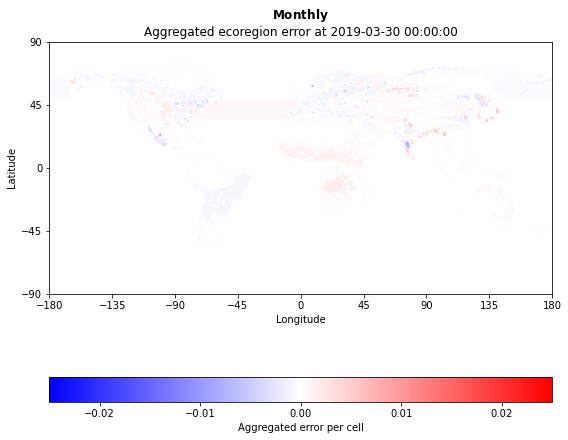

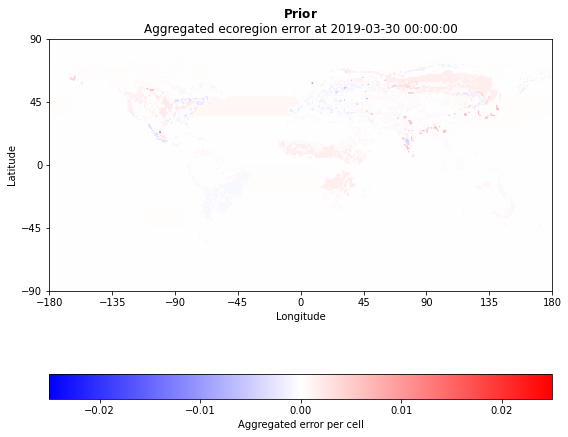

Currently processing date: 2019-04-06 00:00:00


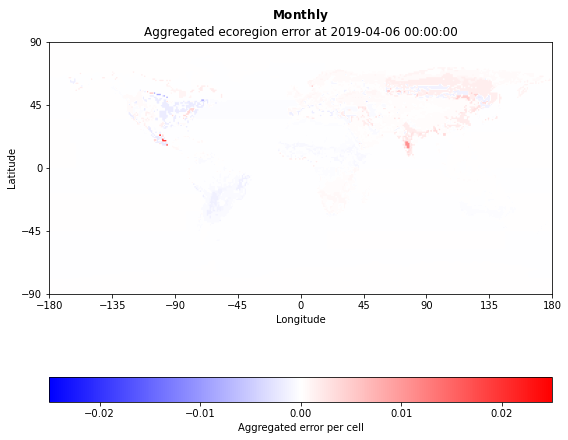

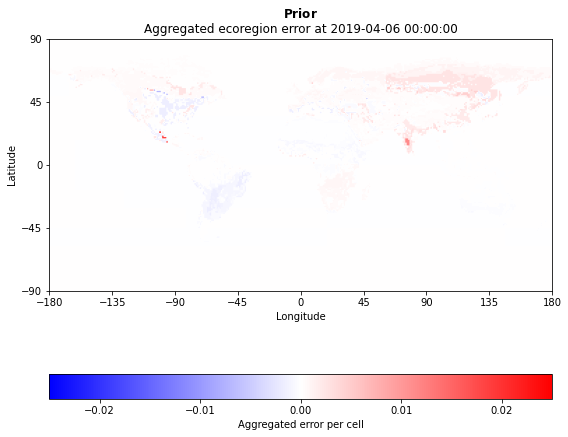

Currently processing date: 2019-04-13 00:00:00


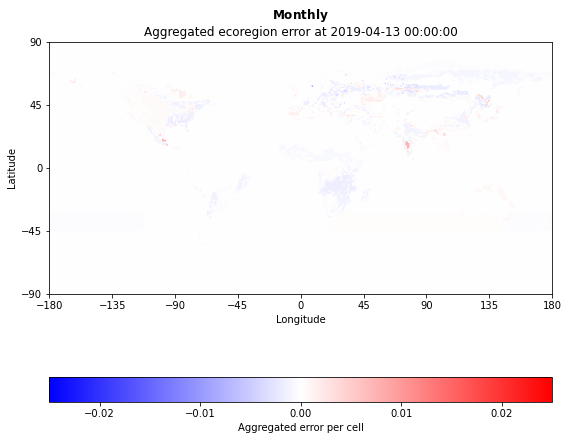

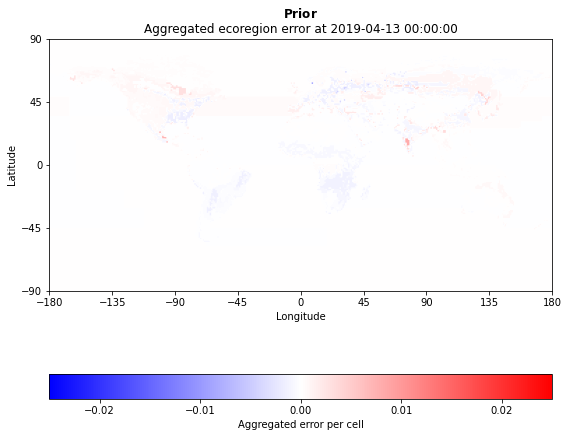

Currently processing date: 2019-04-20 00:00:00


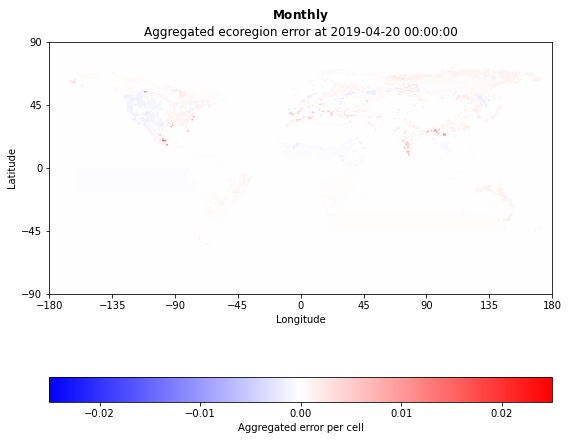

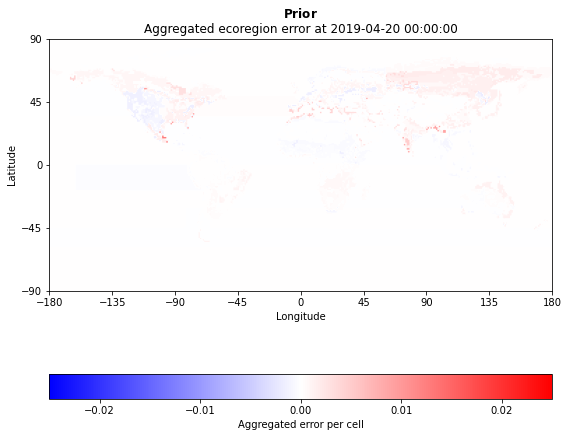

Currently processing date: 2019-04-27 00:00:00


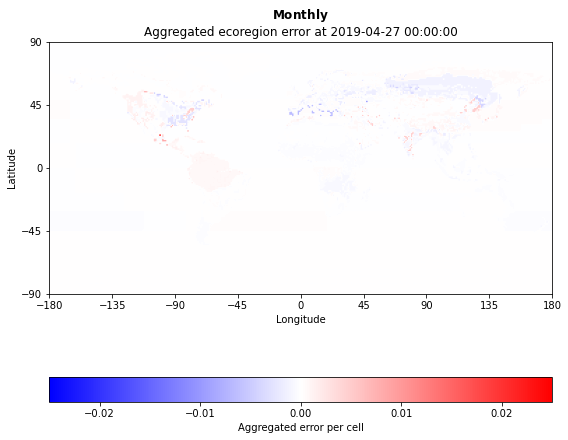

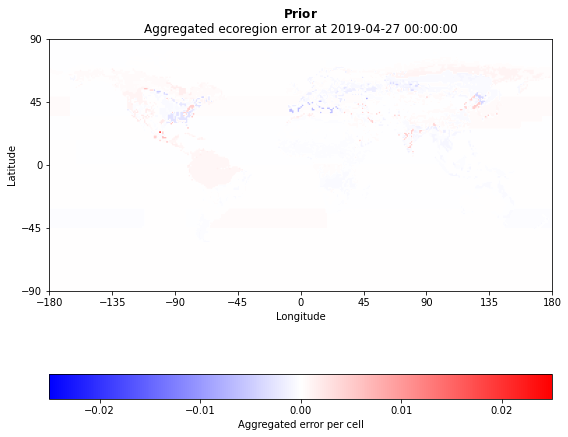

Currently processing date: 2019-05-04 00:00:00


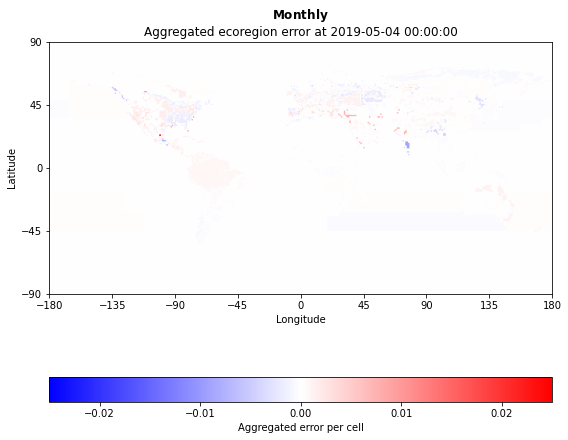

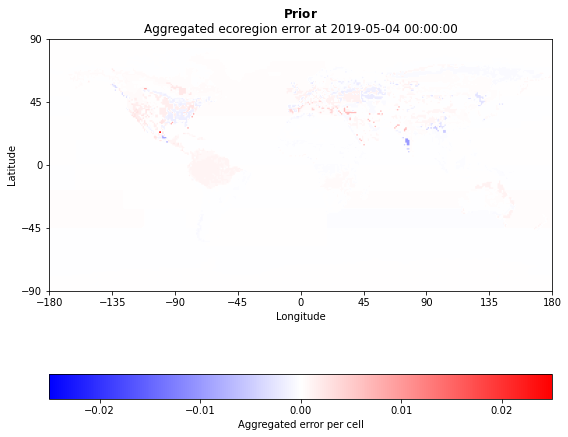

Currently processing date: 2019-05-11 00:00:00


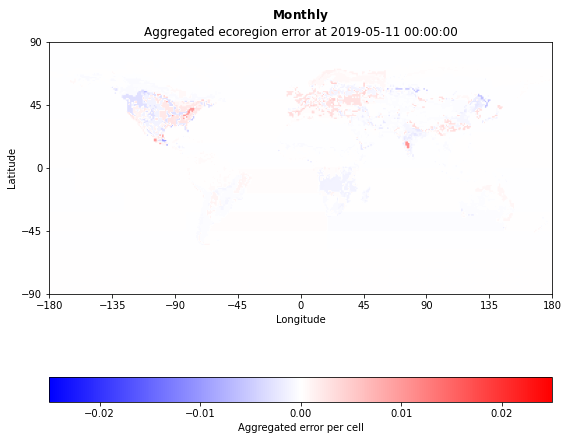

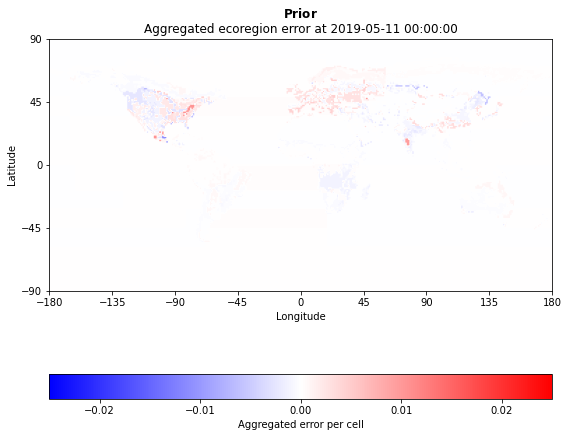

Currently processing date: 2019-05-18 00:00:00


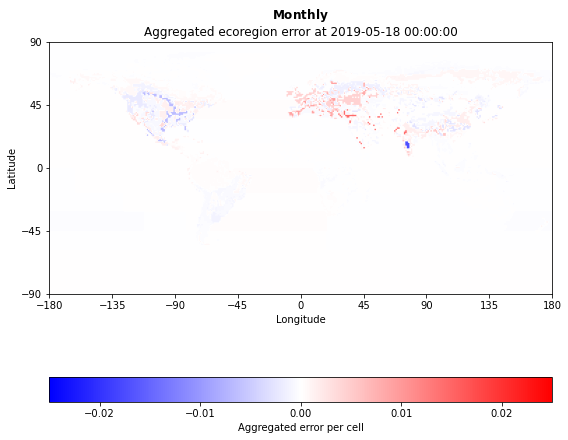

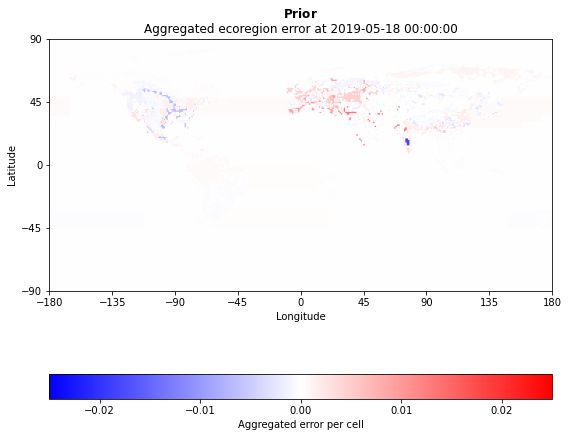

Currently processing date: 2019-05-25 00:00:00


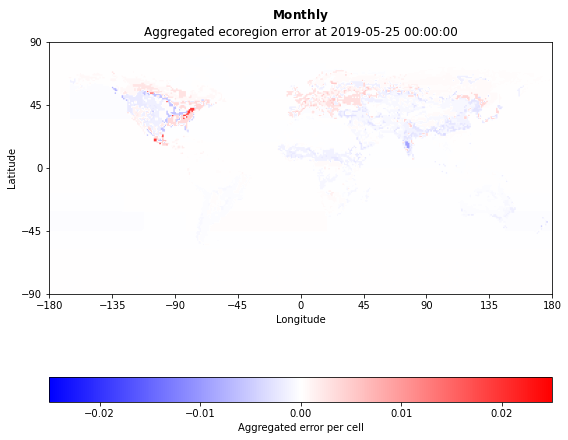

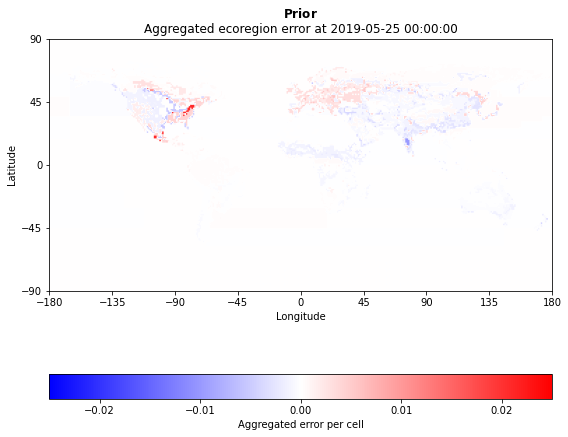

Currently processing date: 2019-06-01 00:00:00


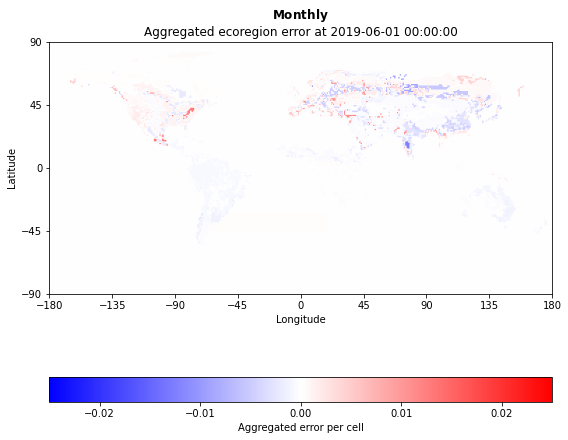

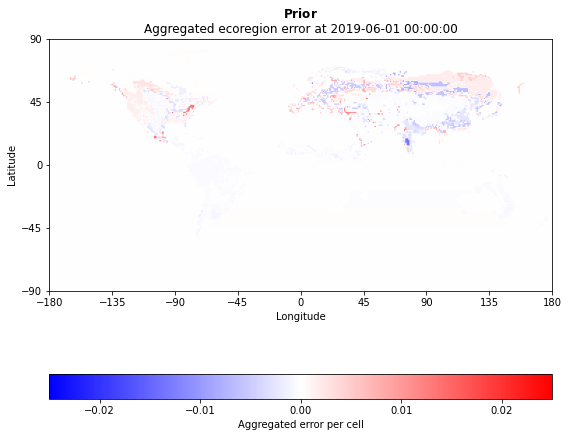

Currently processing date: 2019-06-08 00:00:00


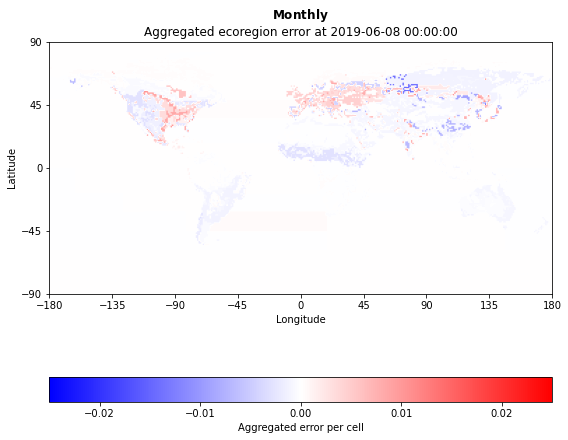

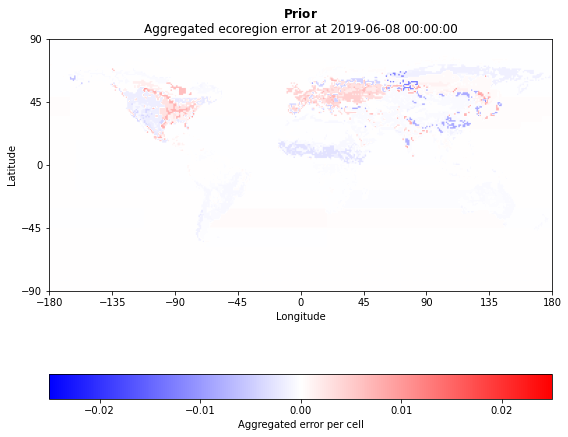

Currently processing date: 2019-06-15 00:00:00


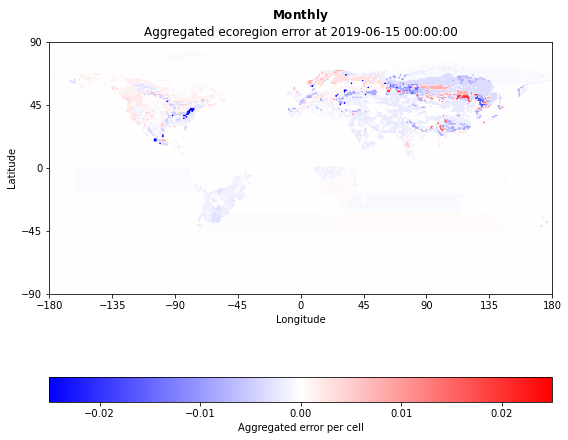

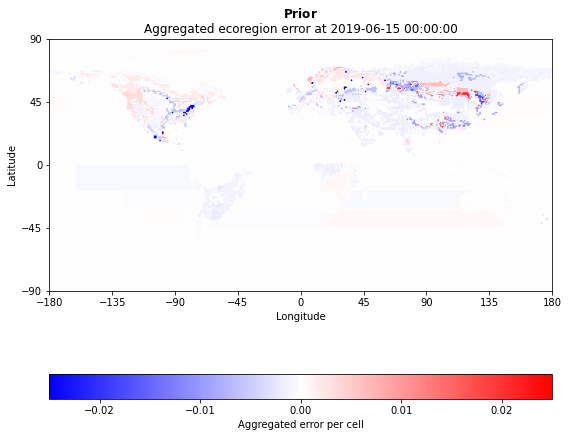

Currently processing date: 2019-06-22 00:00:00


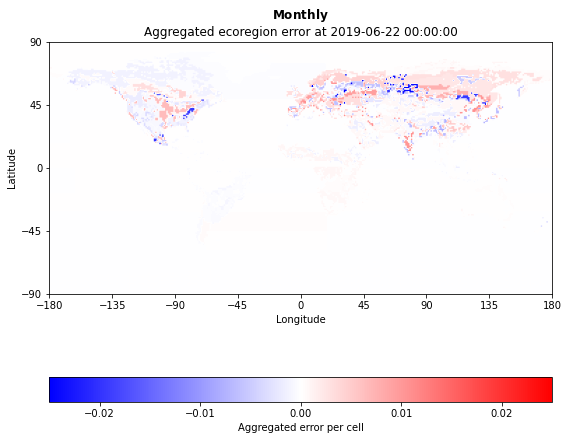

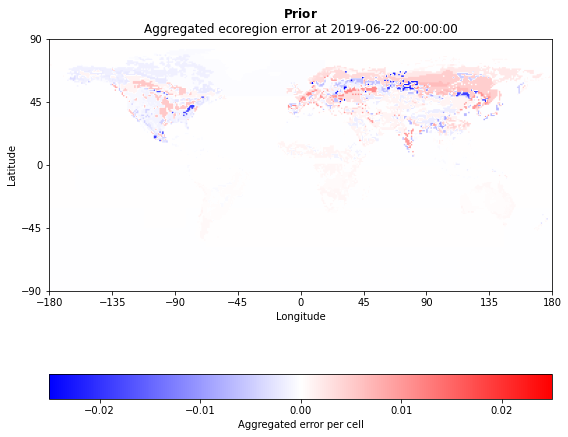

Currently processing date: 2019-06-29 00:00:00


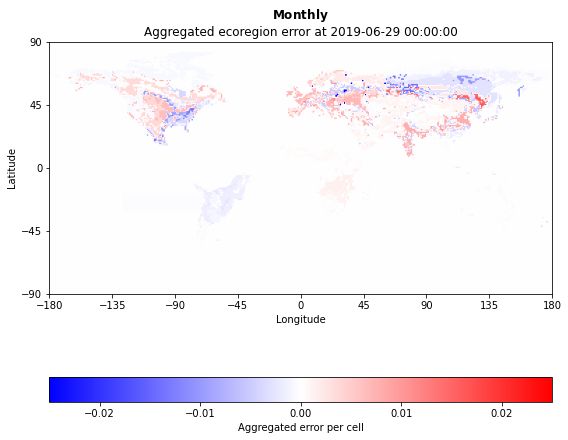

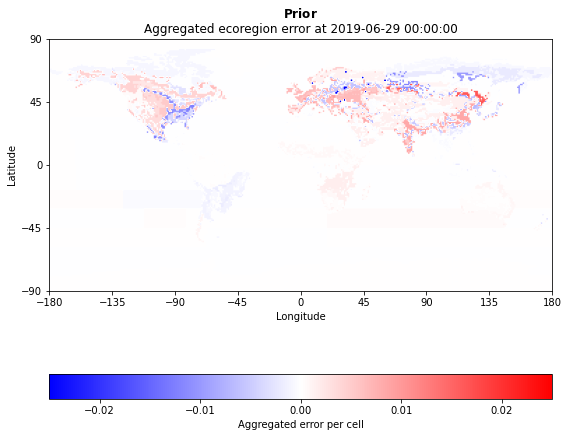

Currently processing date: 2019-07-06 00:00:00


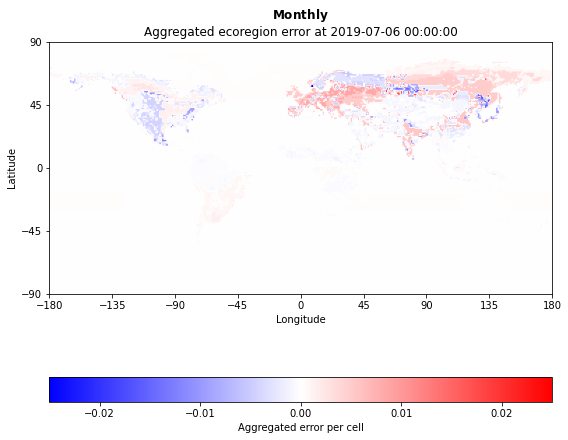

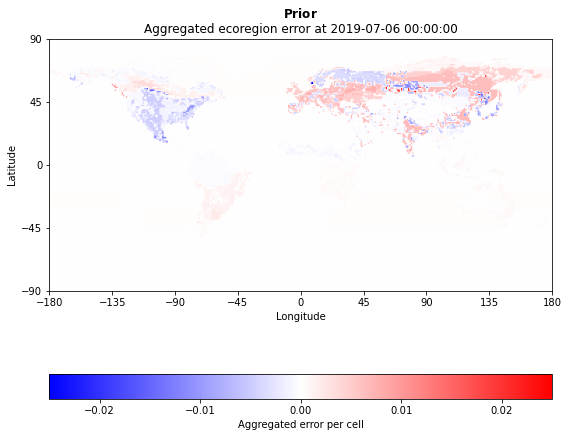

Currently processing date: 2019-07-13 00:00:00


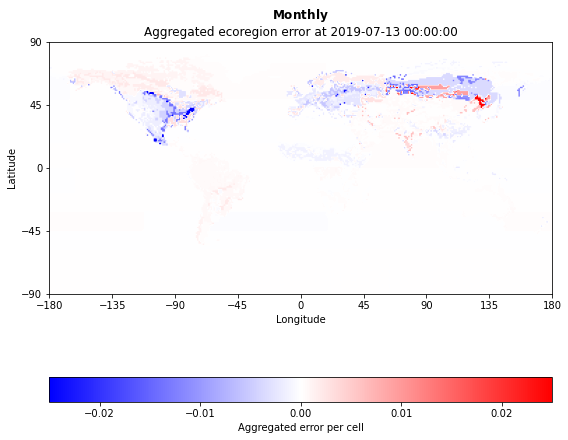

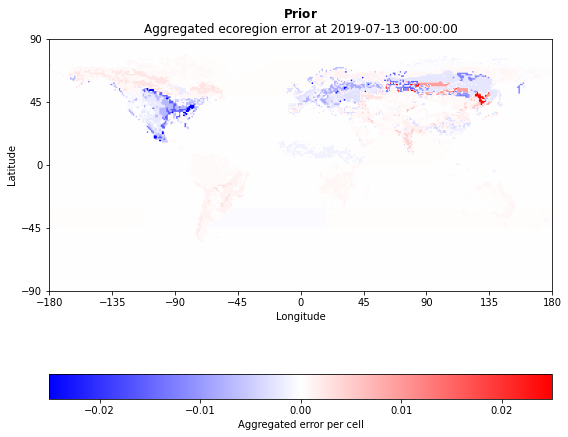

Currently processing date: 2019-07-20 00:00:00


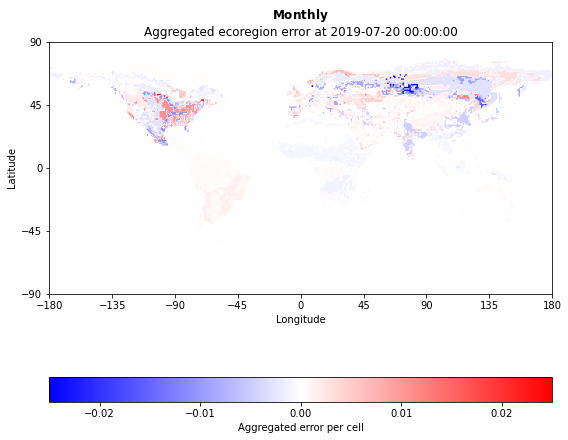

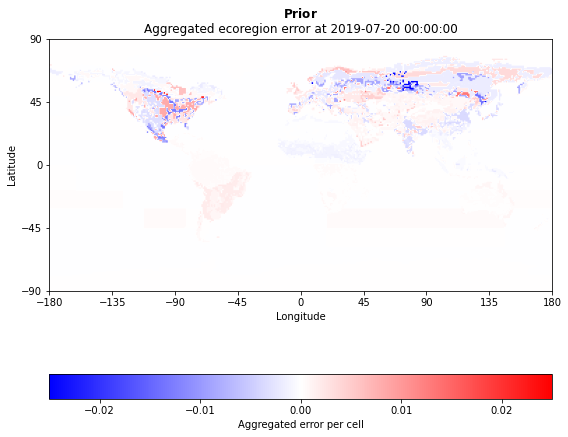

Currently processing date: 2019-07-27 00:00:00


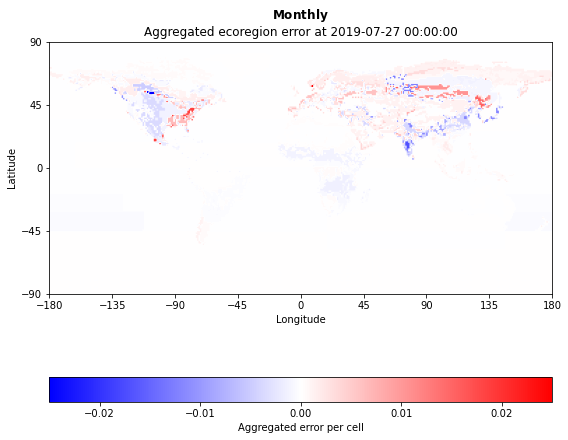

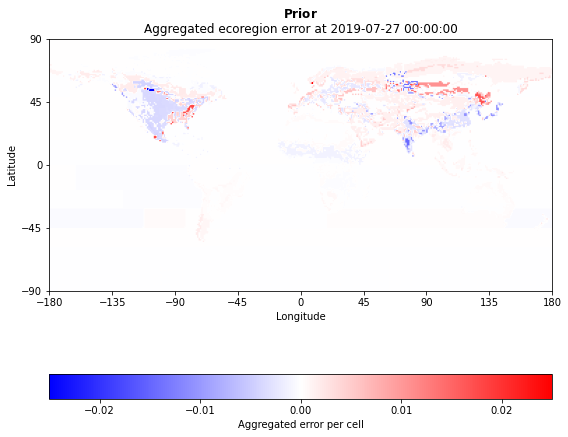

Currently processing date: 2019-08-03 00:00:00


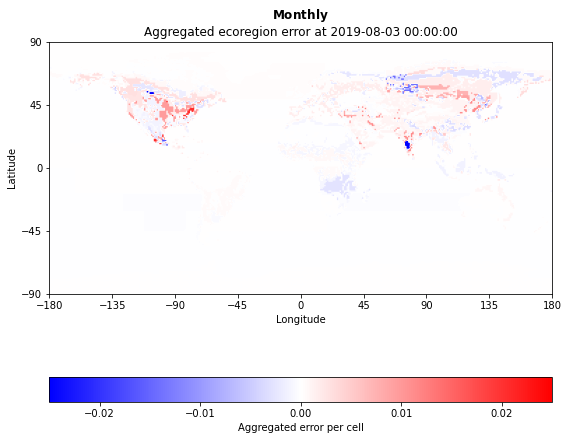

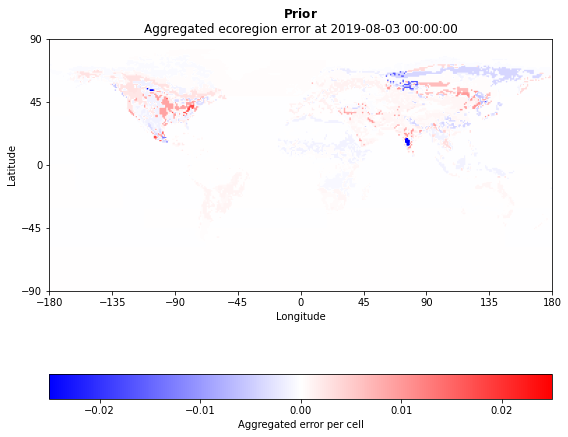

Currently processing date: 2019-08-10 00:00:00


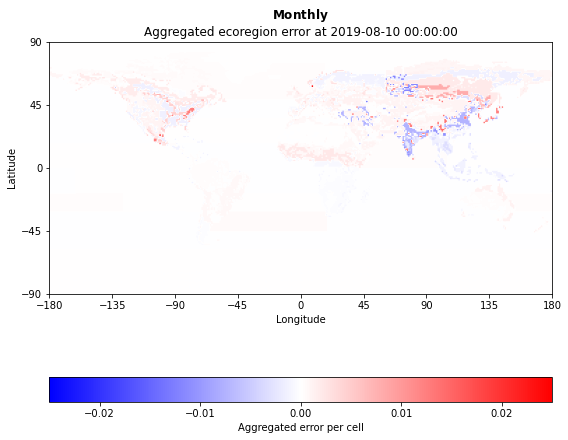

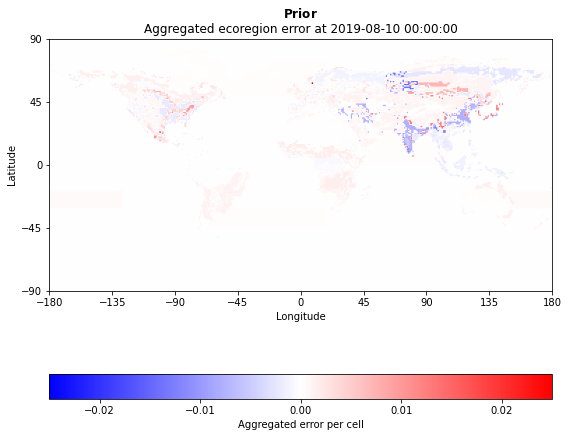

Currently processing date: 2019-08-17 00:00:00


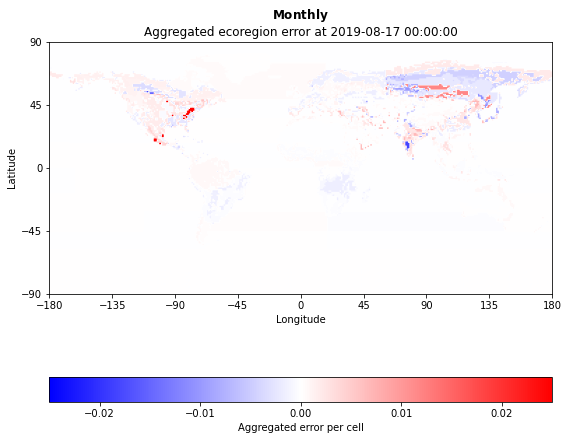

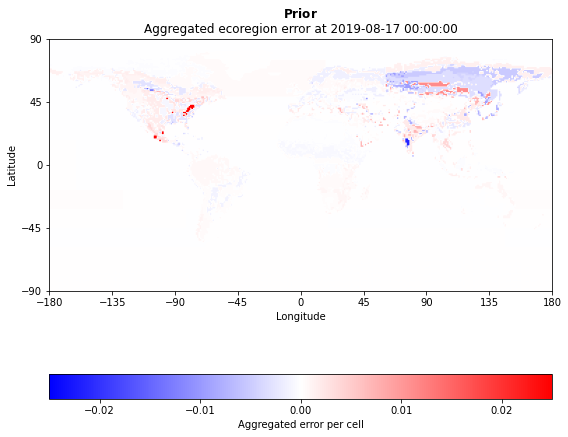

Currently processing date: 2019-08-24 00:00:00


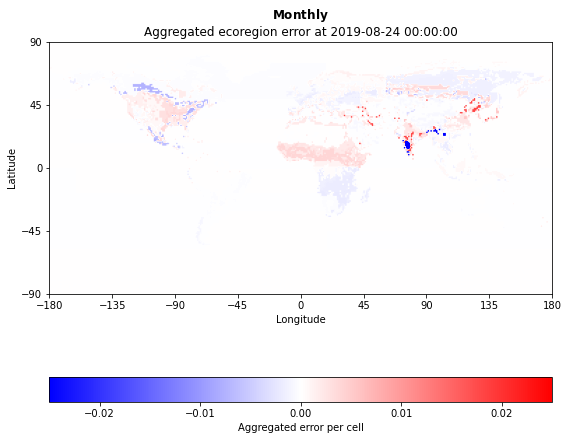

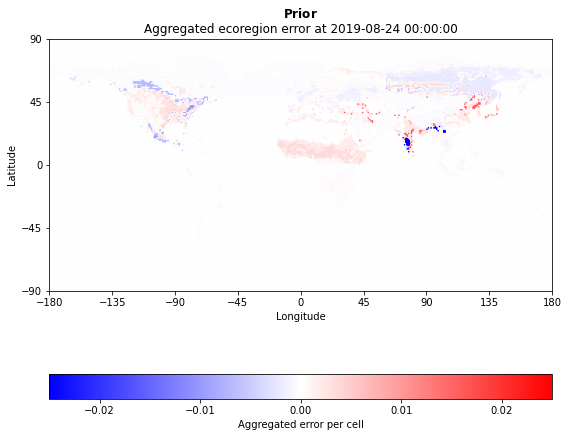

Currently processing date: 2019-08-31 00:00:00


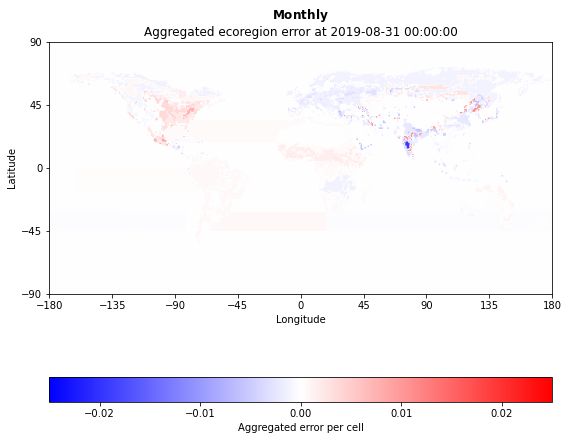

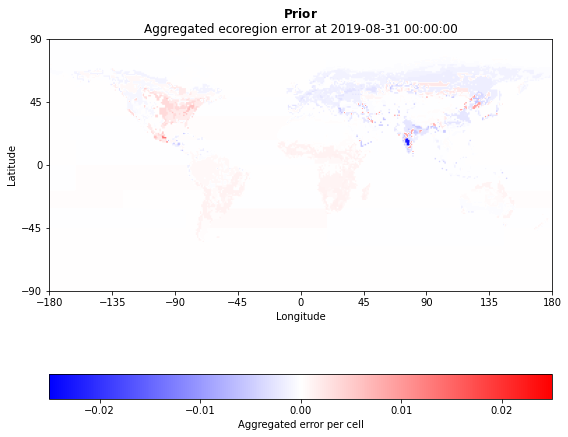

Currently processing date: 2019-09-07 00:00:00


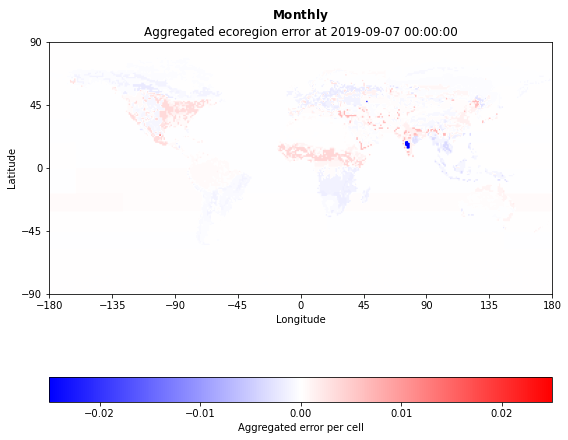

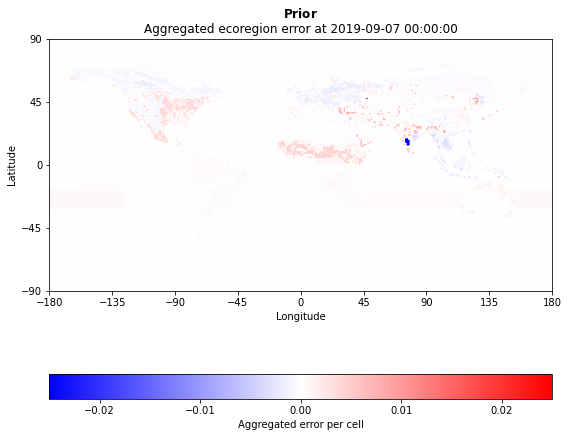

Currently processing date: 2019-09-14 00:00:00


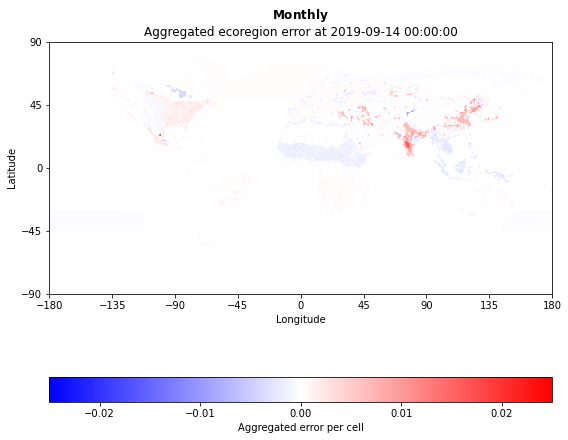

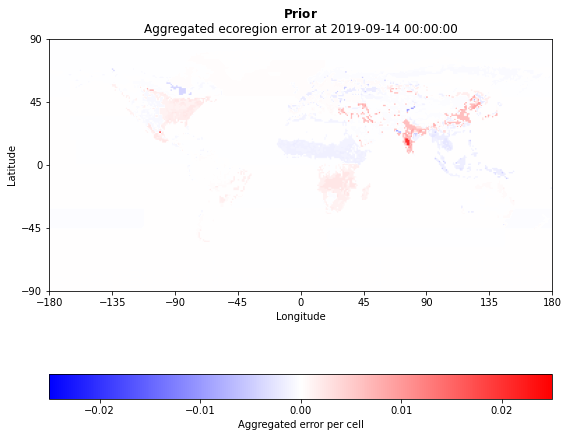

Currently processing date: 2019-09-21 00:00:00


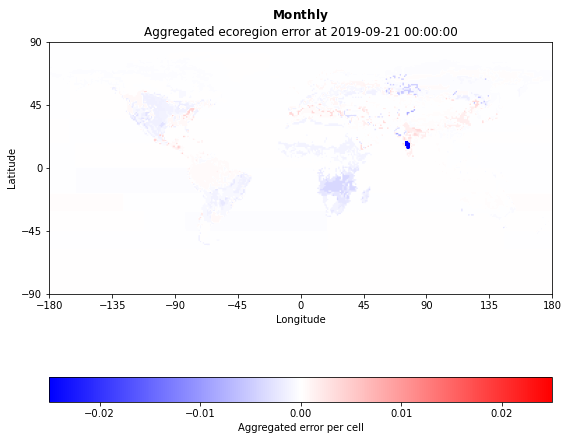

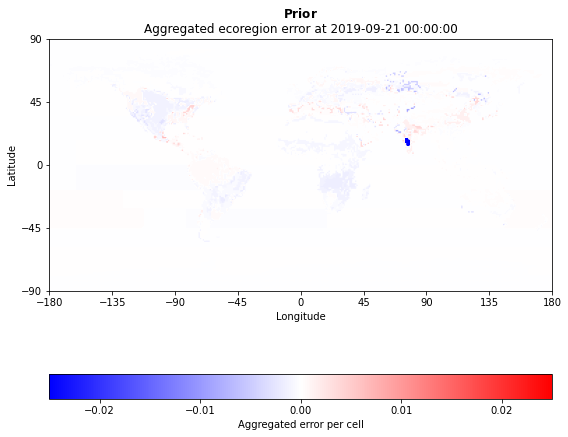

Currently processing date: 2019-09-28 00:00:00


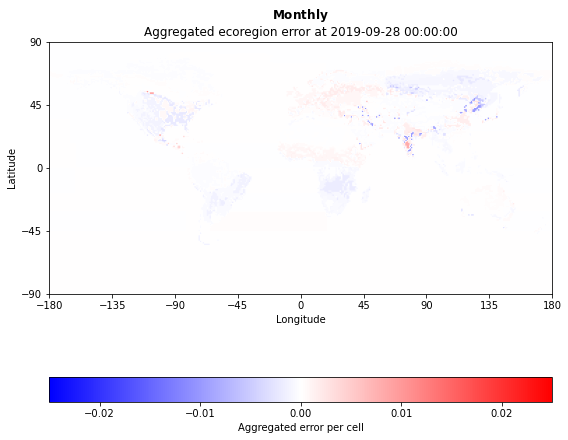

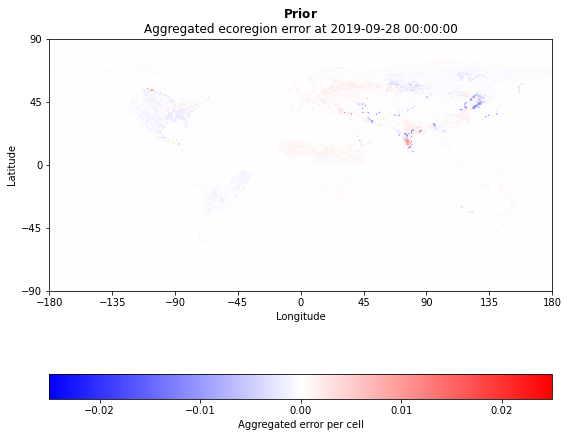

Currently processing date: 2019-10-05 00:00:00


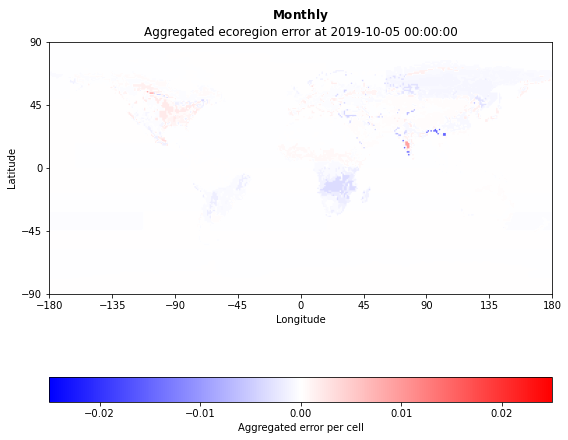

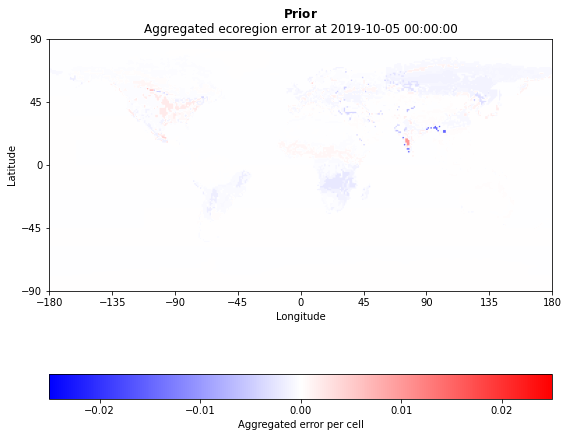

Currently processing date: 2019-10-12 00:00:00


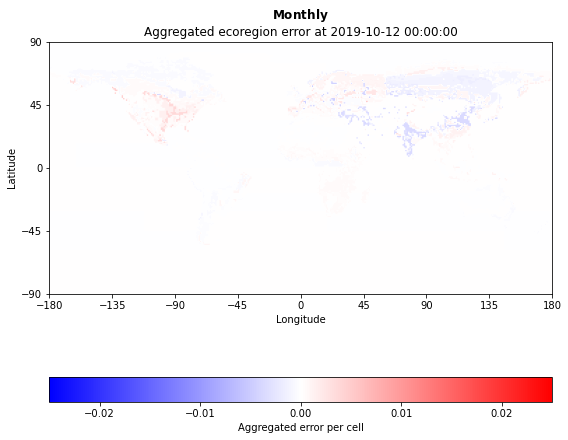

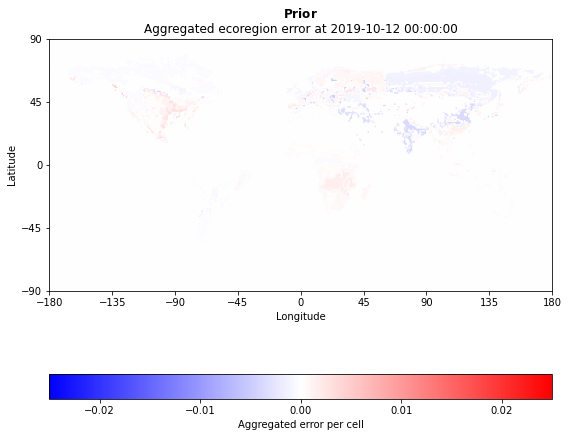

Currently processing date: 2019-10-19 00:00:00


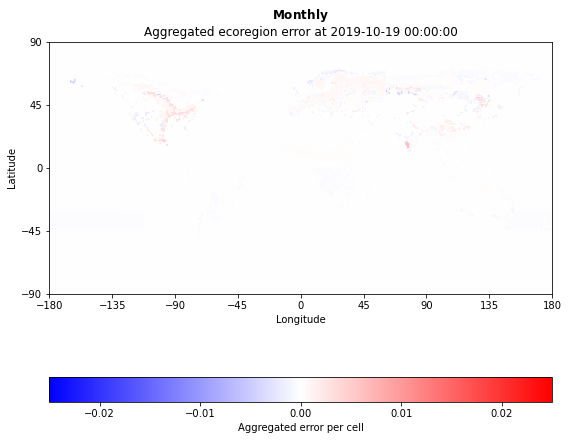

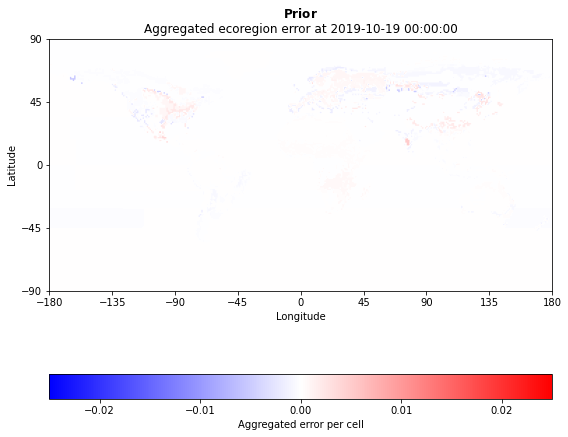

Currently processing date: 2019-10-26 00:00:00


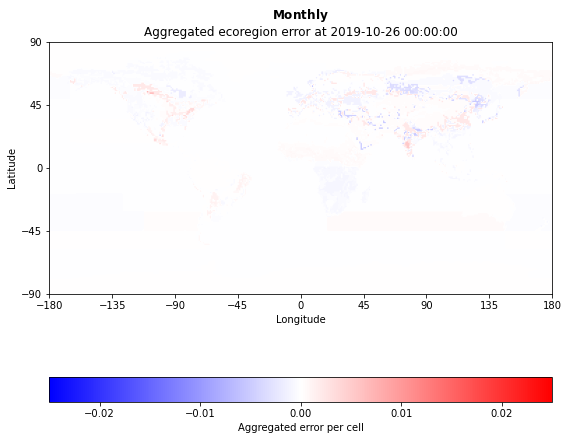

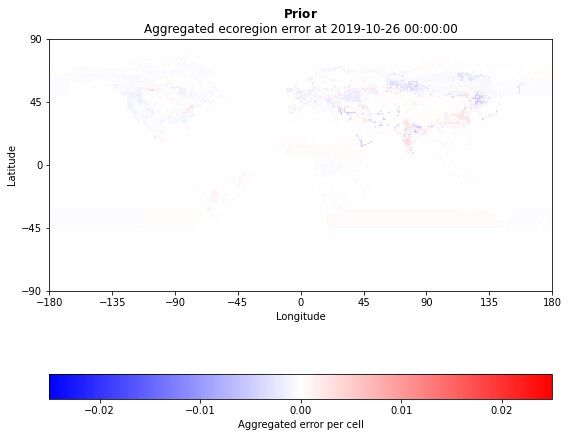

Currently processing date: 2019-11-02 00:00:00


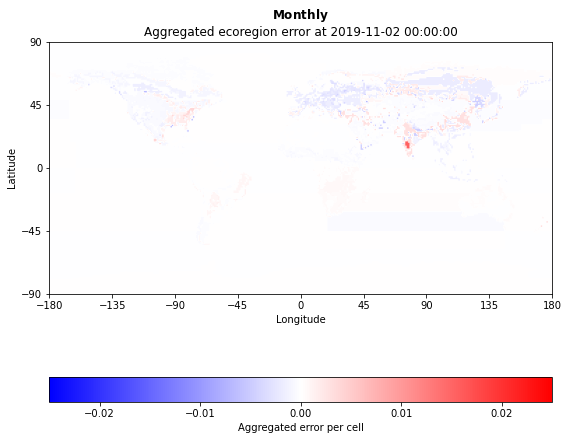

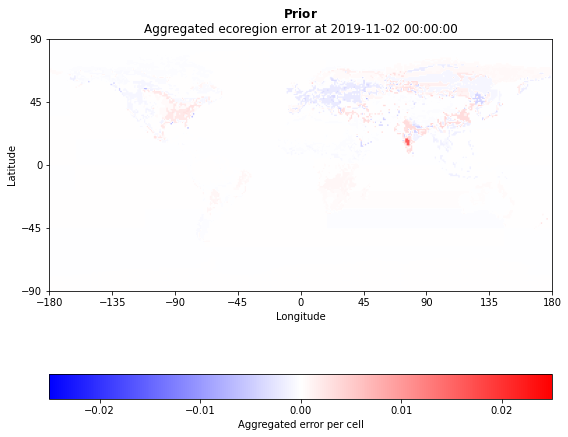

Currently processing date: 2019-11-09 00:00:00


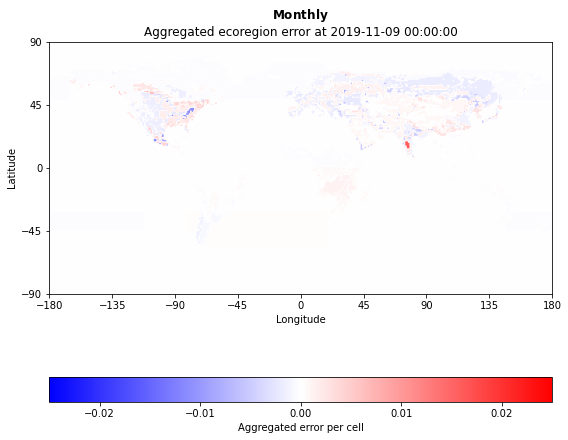

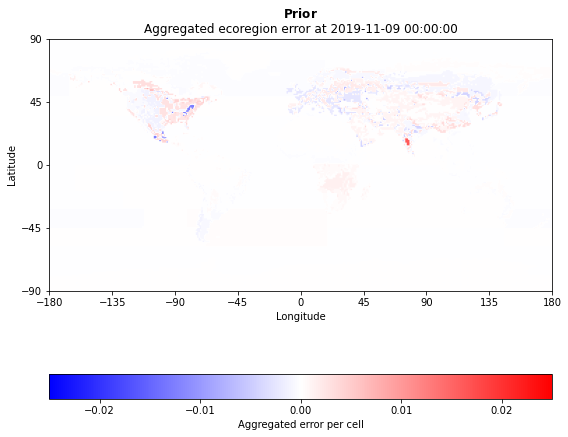

Currently processing date: 2019-11-16 00:00:00


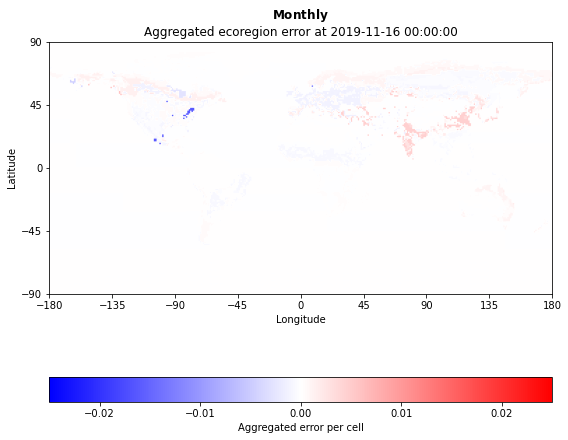

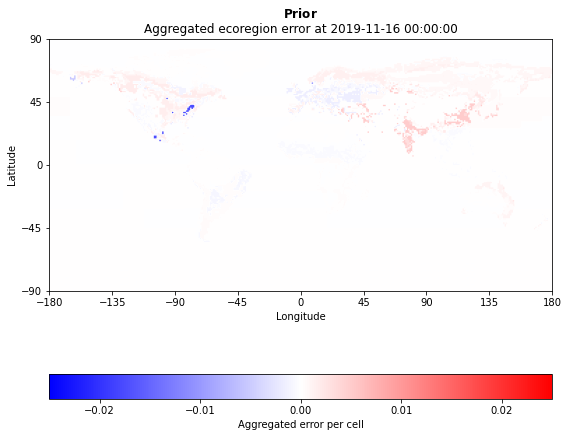

Currently processing date: 2019-11-23 00:00:00


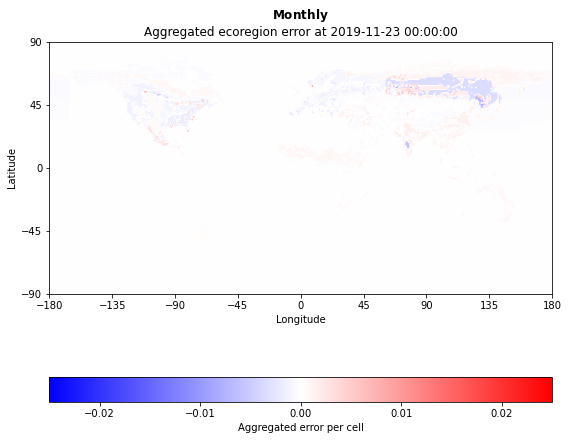

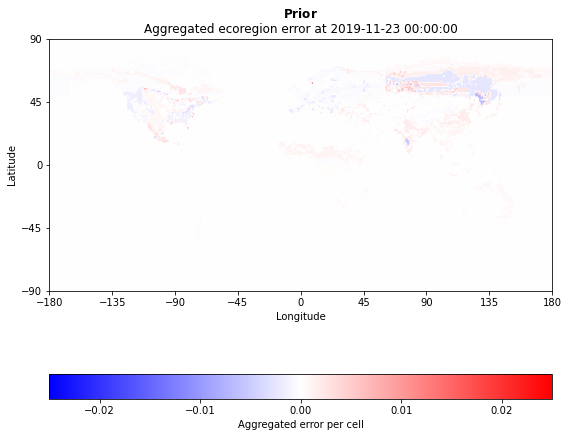

Currently processing date: 2019-11-30 00:00:00


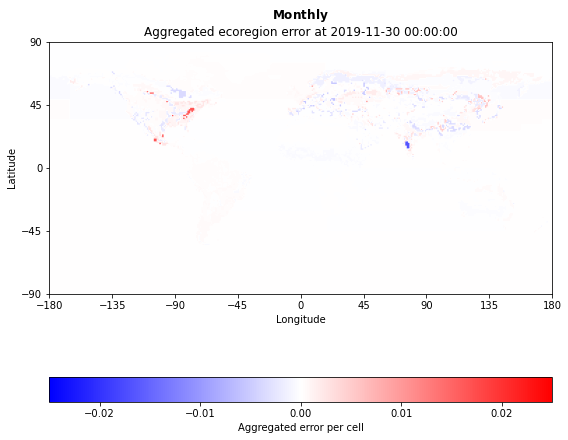

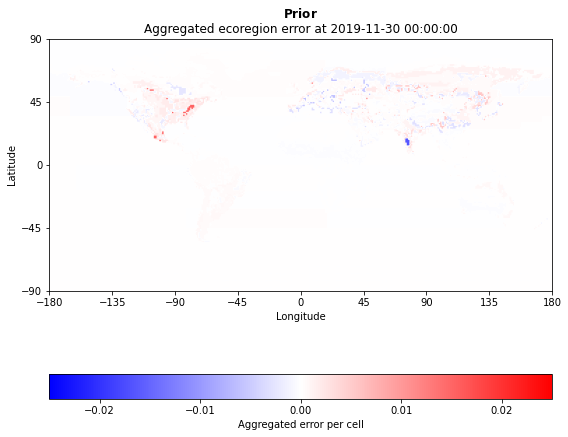

Currently processing date: 2019-12-07 00:00:00


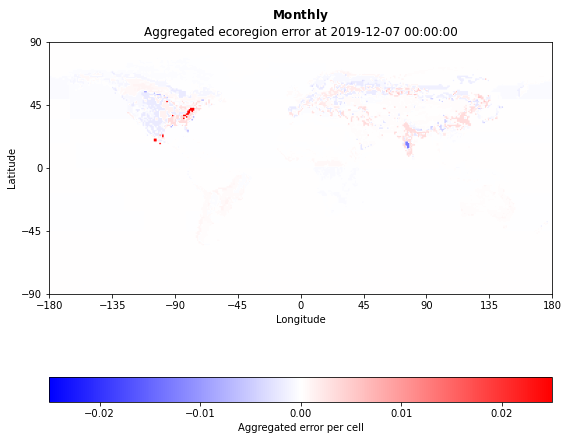

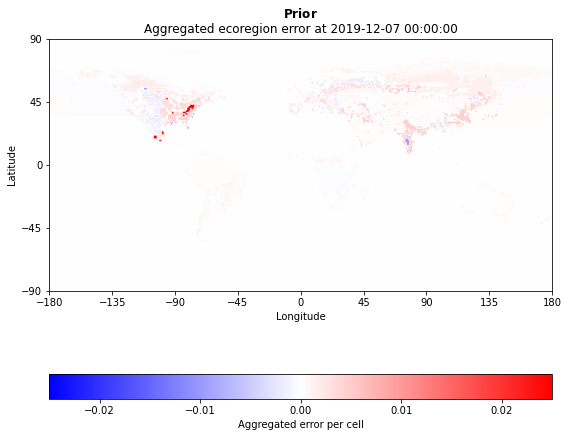

Currently processing date: 2019-12-14 00:00:00


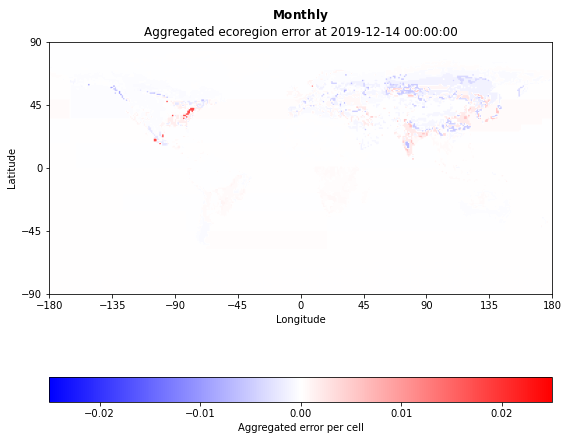

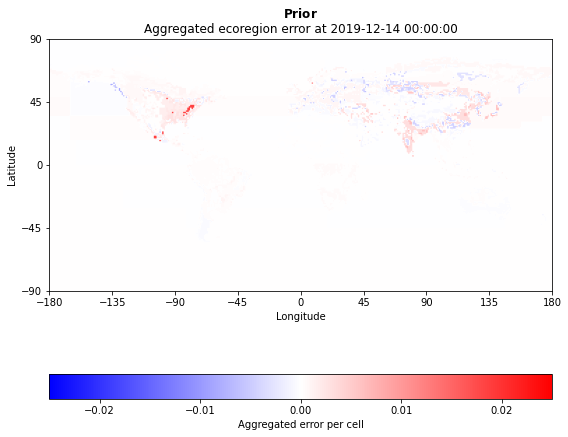

Currently processing date: 2019-12-21 00:00:00


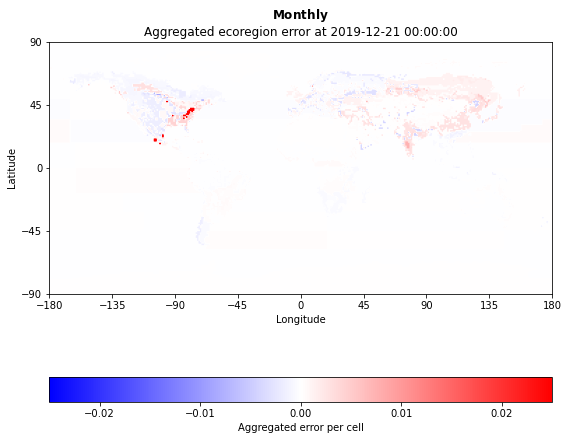

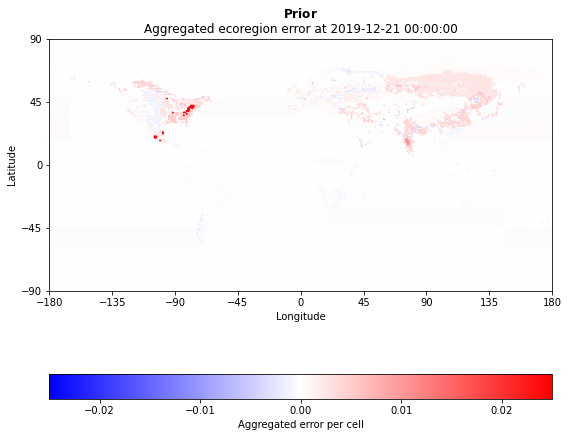

Currently processing date: 2019-12-28 00:00:00


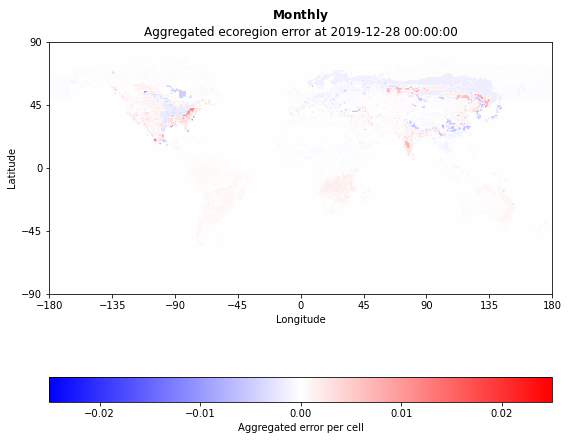

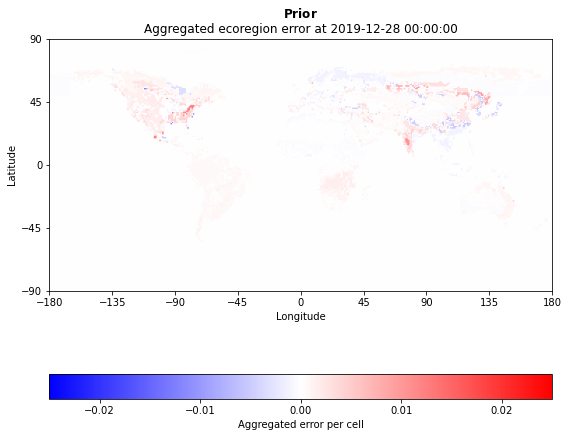

Currently processing date: 2020-01-04 00:00:00


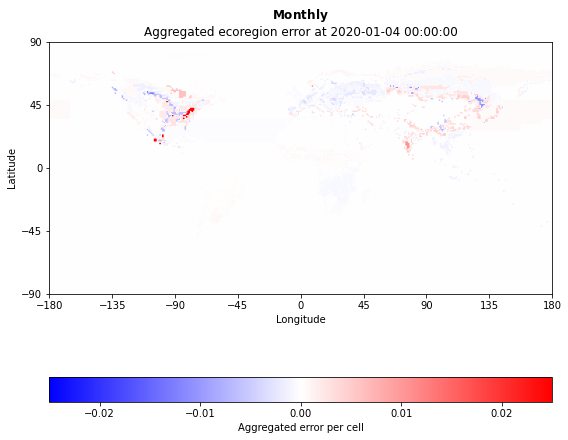

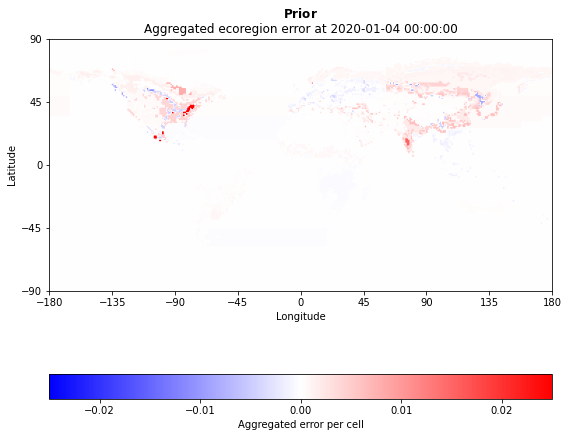

Currently processing date: 2020-01-11 00:00:00


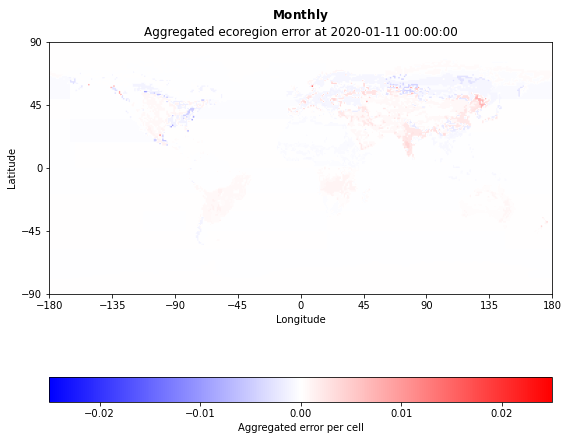

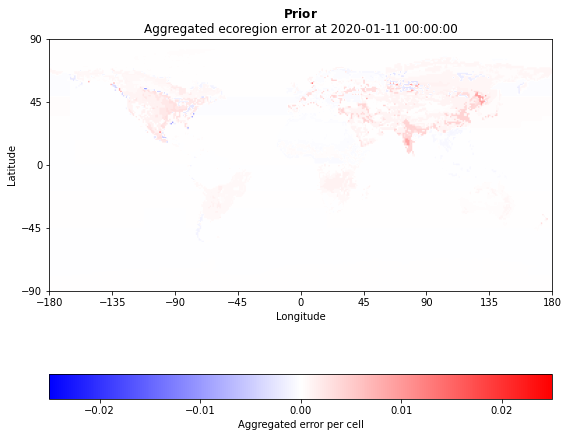

Currently processing date: 2020-01-18 00:00:00


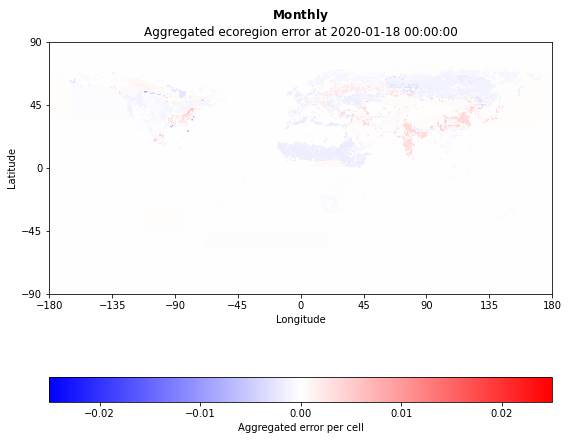

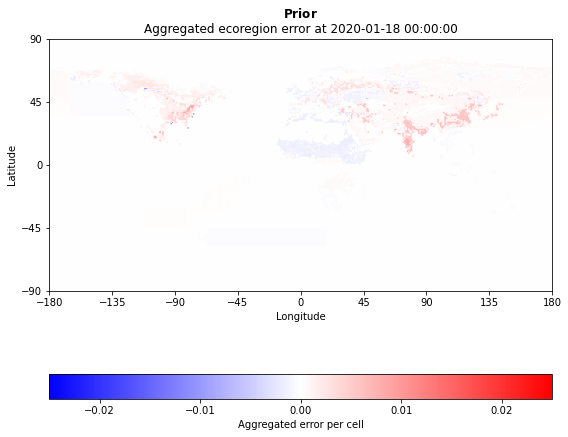

Currently processing date: 2020-01-25 00:00:00


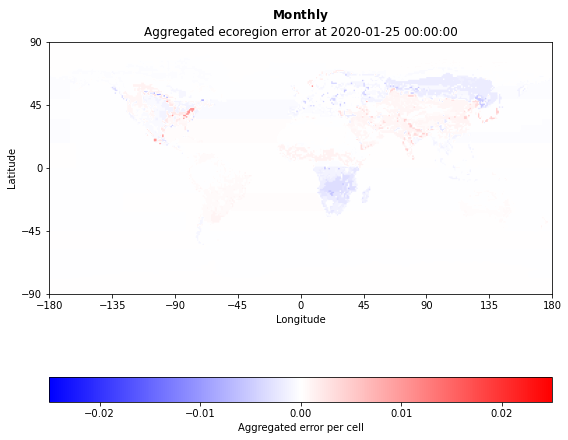

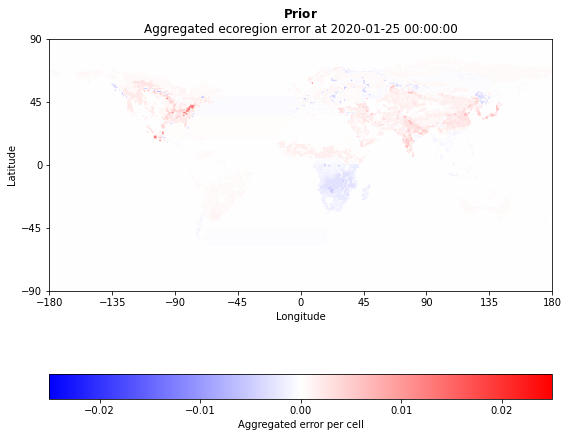

Currently processing date: 2020-02-01 00:00:00


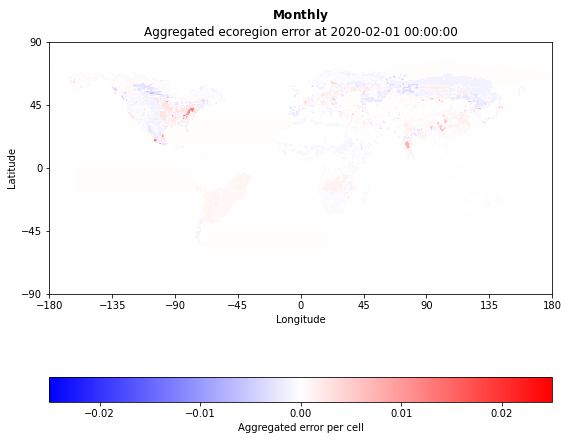

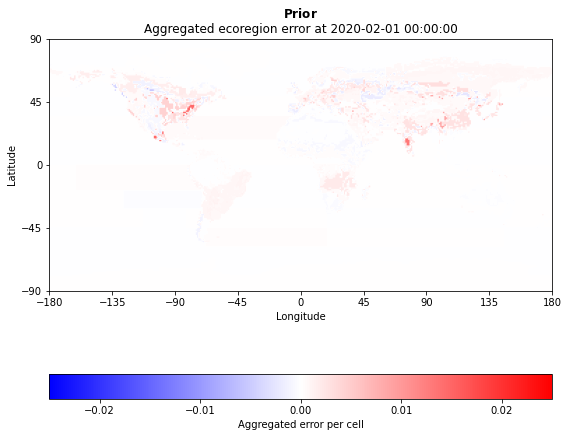

Currently processing date: 2020-02-08 00:00:00


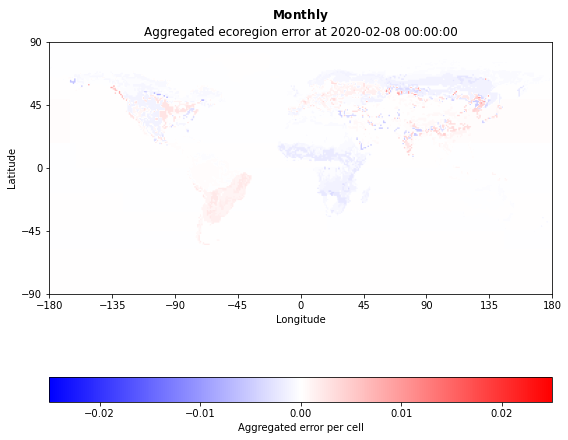

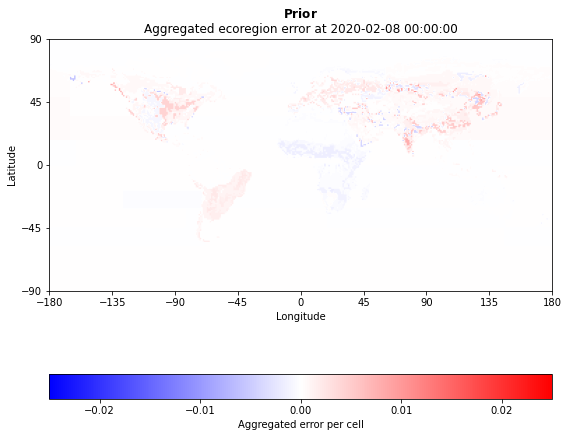

Currently processing date: 2020-02-15 00:00:00


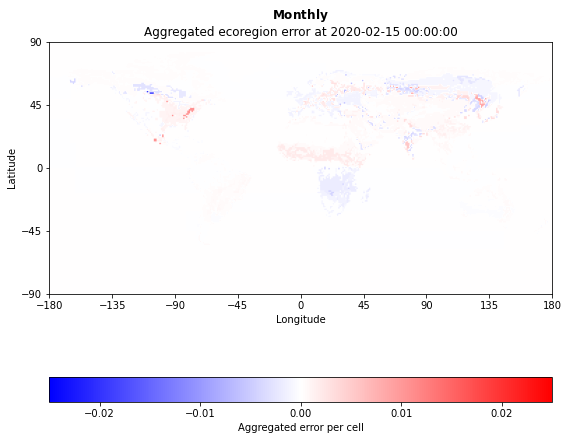

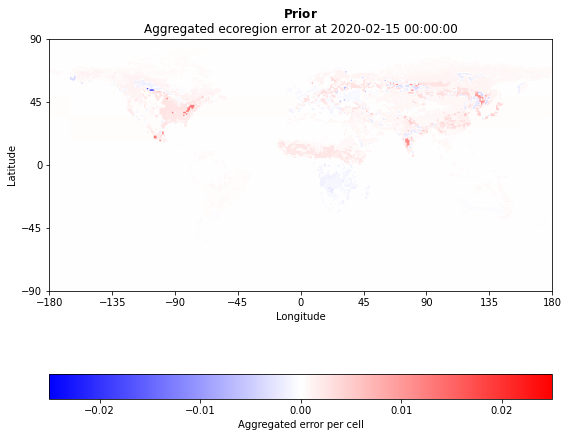

Currently processing date: 2020-02-22 00:00:00


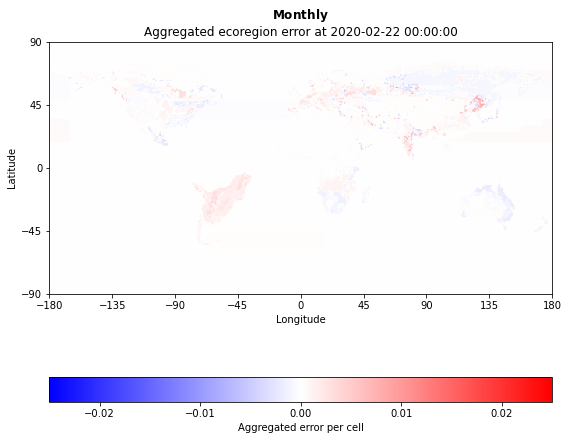

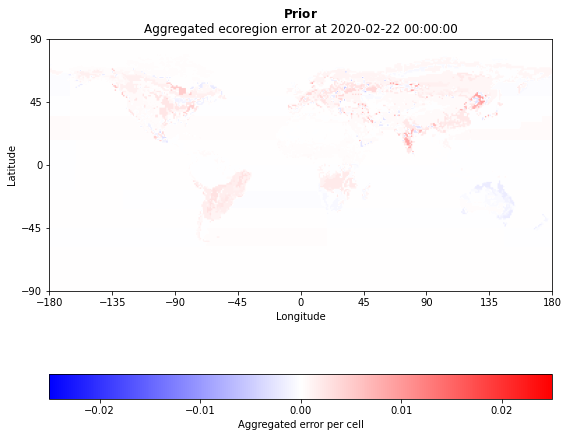

Currently processing date: 2020-02-29 00:00:00


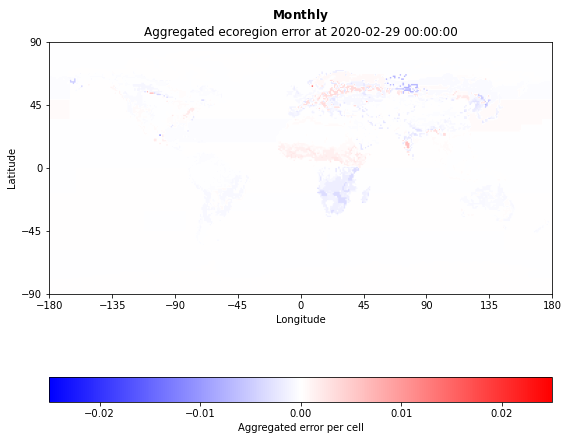

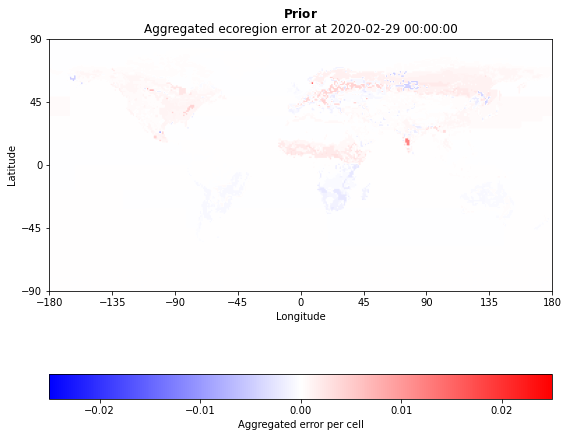

Currently processing date: 2020-03-07 00:00:00


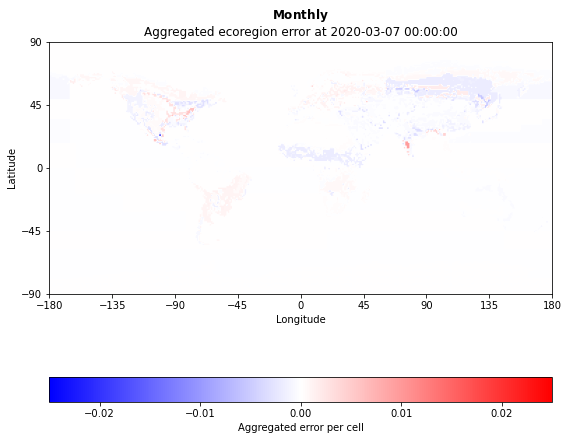

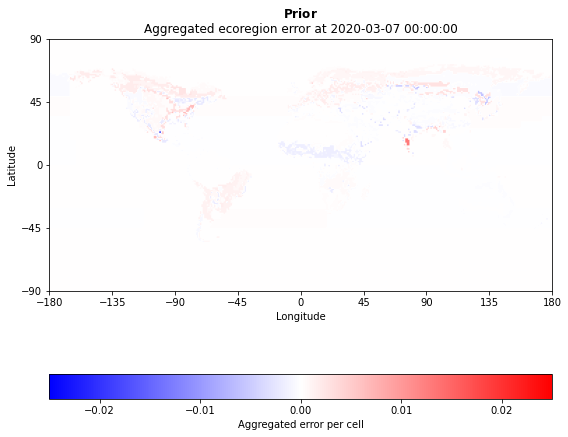

Currently processing date: 2020-03-14 00:00:00


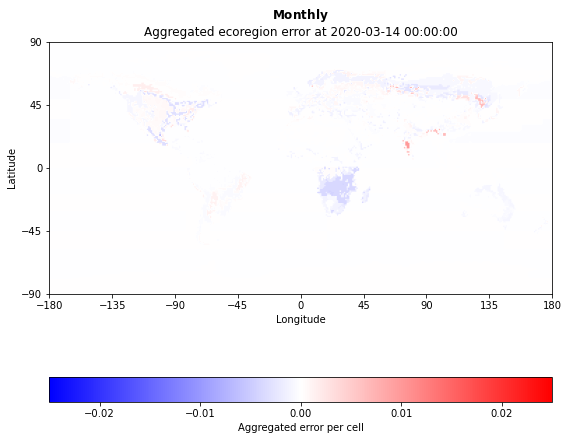

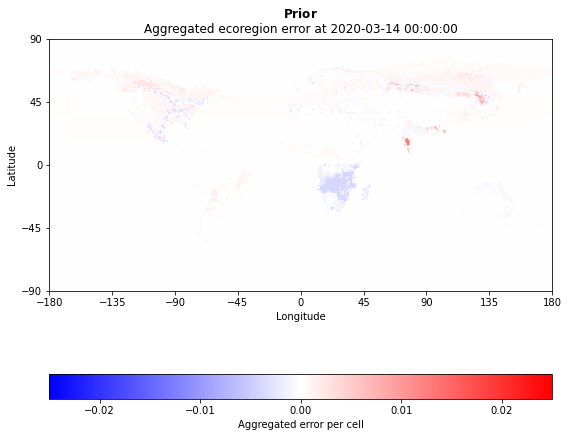

Currently processing date: 2020-03-21 00:00:00


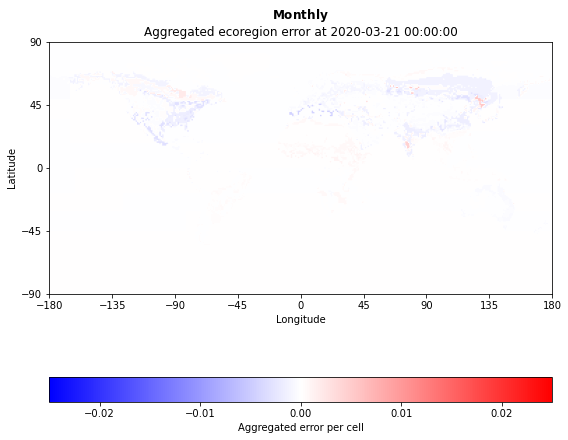

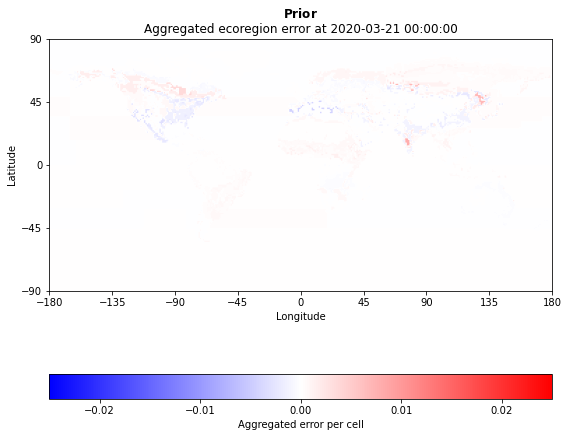

Currently processing date: 2020-03-28 00:00:00


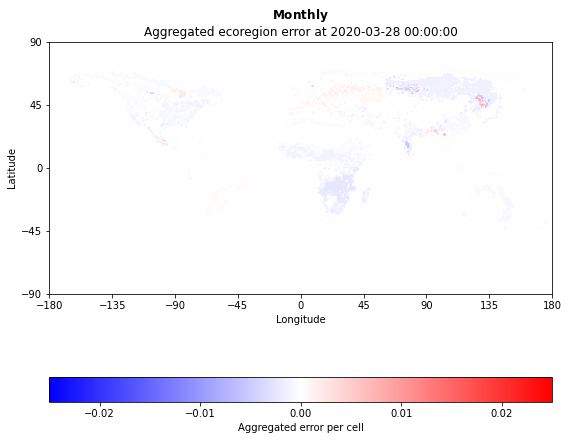

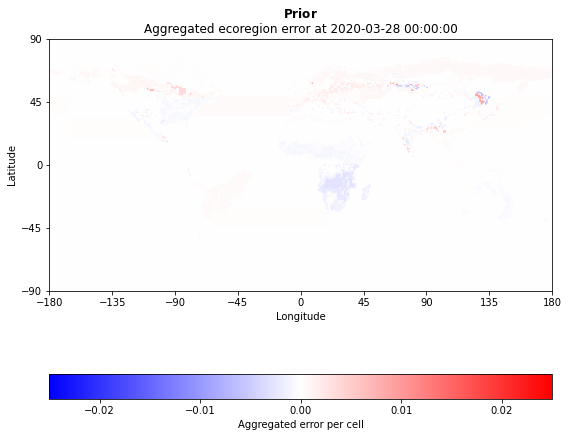

Currently processing date: 2020-04-04 00:00:00


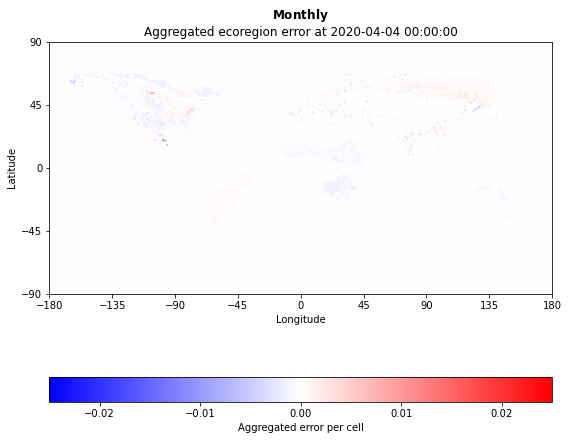

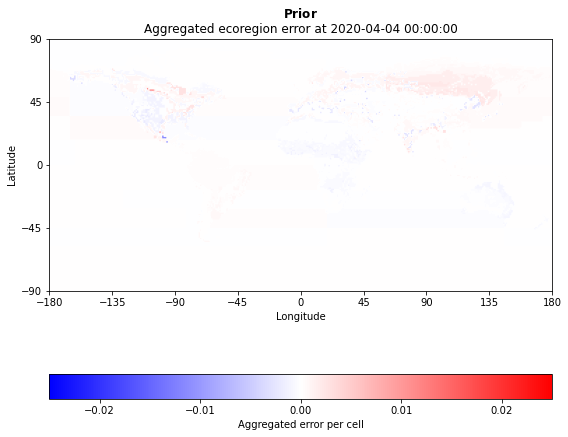

Currently processing date: 2020-04-11 00:00:00


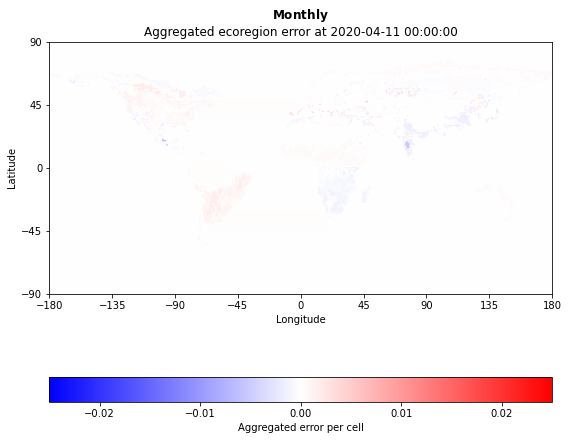

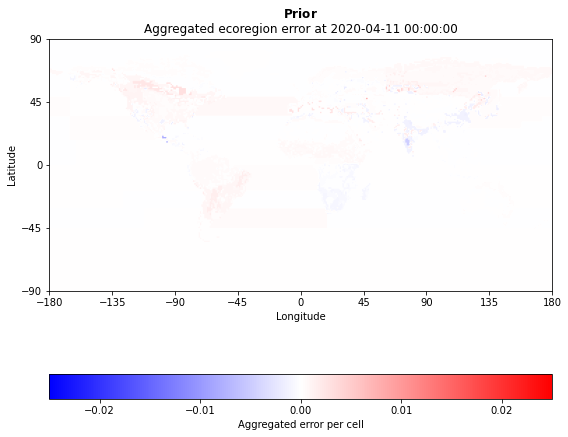

Currently processing date: 2020-04-18 00:00:00


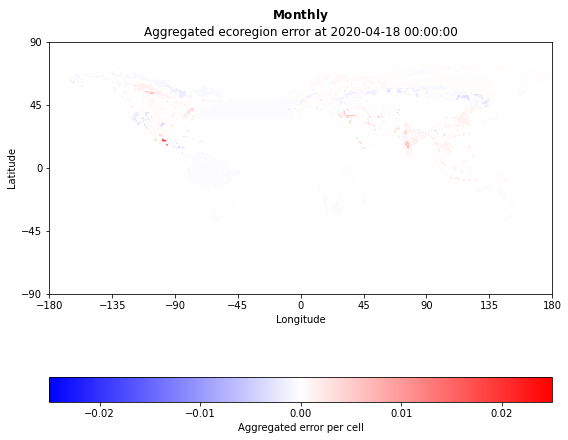

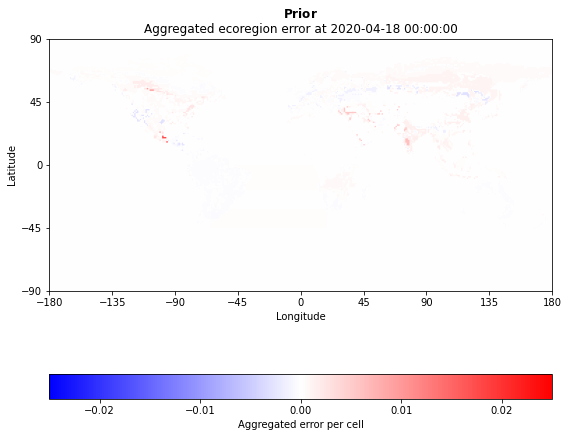

Currently processing date: 2020-04-25 00:00:00


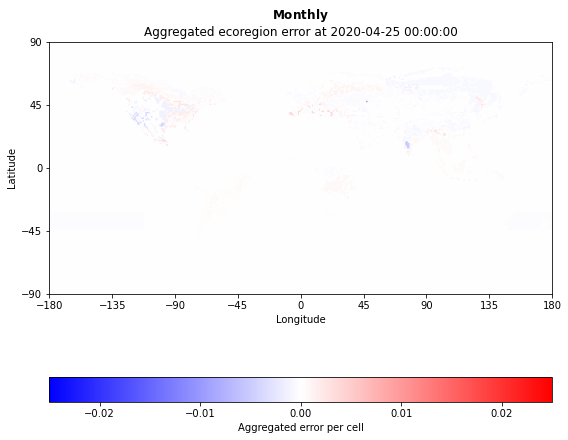

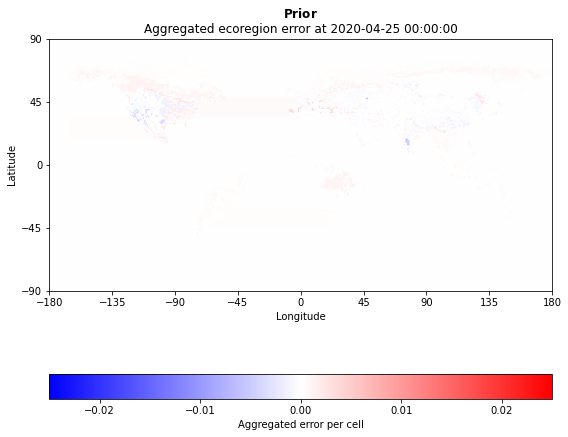

Currently processing date: 2020-05-02 00:00:00


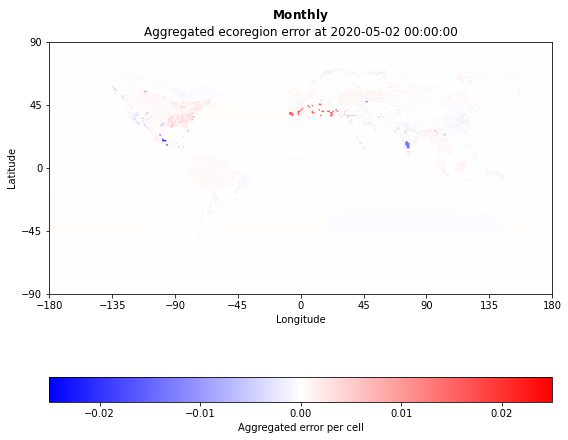

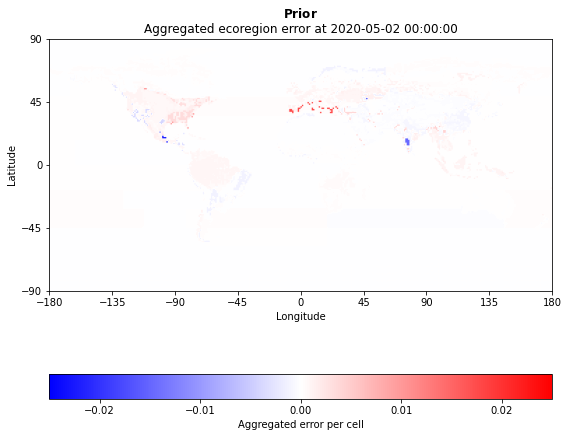

Currently processing date: 2020-05-09 00:00:00


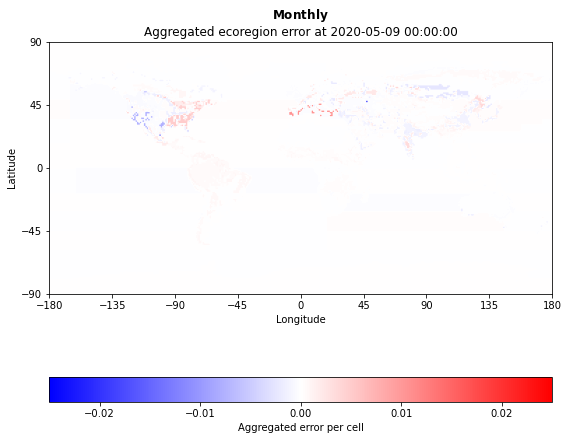

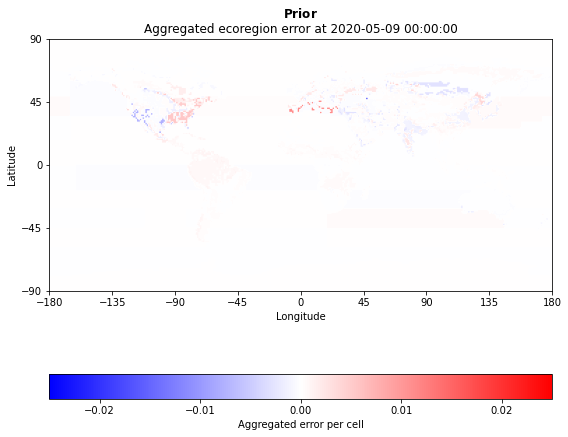

Currently processing date: 2020-05-16 00:00:00


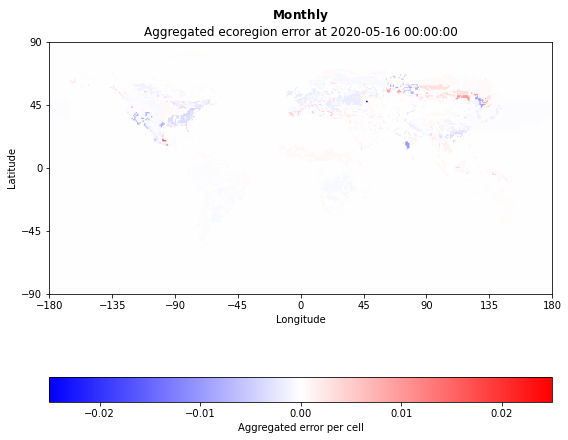

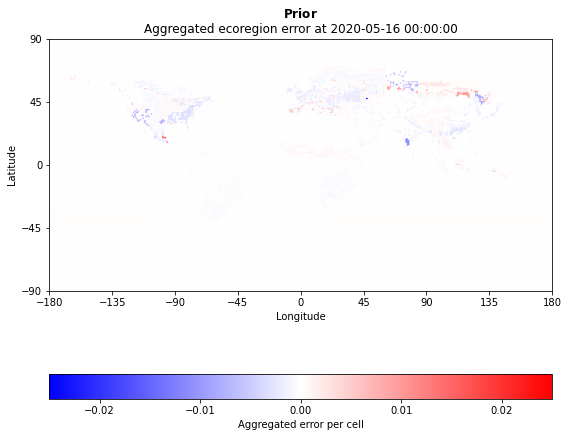

Currently processing date: 2020-05-23 00:00:00


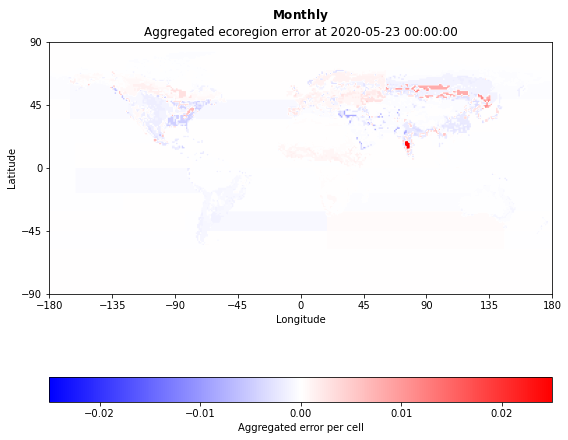

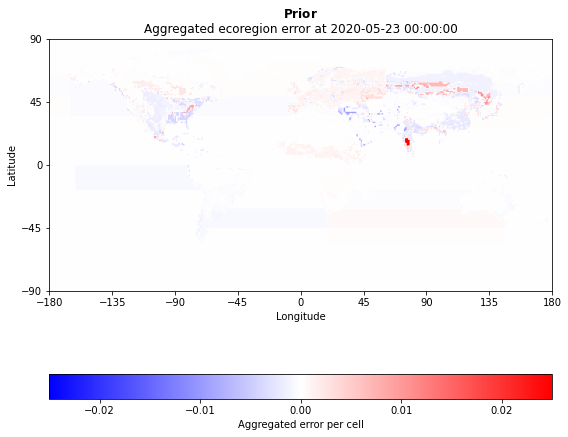

Currently processing date: 2020-05-30 00:00:00


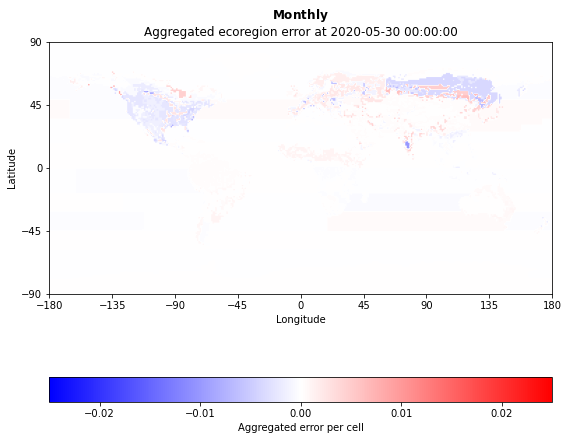

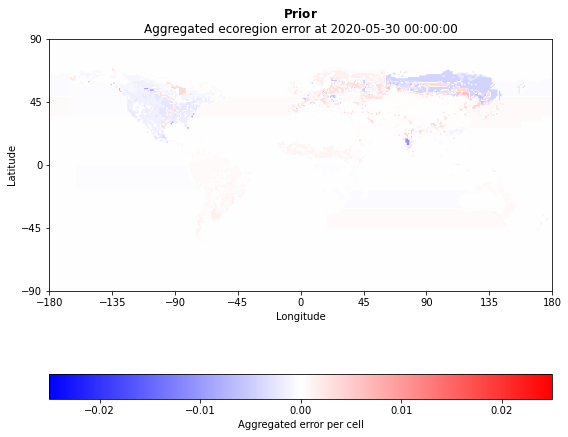

Currently processing date: 2020-06-06 00:00:00


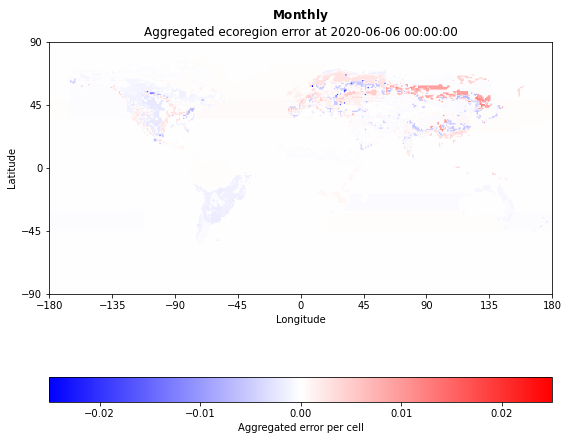

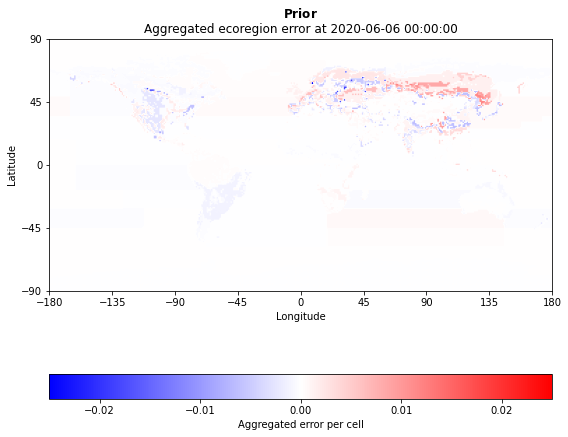

Currently processing date: 2020-06-13 00:00:00


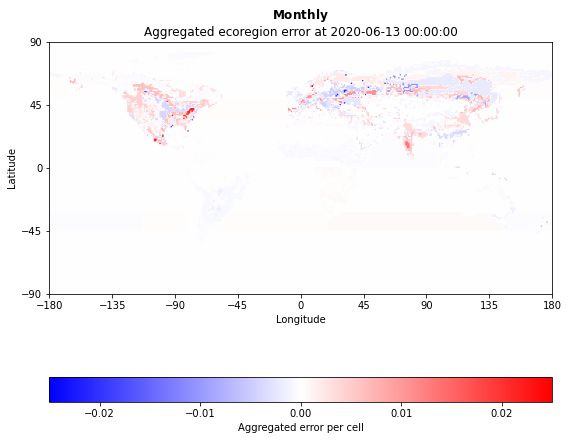

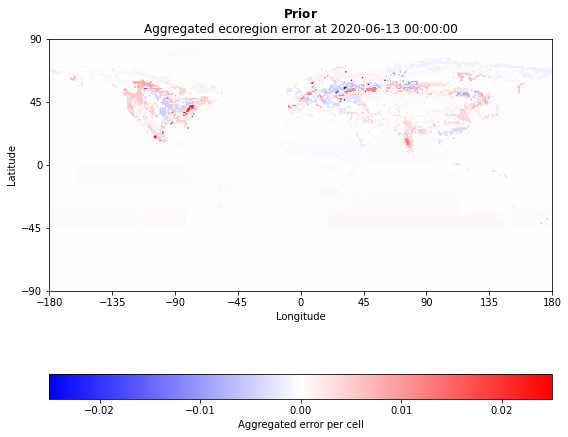

Currently processing date: 2020-06-20 00:00:00


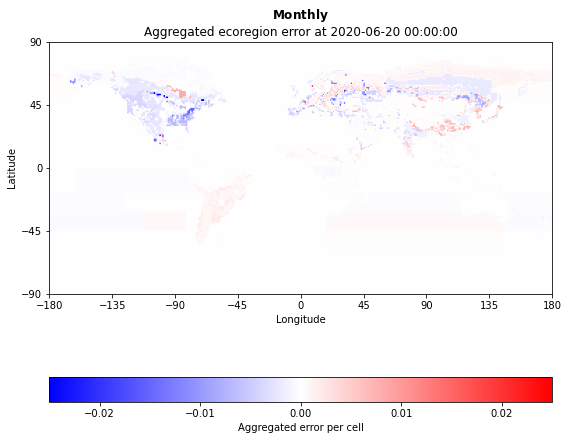

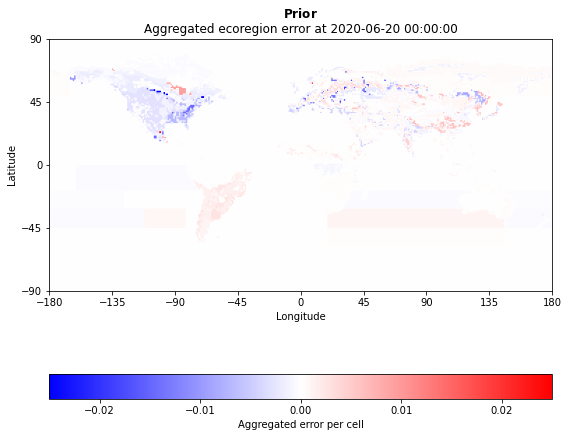

Currently processing date: 2020-06-27 00:00:00


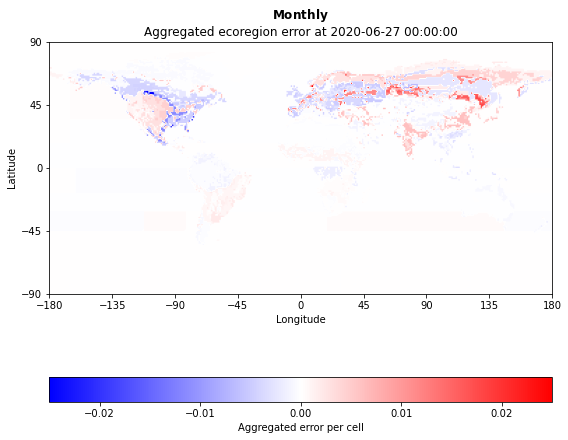

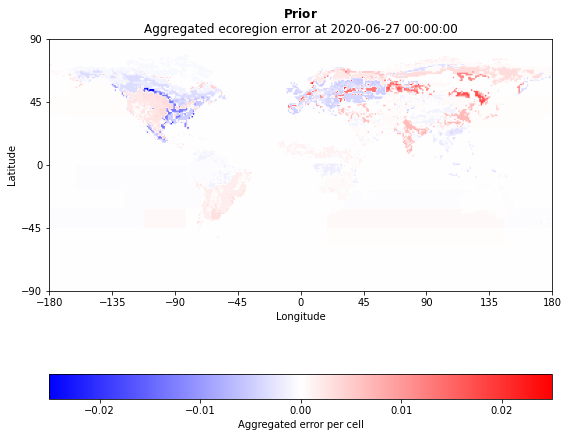

Currently processing date: 2020-07-04 00:00:00


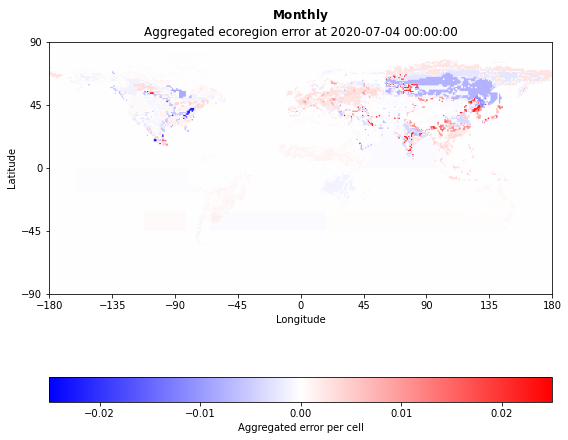

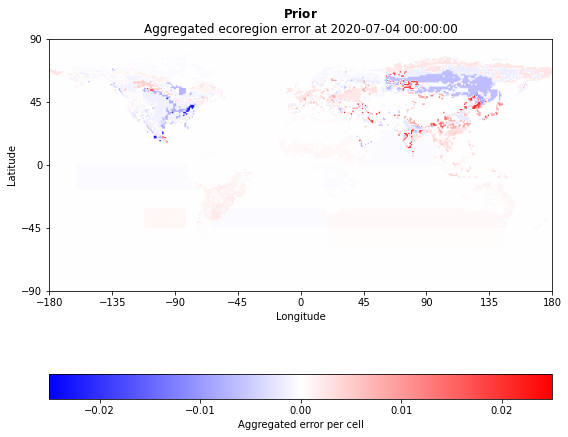

Currently processing date: 2020-07-11 00:00:00


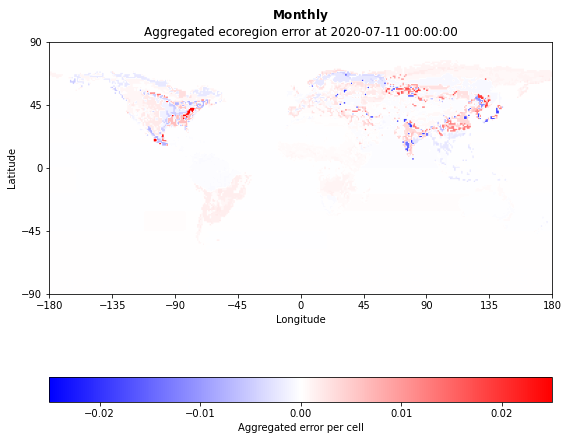

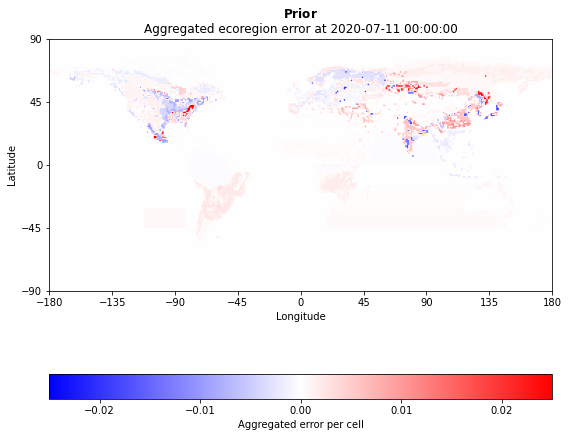

Currently processing date: 2020-07-18 00:00:00


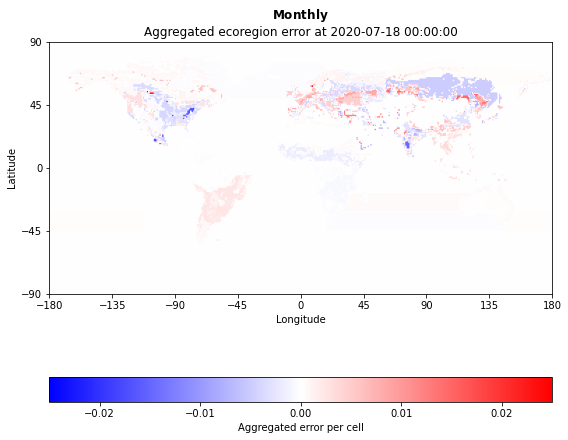

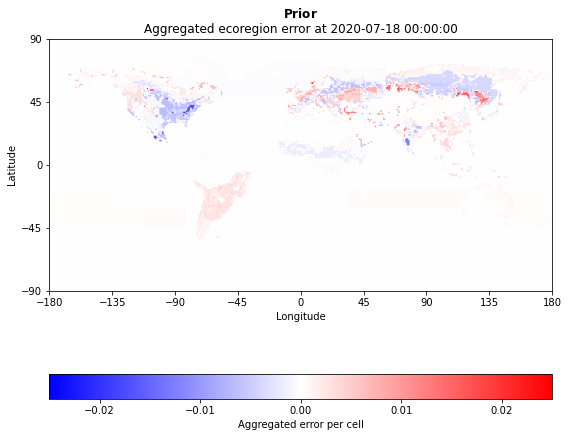

Currently processing date: 2020-07-25 00:00:00


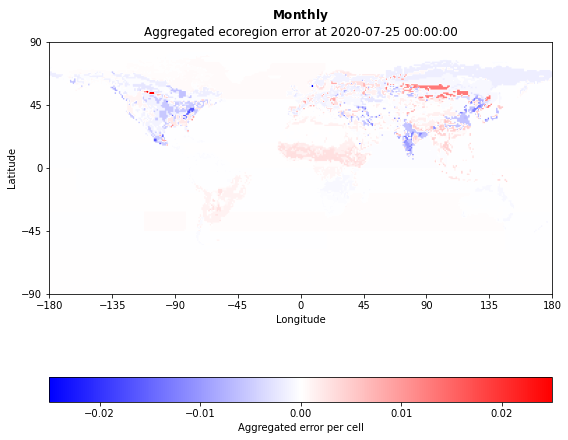

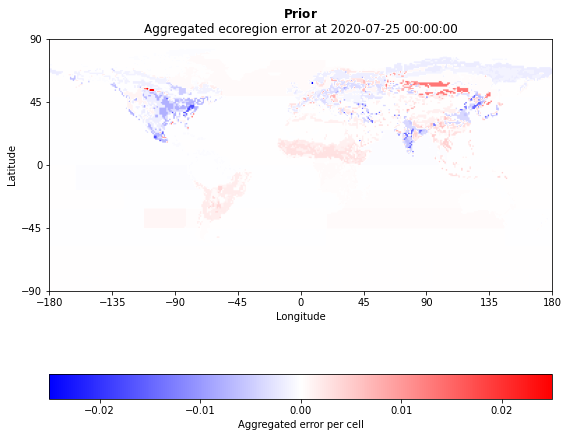

Currently processing date: 2020-08-01 00:00:00


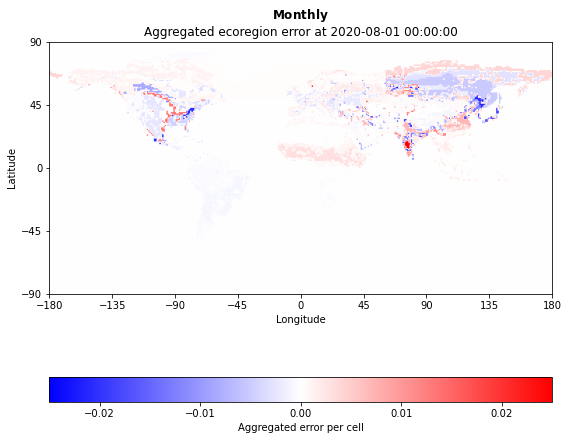

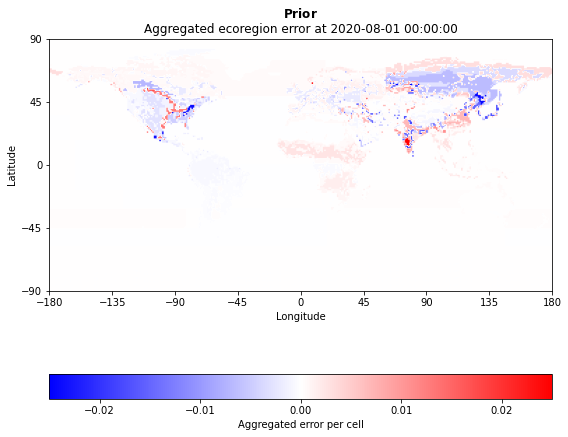

Currently processing date: 2020-08-08 00:00:00


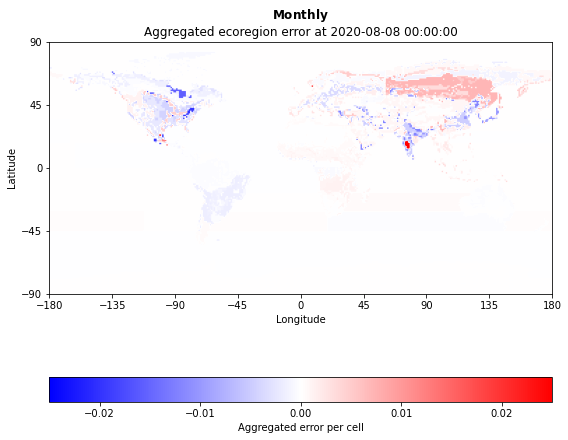

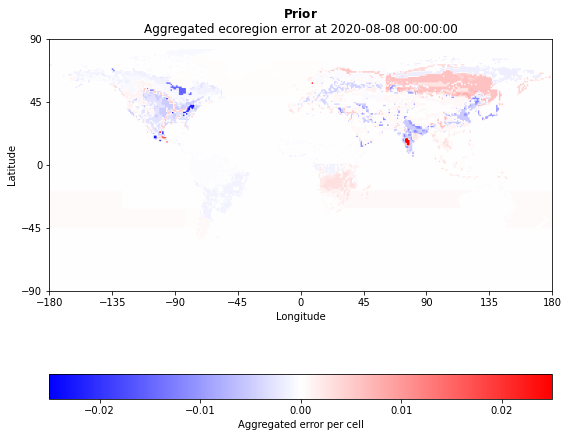

Currently processing date: 2020-08-15 00:00:00


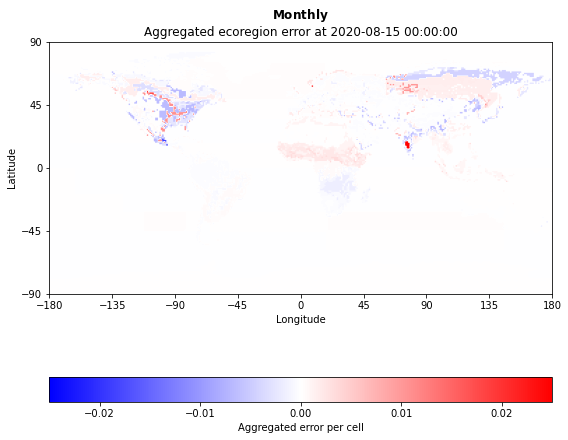

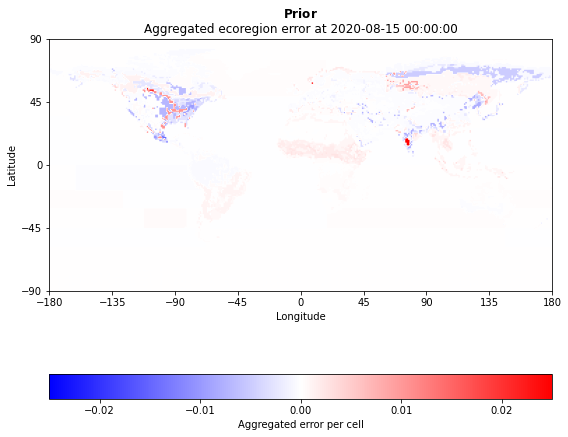

Currently processing date: 2020-08-22 00:00:00


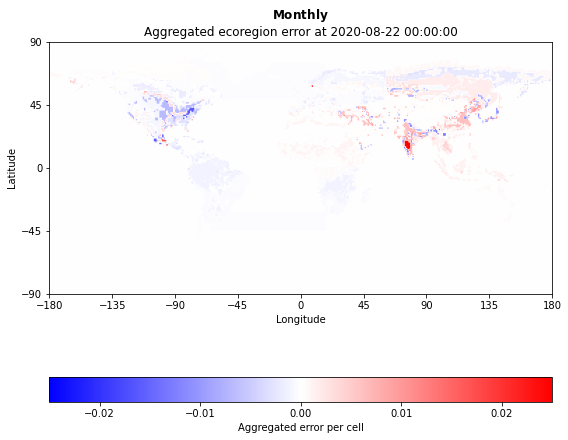

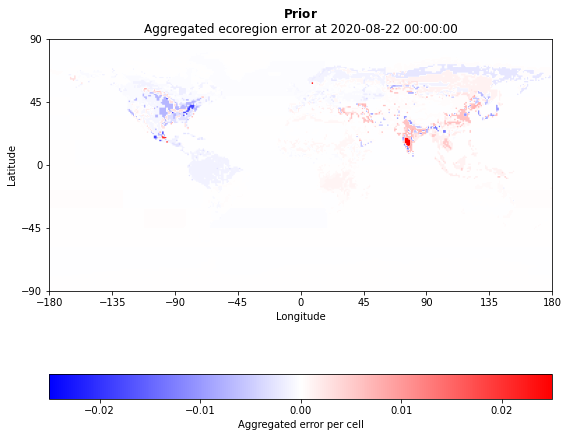

Currently processing date: 2020-08-29 00:00:00


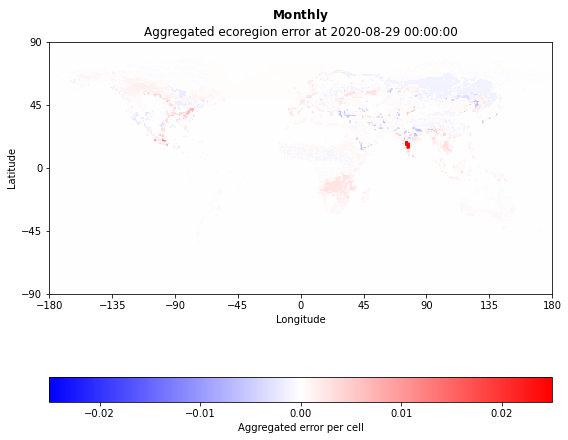

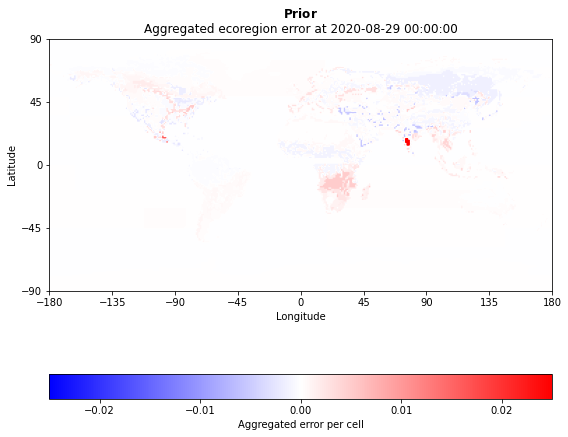

Currently processing date: 2020-09-05 00:00:00


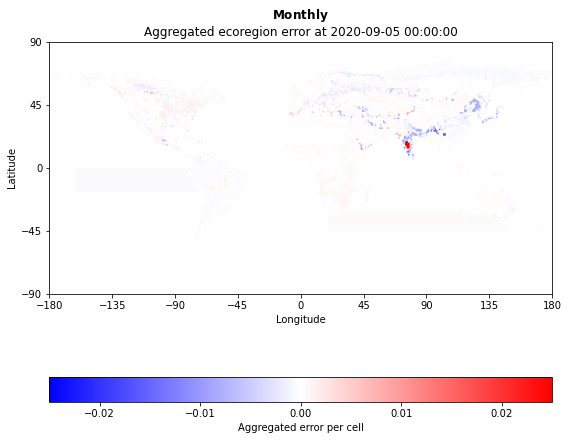

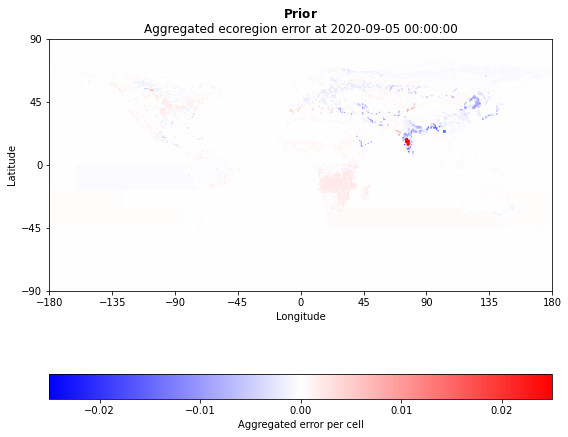

Currently processing date: 2020-09-12 00:00:00


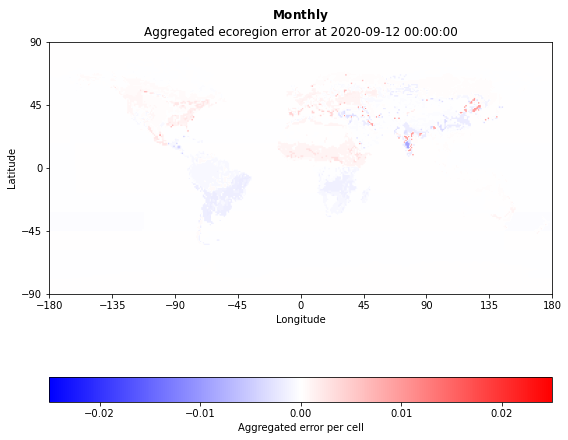

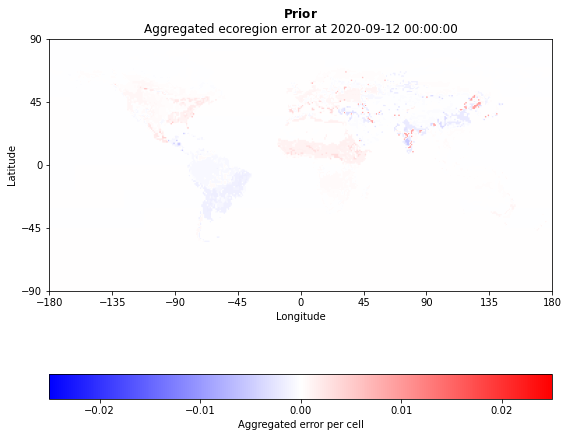

Currently processing date: 2020-09-19 00:00:00


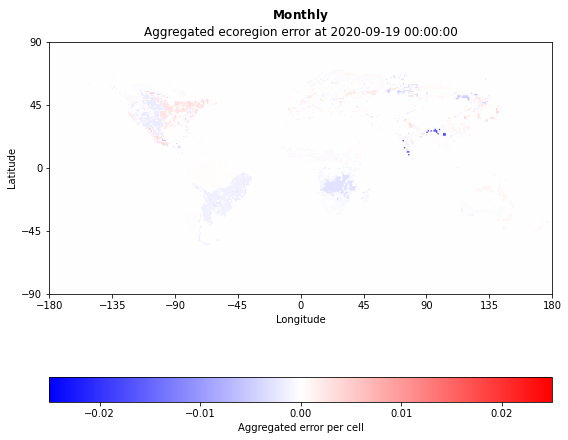

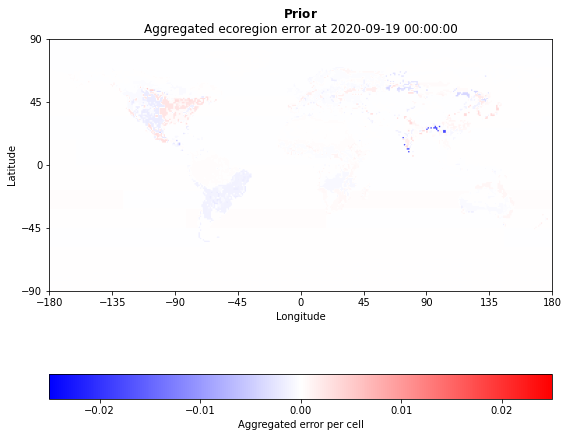

Currently processing date: 2020-09-26 00:00:00


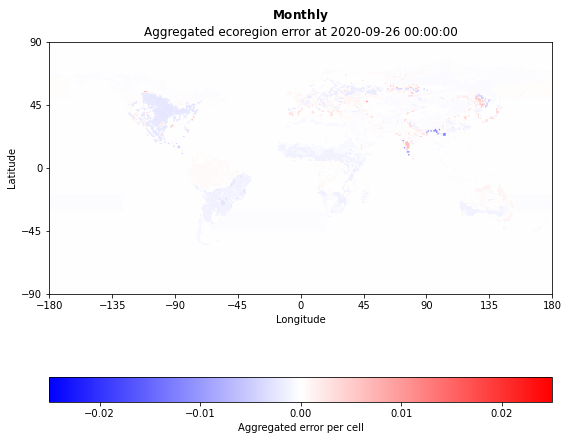

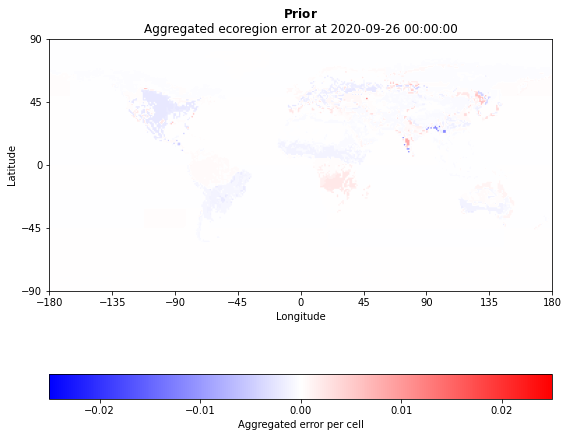

Currently processing date: 2020-10-03 00:00:00


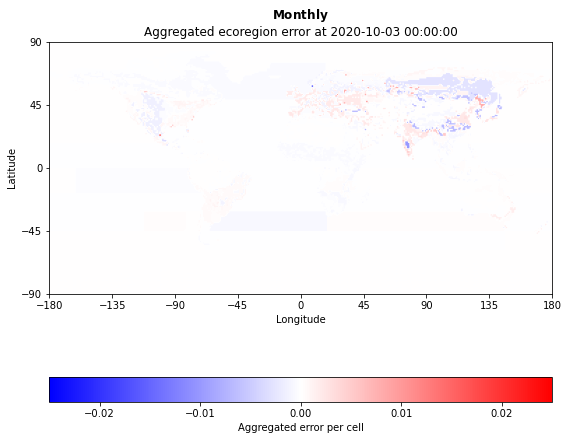

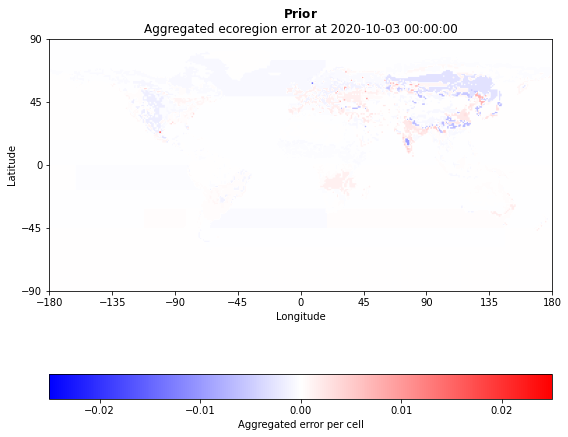

Currently processing date: 2020-10-10 00:00:00


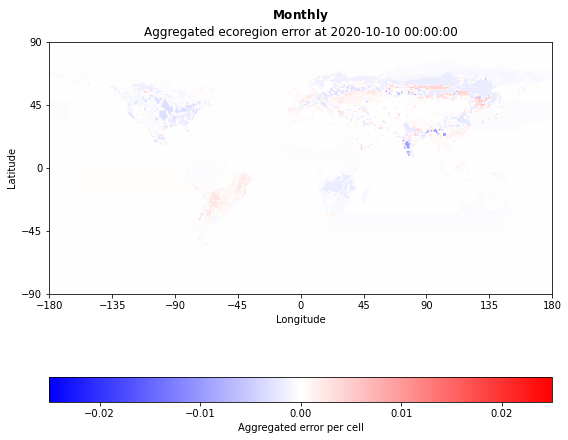

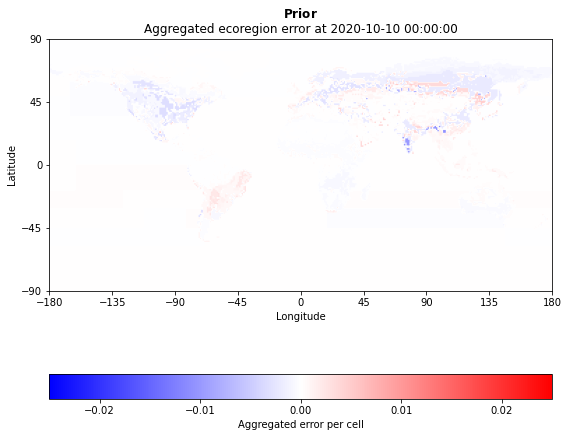

Currently processing date: 2020-10-17 00:00:00


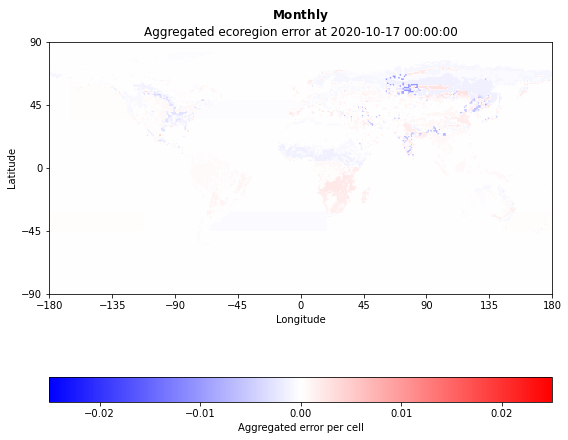

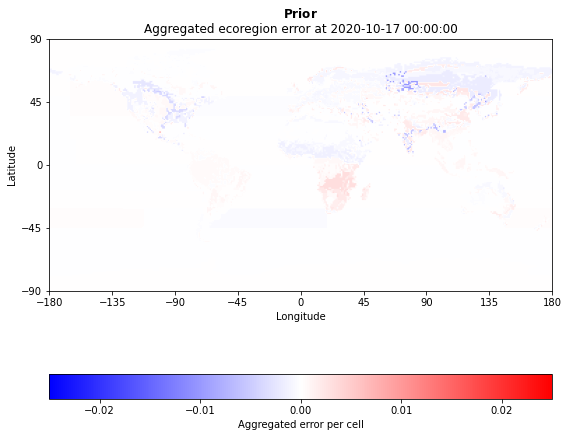

Currently processing date: 2020-10-24 00:00:00


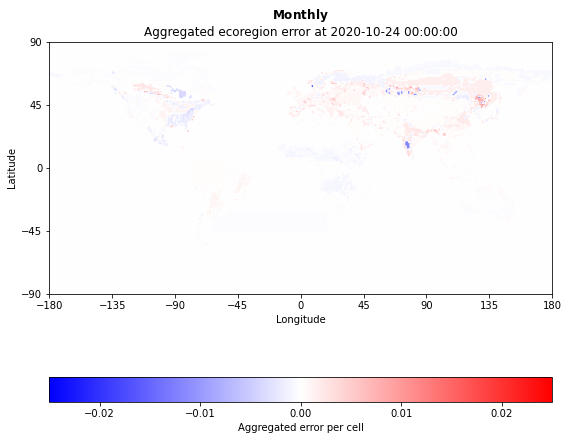

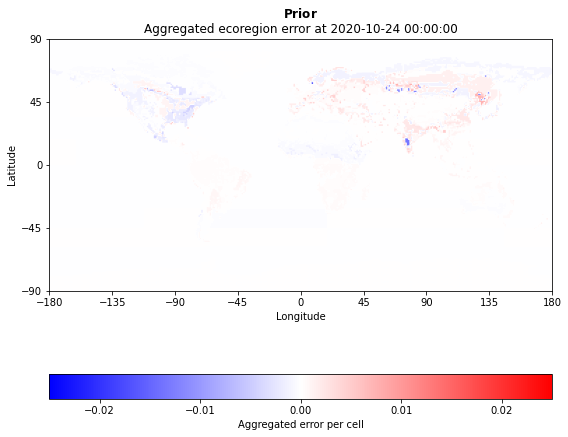

Currently processing date: 2020-10-31 00:00:00


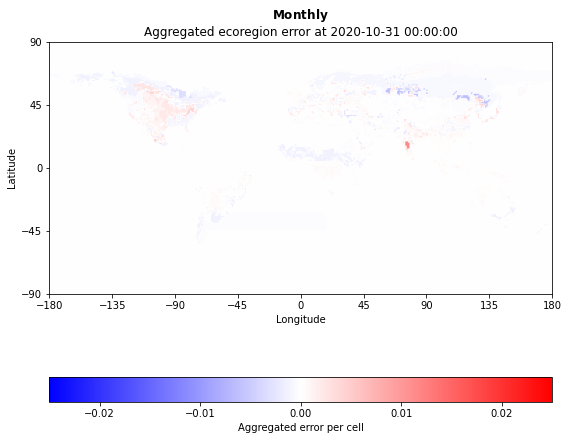

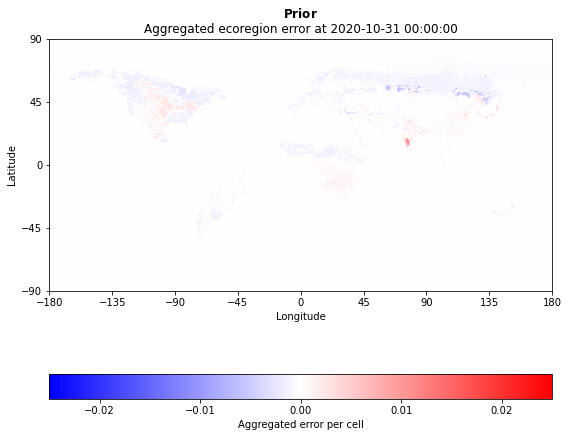

Currently processing date: 2020-11-07 00:00:00


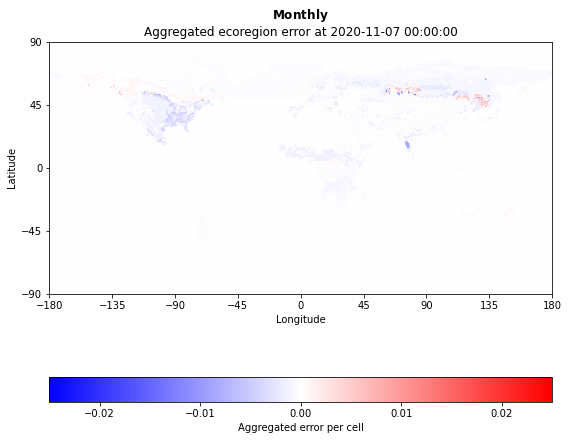

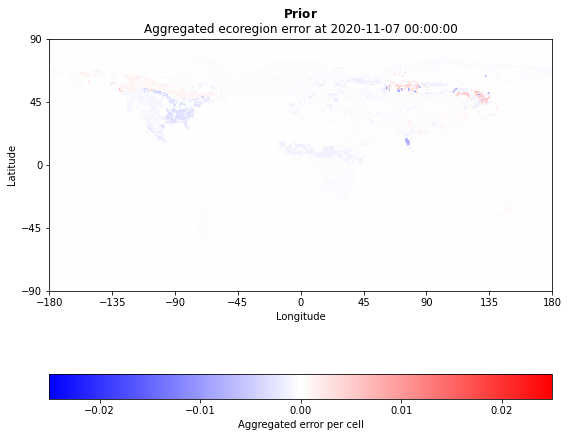

Currently processing date: 2020-11-14 00:00:00


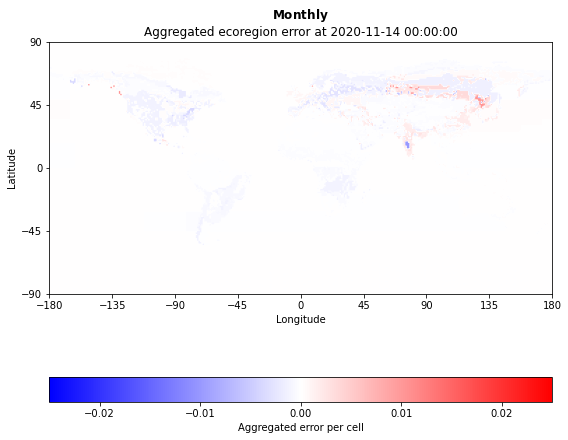

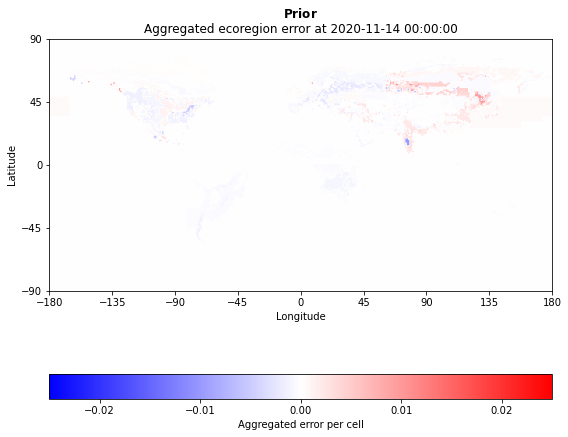

Currently processing date: 2020-11-21 00:00:00


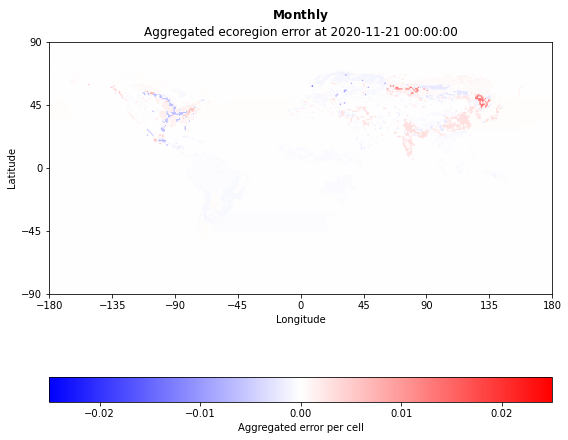

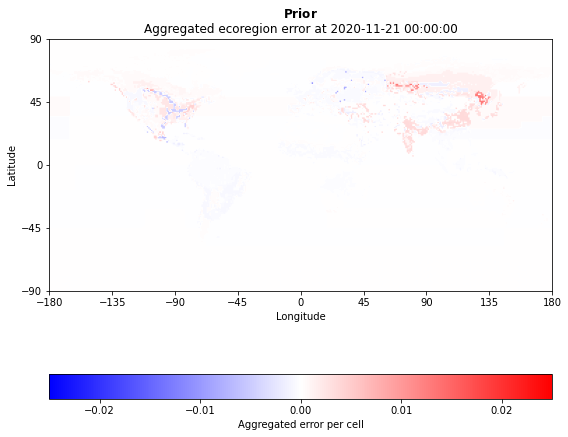

Currently processing date: 2020-11-28 00:00:00


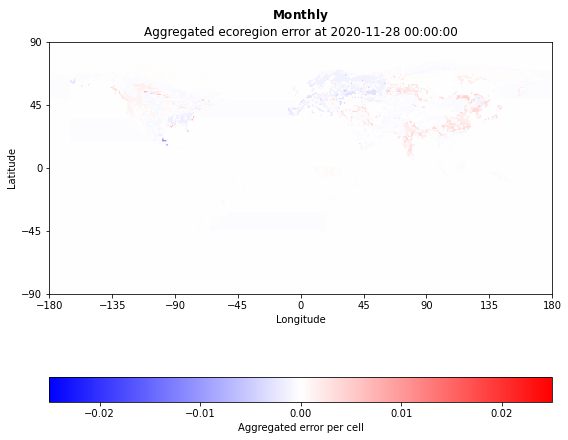

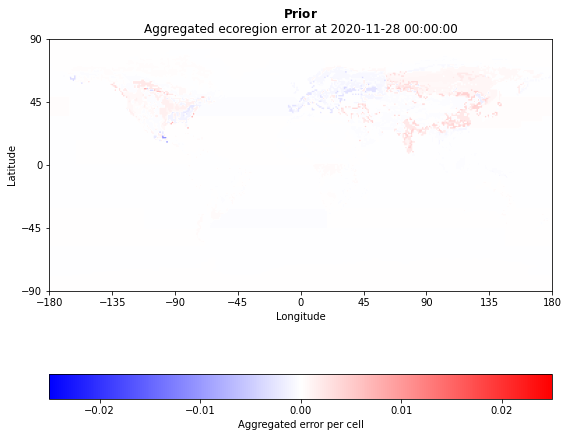

Currently processing date: 2020-12-05 00:00:00


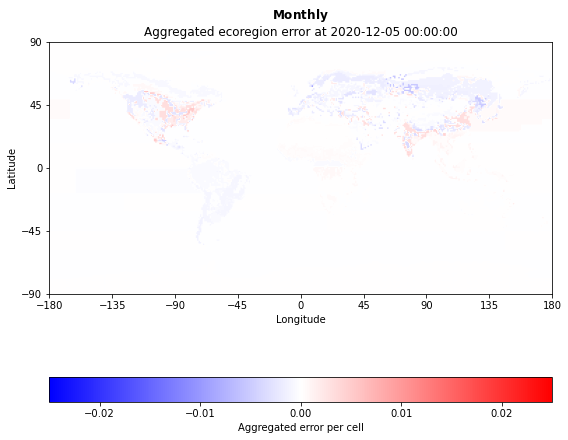

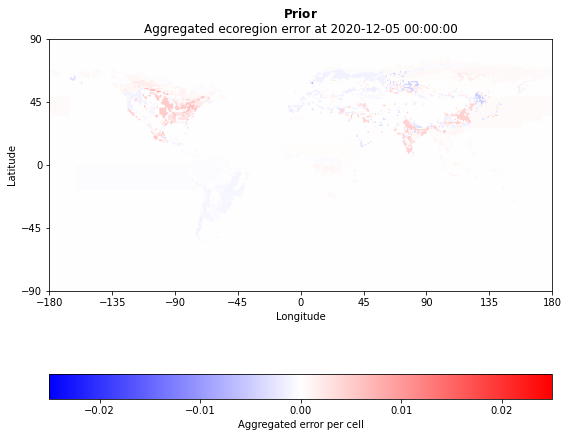

/scratch-local/awoude/ipykernel_1411124/1939074903.py:103: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  square_err_per_week[date] = week_entry


Currently processing date: 2020-12-12 00:00:00


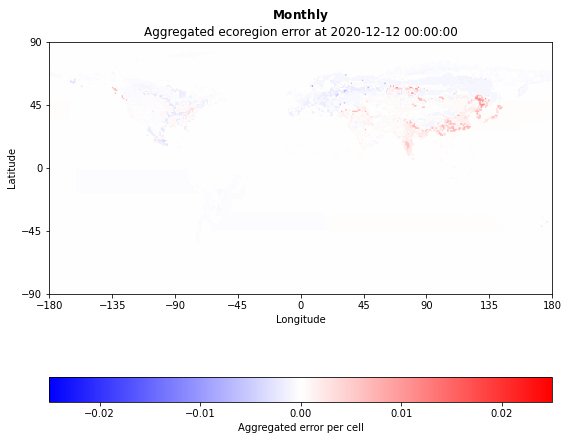

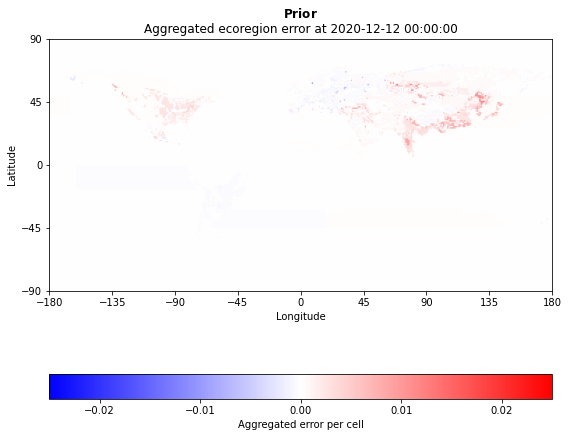

/scratch-local/awoude/ipykernel_1411124/1939074903.py:103: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  square_err_per_week[date] = week_entry


Currently processing date: 2020-12-19 00:00:00


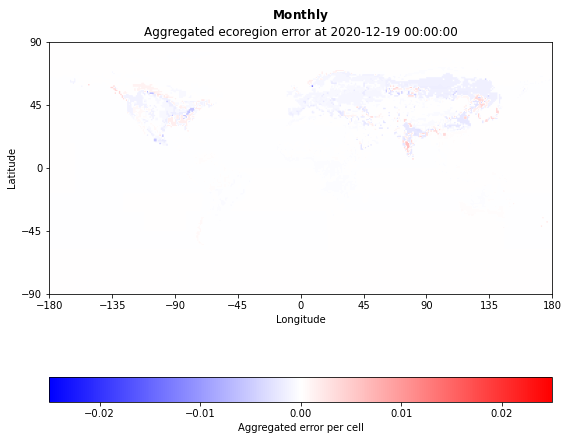

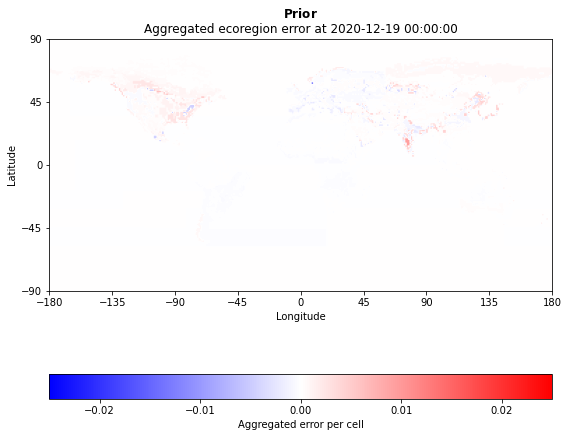

/scratch-local/awoude/ipykernel_1411124/1939074903.py:103: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  square_err_per_week[date] = week_entry


Currently processing date: 2020-12-26 00:00:00


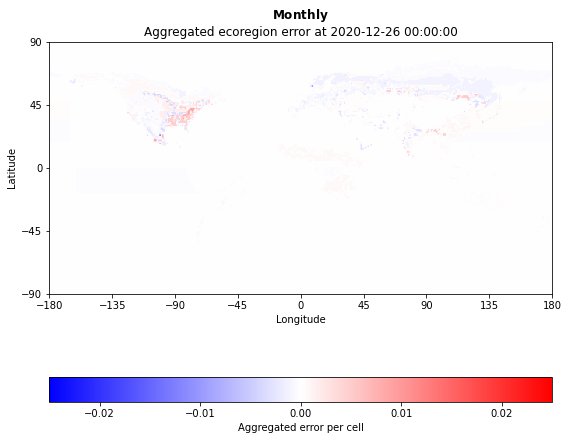

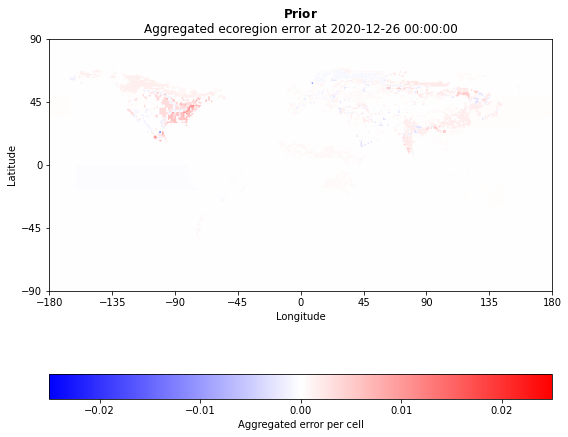

                  N  error^2_monthly_avg  RMSE_monthly_avg  bias_monthly_avg  \
2019-01-05  64800.0             0.128611          0.001409         -0.000022   
2019-01-12  64800.0             0.149407          0.001518          0.000009   
2019-01-19  64800.0             0.148460          0.001514         -0.000073   
2019-01-26  64800.0             0.170573          0.001622         -0.000002   
2019-02-02  64800.0             0.155094          0.001547          0.000009   
...             ...                  ...               ...               ...   
2020-11-28  64800.0             0.110194          0.001304         -0.000024   
2020-12-05  64800.0             0.118686          0.001353         -0.000042   
2020-12-12  64800.0             0.104880          0.001272         -0.000007   
2020-12-19  64800.0             0.098935          0.001236         -0.000046   
2020-12-26  64800.0             0.084976          0.001145         -0.000023   

            error^2_prior  RMSE_prior  

/scratch-local/awoude/ipykernel_1411124/1939074903.py:103: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  square_err_per_week[date] = week_entry


In [64]:
keys = np.array(list(prior_fluxes.keys()))

# Selecting the relevant dates from the list of all dates
dates_2019_2020 = filter_date_by_year(keys, 2019, 2021)

# Calculate the area of the grid cells 
with nc.Dataset(files[1]) as ds:
    area_per_grid_cell = calc_area(ds['lat'][:],ds['lon'][:])

# Store the sum of error^2 over each grid cell
square_err_per_week = pd.DataFrame()
avg_square_err_per_ecoregion_per_week = pd.DataFrame()

# Store the sum of error^2 measured per ecoregion

# Set to true if the images below should be used for making a .gif
create_gif_flag = True
fig_dir = '../figures/aggr_ecoregions_gif/'
file_names_monthly = []
file_names_prior = []

# conversion factor [molC/s] -> [PgC/yr]
fac= 86400.*365.*12./1e15

# For each week, determine the sum(error^2)
for date in dates_2019_2020:
    print(f'Currently processing date: {date}')
    opt_flux = opt_ocean_bio[date]
    total_opt_flux = opt_flux * area_per_grid_cell * fac
                                   
    prior_flux = prior_fluxes[date]
    total_prior_flux = prior_flux * area_per_grid_cell *fac
                                   
    sf = grouped_train.loc[date.month]
    total_flux_estimate = np.zeros((180,360))
    
    # d_ecoregion_flux = 0
    d_ecoregion_flux_montly = np.zeros((180,360))
    d_ecoregion_flux_prior = np.zeros((180,360))
    
    for region, mask in all_regiondict.items():
        masked_flux = total_prior_flux * mask
        scaled_masked_flux = masked_flux * sf[str(region)]
        total_flux_estimate += scaled_masked_flux
        
        masked_opt_flux = total_opt_flux * mask
        d_flux_montly = np.sum(np.subtract(scaled_masked_flux, masked_opt_flux))/np.sum(mask)
        d_flux_prior = np.sum(np.subtract(masked_flux, masked_opt_flux))/np.sum(mask)
        
        
        d_ecoregion_flux_montly += d_flux_montly*mask
        d_ecoregion_flux_prior += d_flux_prior*mask
        
    if create_gif_flag:
        plt.figure(figsize = (8,8))
        plt.imshow(d_ecoregion_flux_montly, origin='lower', extent=[-180, 180, -90, 90], vmin=-0.025, vmax =0.025, cmap='bwr')
        plt.title(r'$\bfMonthly}$' + "\nAggregated ecoregion error at " + str(date))
        plt.xlabel('Longitude')
        plt.xticks(np.arange(-180, 181, 45))
        plt.ylabel('Latitude')
        plt.yticks(np.arange(-90, 91, 45))
        cbar = plt.colorbar(orientation="horizontal")
        cbar.set_label('Aggregated error per cell')
        # plt.clim(-0.05, 0.05)
        file_name = fig_dir + 'monthly/' + str(date.year)+str(date.month)+str(date.day) + '.png'
        file_names_monthly.extend([file_name]*5)
        plt.tight_layout()
        plt.savefig(file_name)
        plt.show()
        
        plt.figure(figsize = (8,8))
        plt.imshow(d_ecoregion_flux_prior, origin='lower', extent=[-180, 180, -90, 90], vmin=-0.025, vmax =0.025, cmap='bwr')
        plt.title(r'$\bfPrior}$' + "\nAggregated ecoregion error at " + str(date))
        plt.xlabel('Longitude')
        plt.xticks(np.arange(-180, 181, 45))
        plt.ylabel('Latitude')
        plt.yticks(np.arange(-90, 91, 45))
        cbar = plt.colorbar(orientation="horizontal")
        cbar.set_label('Aggregated error per cell')
        # plt.clim(-0.05, 0.05)
        file_name = fig_dir +  'prior/' +str(date.year)+str(date.month)+str(date.day) + '.png'
        file_names_prior.extend([file_name]*5)
        plt.tight_layout()
        plt.savefig(file_name)
        plt.show()
        
        
    error_monthly_avg = np.subtract(total_flux_estimate, total_opt_flux)
    error_prior = np.subtract(total_prior_flux, total_opt_flux)
      
    
    size = len(error_prior)*len(error_prior[0])
    
    week_entry = pd.Series(dtype='float64')
    week_entry['N'] = size
    week_entry['error^2_monthly_avg'] = np.sum(error_monthly_avg * error_monthly_avg)
    week_entry['RMSE_monthly_avg'] = np.sqrt(week_entry['error^2_monthly_avg']/size)
    week_entry['bias_monthly_avg'] = np.sum(error_monthly_avg)/size
    week_entry['error^2_prior'] = np.sum(error_prior*error_prior)
    week_entry['RMSE_prior'] = np.sqrt(week_entry['error^2_prior']/size)
    week_entry['bias_prior'] = np.sum(error_prior)/size
    
    square_err_per_week[date] = week_entry
    
#     plt.imshow(d_ecoregion_flux_montly, origin='lower')
#     plt.colorbar()
#     plt.show()
    
#     plt.imshow(d_ecoregion_flux_prior, origin='lower')
#     plt.colorbar()
#     plt.show()
    
#     eco_entry = pd.Series(dtype='float64')
#     eco_entry['N'] = size
#     eco_entry['error^2_aggregated_eco_monthly_avg'] = sum_sqr_d_ecoregion_flux_montly
#     eco_entry['RMSE_aggregated_eco_monthly_avg'] = np.sqrt(sum_sqr_d_ecoregion_flux_montly/size)
#     eco_entry['error^2_aggregated_eco_prior'] = sum_sqr_d_ecoregion_flux_prior
#     eco_entry['RMSE_aggregated_eco_prior'] = np.sqrt(sum_sqr_d_ecoregion_flux_prior/size)
    
    
#     avg_square_err_per_ecoregion_per_week[date] = eco_entry
    
square_err_per_week = square_err_per_week.T
square_err_per_week = square_err_per_week.copy()

avg_square_err_per_ecoregion_per_week = avg_square_err_per_ecoregion_per_week.T
avg_square_err_per_ecoregion_per_week = avg_square_err_per_ecoregion_per_week.copy()

print(square_err_per_week)
        



In [18]:
print(file_names_monthly)

['../figures/aggr_ecoregions_gif/201915_monthly.png', '../figures/aggr_ecoregions_gif/2019112_monthly.png', '../figures/aggr_ecoregions_gif/2019119_monthly.png', '../figures/aggr_ecoregions_gif/2019126_monthly.png', '../figures/aggr_ecoregions_gif/201922_monthly.png', '../figures/aggr_ecoregions_gif/201929_monthly.png', '../figures/aggr_ecoregions_gif/2019216_monthly.png', '../figures/aggr_ecoregions_gif/2019223_monthly.png', '../figures/aggr_ecoregions_gif/201932_monthly.png', '../figures/aggr_ecoregions_gif/201939_monthly.png', '../figures/aggr_ecoregions_gif/2019316_monthly.png', '../figures/aggr_ecoregions_gif/2019323_monthly.png', '../figures/aggr_ecoregions_gif/2019330_monthly.png', '../figures/aggr_ecoregions_gif/201946_monthly.png', '../figures/aggr_ecoregions_gif/2019413_monthly.png', '../figures/aggr_ecoregions_gif/2019420_monthly.png', '../figures/aggr_ecoregions_gif/2019427_monthly.png', '../figures/aggr_ecoregions_gif/201954_monthly.png', '../figures/aggr_ecoregions_gif/20

In [79]:
totals = square_err_per_week.groupby(square_err_per_week.index.year).sum()
aggr_totals = avg_square_err_per_ecoregion_per_week.groupby(avg_square_err_per_ecoregion_per_week.index.year).sum()
print(totals)

#print('\nAnalysis of using monthly average lambda:')
print('\nRMSE of non-aggregated error:')
# print('\nAnalysis of directly using prior:')
print(f"Prior: \n{np.sqrt(totals['error^2_prior'] / totals['N'])}\n")
# print(f"Bias: \n{totals['bias_prior']}\n")


print(f"Monthly: \n{np.sqrt(totals['error^2_monthly_avg'] / totals['N'])}\n")
# print(f"Bias: \n{totals['bias_monthly_avg']}\n")




print('\nRMSE of aggregating error over ecoregions:')
print(f"Prior: \n{np.sqrt(aggr_totals['error^2_aggregated_eco_prior'] / aggr_totals['N'])}\n")
print(f"Monthly average: \n{np.sqrt(aggr_totals['error^2_aggregated_eco_monthly_avg'] / aggr_totals['N'])}\n")

              N  error^2_monthly_avg  RMSE_monthly_avg  bias_monthly_avg  \
2019  3369600.0            17.954799          0.108928          0.000256   
2020  3369600.0            16.246980          0.101456         -0.000289   

      error^2_prior  RMSE_prior  bias_prior  
2019      18.157514    0.109804    0.002794  
2020      16.417628    0.102308    0.002204  

RMSE of non-aggregated error:
Prior: 
2019    0.002321
2020    0.002207
dtype: float64

Monthly: 
2019    0.002308
2020    0.002196
dtype: float64


RMSE of aggregating error over ecoregions:
Prior: 
2019    0.000917
2020    0.000845
dtype: float64

Monthly average: 
2019    0.000892
2020    0.000826
dtype: float64



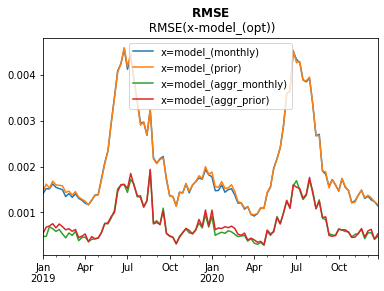

In [72]:
square_err_per_week['RMSE_monthly_avg'].plot(label='x=model_(monthly)')
square_err_per_week['RMSE_prior'].plot(label='x=model_(prior)')
avg_square_err_per_ecoregion_per_week['RMSE_aggregated_eco_monthly_avg'].plot(label='x=model_(aggr_monthly)')
avg_square_err_per_ecoregion_per_week['RMSE_aggregated_eco_prior'].plot(label='x=model_(aggr_prior)')
plt.title(r'$\bf{RMSE}$'+'\n RMSE(x-model_(opt))')
plt.legend()

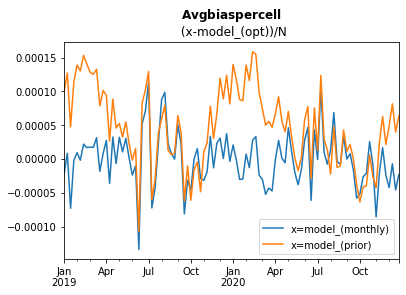

In [74]:
square_err_per_week['bias_monthly_avg'].plot(label='x=model_(monthly)')
square_err_per_week['bias_prior'].plot(label='x=model_(prior)')
plt.title(r'$\bfAvg bias per cell}$'+'\n (x-model_(opt))/N')
plt.legend()

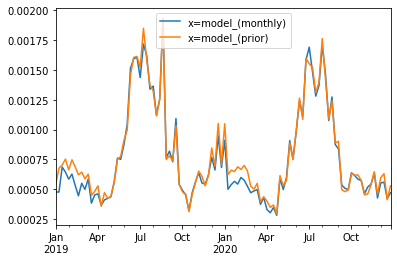

In [70]:
avg_square_err_per_ecoregion_per_week['RMSE_aggregated_eco_monthly_avg'].plot(label='x=model_(monthly)')
avg_square_err_per_ecoregion_per_week['RMSE_aggregated_eco_prior'].plot(label='x=model_(prior)')
plt.legend()

In [84]:
pd.set_option('display.max_rows', None)
print(square_err_per_week[['bias_monthly_avg', 'RMSE_montly_avg', 'bias_prior', 'RMSE_prior']])
pd.set_option('display.max_rows', 11)

            bias_monthly_avg  RMSE_montly_avg    bias_prior    RMSE_prior
2019-01-05     -3.824027e+06      3722.753658  1.698512e+07   3825.940454
2019-01-12      1.458770e+06      4012.450230  2.176373e+07   4274.423111
2019-01-19     -1.248285e+07      3999.714694  8.102731e+06   4045.159382
2019-01-26     -3.199709e+05      4287.255153  1.953065e+07   4446.260697
2019-02-02      1.598701e+06      4088.104264  2.380352e+07   4225.575656
2019-02-09     -3.147309e+05      4016.609196  2.229484e+07   4204.341098
2019-02-16      3.764551e+06      3947.632568  2.624376e+07   4177.059073
2019-02-23      2.868713e+06      3555.784770  2.404049e+07   3795.943631
2019-03-02      3.018852e+06      3727.752598  2.197248e+07   3868.170525
2019-03-09      2.936209e+06      3512.917893  2.142682e+07   3649.454554
2019-03-16      5.379202e+06      3712.559533  2.273081e+07   3838.114352
2019-03-23     -3.117828e+06      3455.573046  1.344201e+07   3522.205773
2019-03-30      1.313288e+06      3342

In [35]:
total = 0

# Calculate the area of the grid cells 
with nc.Dataset(files[1]) as ds:
    area_per_grid_cell = calc_area(ds['lat'][:],ds['lon'][:])


for f in files[0:52]:
    date = extract_date(f)
    with nc.Dataset(f) as ds:
        total_weekly_ff = np.sum(ds['flux_ff_prior_mean'] * area_per_grid_cell)*86400*365*12/1e15
        total += total_weekly_ff
print(f'\n total yearly ff: {total/52} [g/year]')


 total yearly ff: 6.85577273981021 [g/year]


In [28]:
for f in files[0:1]:
    date = extract_date(f)
    with nc.Dataset(f) as ds:
        print(ds['flux_ff_prior_mean'])

<class 'netCDF4._netCDF4.Variable'>
float32 flux_ff_prior_mean(lat, lon)
    units: mol m-2 s-1
    flux_ff_prior_n: 168
unlimited dimensions: 
current shape = (180, 360)
filling on, default _FillValue of 9.969209968386869e+36 used


# Below are code snippets which might come in handy at some point, but currently serve no purpose

## Creating a gif of global pictures

In [ ]:
keys = np.array(list(prior_fluxes.keys()))

# Selecting the relevant dates from the list of all dates
dates_2019_2020 = filter_date_by_year(keys, 2019, 2021)

# Calculate the area of the grid cells 
with nc.Dataset(files[1]) as ds:
    area_per_grid_cell = calc_area(ds['lat'][:],ds['lon'][:])

# Store the sum of error^2 over each grid cell
square_err_per_week = pd.DataFrame()

# Set to true if the images below should be used for making a .gif
create_gif_flag = False
fig_dir = '../figures/ecoregions_gif/'
file_names = []


# For each week, determine the sum(error^2)
for date in dates_2019_2020:
    opt_flux = opt_ocean_bio[date]
                                   
    prior_flux = prior_fluxes[date]
    total_prior_flux = prior_flux * area_per_grid_cell
                                   
    sf = grouped_train.loc[date.month]
    total_flux_estimate = np.zeros((180,360))
    if create_gif_flag:
        plt.imshow(total_flux_estimate, origin='lower', extent=[-180, 180, -90, 90])
        plt.title("Adding region 0")
        plt.xlabel('Longitude')
        plt.xticks(np.arange(-180, 181, 45))
        plt.ylabel('Latitude')
        plt.yticks(np.arange(-90, 91, 45))
        cbar = plt.colorbar()
        cbar.set_label('Total flux')
        file_name = fig_dir + '0.png'
        file_names.append(file_name)
        plt.savefig(file_name)
        plt.show()
    for region, mask in all_regiondict.items():
        masked_flux = total_prior_flux * mask
        scaled_masked_flux = masked_flux * sf[str(region)]
        total_flux_estimate += scaled_masked_flux
        if create_gif_flag:
            plt.imshow(total_flux_estimate, origin='lower', extent=[-180, 180, -90, 90])
            plt.title("Adding region " + str(region))
            plt.xlabel('Longitude')
            plt.xticks(np.arange(-180, 181, 45))
            plt.ylabel('Latitude')
            plt.yticks(np.arange(-90, 91, 45))
            cbar = plt.colorbar()
            cbar.set_label('Total flux')
            file_name = fig_dir + str(region) + '.png'
            file_names.append(file_name)
            plt.savefig(file_name)
            plt.show()
    # Add the final file a few additional times in order to create a pause at the end
    if create_gif_flag:
        file_names = file_names + [file_name, file_name, file_name, file_name, file_name, file_name, file_name, file_name, file_name, file_name]
    
square_err_per_week = square_err_per_week.T

print(square_err_per_week)
        



In [66]:
# Build GIF
print('Creating gif\n')
gif_name = 'Error_of_aggr_ecoregions_monthly'

# print(f'{fig_dir}{gif_name}.gif')
# print(file_names_monthly)
# kargs = { 'duration': 5 }

with imageio.get_writer(f'{fig_dir}{gif_name}.gif', mode='I') as writer:
    for file_name in file_names_monthly:
        image = imageio.imread(file_name)
        writer.append_data(image)
        

print('Gif saved\n')

Creating gif

Gif saved

